In [1]:
import math
from pathlib import Path
import sys
import numpy as np
import pandas as pd
from scipy import stats
import statistics

import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans,DBSCAN
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression

In [2]:
#import TCRemb_code2
import tcremb.TCRemb as TCRemb
import tcremb.ml_utils as ml_utils
import tcremb.data_proc as data_proc

In [3]:
import warnings
warnings.filterwarnings('ignore')

# Paths

In [4]:
run_name = 'vdjdb_10x_pred'


In [5]:
label = 'antigen.epitope'
label_high = 'antigen.epitope_freq'
label_high_100 = str(label + '_freq_100')
tcr_columns = {'single': ['cdr3','v','j','chain'],'paired': {'TRA':['a_cdr3aa','TRAV','TRAJ'],'TRB':['b_cdr3aa','TRBV','TRBJ']}}
#tcr_columns = ['cdr3','v','j','chain']
clonotype_id_column = 'cloneId'
data_id= 'data_id'
annotation_id = 'annotId'
pairing_id = 'barcode'
annotation_tcr_id_columns_dict = {'TRA': 'cloneId','TRB': 'cloneId','TRA_TRB': {'TRA':'cloneId_TRA', 'TRB':'cloneId_TRB'}}

In [6]:
donor='donor1'

In [7]:
data_path = f'data/data_preped/10x_annot_data_{donor}.txt'
data_paired_path = f'data/data_preped/10x_annot_data_paired{donor}.txt'

In [8]:
vdjdb_path = 'data/data_preped/VDJdb_10.csv'

# Upload data

In [9]:
data_paired = pd.read_csv(data_paired_path, sep = '\t')

In [10]:
#data_paired = data_paired.rename({'top_tetramer':label},axis=1)

In [11]:
data_paired[label]=data_paired['top_tetramer'].str.split('_',expand=True)[0]

In [12]:
data_paired

,a_cdr3aa,TRAV,TRAJ,barcode,top_tetramer,b_cdr3aa,TRBV,TRBJ,antigen.epitope
0,CAVLRMDSSYKLIF,TRAV21,TRAJ12,CAAGTTGTCGGCTTGG-8,AVFDRKSDAK_EBNA-3B_EBV,CASTPRRLGLFPSSGNTIYF,TRBV6-6,TRBJ1-3,AVFDRKSDAK
1,CAVRNYGGATNKLIF,TRAV21,TRAJ32,CAGCAGCCAGACAGGT-7,AVFDRKSDAK_EBNA-3B_EBV,CASSLTTGGRNEQFF,TRBV13,TRBJ2-1,AVFDRKSDAK
2,CAYRSAKDSSYKLIF,TRAV38-2DV8,TRAJ12,AGAGCTTCAAGCCGTC-8,AVFDRKSDAK_EBNA-3B_EBV,CASSSHPLATFTGELFF,TRBV7-2,TRBJ2-2,AVFDRKSDAK
3,CAVHGYGQNFVF,TRAV21,TRAJ26,CGACTTCCAAACCCAT-23,AVFDRKSDAK_EBNA-3B_EBV,CASSQEWLAVSTDTQYF,TRBV4-3,TRBJ2-3,AVFDRKSDAK
4,CAGGGGADGLTF,TRAV27,TRAJ45,TCGGTAAGTAGAGCTG-35,AVFDRKSDAK_EBNA-3B_EBV,CASSLYKGSGSPYEQYF,TRBV5-1,TRBJ2-7,AVFDRKSDAK
...,...,...,...,...,...,...,...,...,...
12766,NaN,NaN,NaN,TCCACACTCGTTTATC-36,AVFDRKSDAK_EBNA-3B_EBV,CASSLYSATGELFF,TRBV28,TRBJ2-2,AVFDRKSDAK
12767,NaN,NaN,NaN,GTTCTCGCACATCCAA-34,ELAGIGILTV_MART-1_Cancer,CSASPGDYEQYF,TRBV20-1,TRBJ2-7,ELAGIGILTV
12768,NaN,NaN,NaN,CCACGGAGTAGGGTAC-32,AVFDRKSDAK_EBNA-3B_EBV,CASSARSSTEQYF,TRBV19,TRBJ2-7,AVFDRKSDAK
12769,NaN,NaN,NaN,AGTAGTCTCTCTGTCG-8,AVFDRKSDAK_EBNA-3B_EBV,CASSGGDREWGEQYF,TRBV6-1,TRBJ2-7,AVFDRKSDAK


### test composition

# Work on predition on VDJdb code

In [13]:
data_pred = data_paired[tcr_columns['paired']['TRA'] + tcr_columns['paired']['TRB'] + [label]]

In [14]:
freq_list = ['CINGVCWTV',
 'ELAGIGILTV',
 'FRDYVDRFYKTLRAEQASQE',
 'GILGFVFTL',
 'GLCTLVAML',
 'KRWIILGLNK',
 'LLLGIGILV',
 'LLWNGPMAV',
 'NLVPMVATV',
 'PKYVKQNTLKLAT',
 'SPRWYFYYL',
 'TFEYVSQPFLMDLE',
 'TPRVTGGGAM',
 'TTDPSFLGRY',
 'YLQPRTFLL']

In [15]:
freq_list_100 = ['GILGFVFTL',
 'NLVPMVATV',
 'KTFPPTEPK',
 'YLQPRTFLL',
 'KSKRTPMGF',
 'other',
 'GLCTLVAML',
 'ELAGIGILTV',
 'SPRWYFYYL',
 'FRDYVDRFYKTLRAEQASQE',
 'YSEHPTFTSQY',
 'TTDPSFLGRY',
 'DPFRLLQNSQVFS',
 'QARQMVQAMRTIGTHP',
 'KAFSPEVIPMF',
 'QYIKWPWYI',
 'CINGVCWTV',
 'TFEYVSQPFLMDLE',
 'FLKEKGGL',
 'LLWNGPMAV',
 'PKYVKQNTLKLAT',
 'NQKLIANQF',
 'GLIYNRMGAVTTEV',
 'TPRVTGGGAM',
 'DATYQRTRALVR',
 'ATDALMTGF',
 'KLVALGINAV',
 'LLLGIGILV',
 'KRWIILGLNK',
 'HPVTKYIM',
 'EIYKRWII',
 'ATDALMTGY',
 'NEGVKAAW',
 'TPQDLNTML',
 'NYNYLYRLF',
 'NLSALGIFST',
 'LLQTGIHVRVSQPSL',
 'RPPIFIRRL',
 'GTSGSPIINR',
 'SFHSLHLLF',
 'RLQSLQTYV',
 'GTSGSPIVNR',
 'LPRRSGAAGA',
 'MEVTPSGTWL',
 'VTEHDTLLY',
 'LTDEMIAQY',
 'RAKFKQLL',
 'SGPLKAEIAQRLED',
 'YVLDHLIVV']

In [16]:
data_pred[label_high] = data_pred[label].apply(lambda x: x if x in freq_list else 'other')
#data_pred['top_tetramer_freq_100'] = data_pred['top_tetramer'].apply(lambda x: x if x in freq_list_100 else 'other')
data_pred

,a_cdr3aa,TRAV,TRAJ,b_cdr3aa,TRBV,TRBJ,antigen.epitope,antigen.epitope_freq
0,CAVLRMDSSYKLIF,TRAV21,TRAJ12,CASTPRRLGLFPSSGNTIYF,TRBV6-6,TRBJ1-3,AVFDRKSDAK,other
1,CAVRNYGGATNKLIF,TRAV21,TRAJ32,CASSLTTGGRNEQFF,TRBV13,TRBJ2-1,AVFDRKSDAK,other
2,CAYRSAKDSSYKLIF,TRAV38-2DV8,TRAJ12,CASSSHPLATFTGELFF,TRBV7-2,TRBJ2-2,AVFDRKSDAK,other
3,CAVHGYGQNFVF,TRAV21,TRAJ26,CASSQEWLAVSTDTQYF,TRBV4-3,TRBJ2-3,AVFDRKSDAK,other
4,CAGGGGADGLTF,TRAV27,TRAJ45,CASSLYKGSGSPYEQYF,TRBV5-1,TRBJ2-7,AVFDRKSDAK,other
...,...,...,...,...,...,...,...,...
12766,NaN,NaN,NaN,CASSLYSATGELFF,TRBV28,TRBJ2-2,AVFDRKSDAK,other
12767,NaN,NaN,NaN,CSASPGDYEQYF,TRBV20-1,TRBJ2-7,ELAGIGILTV,ELAGIGILTV
12768,NaN,NaN,NaN,CASSARSSTEQYF,TRBV19,TRBJ2-7,AVFDRKSDAK,other
12769,NaN,NaN,NaN,CASSGGDREWGEQYF,TRBV6-1,TRBJ2-7,AVFDRKSDAK,other


In [ ]:
tcremb_pred = TCRemb.TCRemb_vdjdb(run_name, data_pred)
tcremb_pred.tcremb_clonotypes('TRA_TRB')
tcremb_pred.tcremb_dists_count('TRA_TRB')
tcremb_pred.tcremb_dists('TRA_TRB')
tcremb_pred.tcremb_pca('TRA_TRB')
tcremb_pred.tcremb_tsne('TRA_TRB')

          cdr3aa         v       j              b_cdr3aa    TRBV     TRBJ  \
0  CIVRAPGRADMRF  TRAV26-1  TRAJ43  CASSYLPGQGDHYSNQPQHF  TRBV13  TRBJ1-5   

  antigen.epitope_freq antigen.epitope antigen.species     mhc.a mhc.b  \
0                other        FLKEKGGL           HIV-1  HLA-B*08   B2M   

  mhc.class  vdjdb_cloneId  vdjdb_cloneId_TRA  vdjdb_cloneId_TRB  \
0      MHCI           5865               4956               4979   

   vdjdb_data_id  cloneId  cloneId_TRB chain  
0              0     4956         4979   TRA  
[κ0 CAVLRMDSSYKLIF, κ1 CAVRNYGGATNKLIF, κ2 CAYRSAKDSSYKLIF, κ3 CAVHGYGQNFVF, κ4 CAGGGGADGLTF, κ5 CAVRATTDSWGKLQF, κ6 CAVVDSNYQLIW, κ7 CATENTGGFKTIF, κ8 CAVGDNFNKFYF, κ9 CAVDSNYQLIW]


In [18]:
tcremb_pred = TCRemb.TCRemb_vdjdb(run_name, data_pred)
tcremb_pred.tcremb_clonotypes('TRA')
#tcremb_pred.tcremb_dists_count('TRA')
tcremb_pred.tcremb_dists('TRA')
tcremb_pred.tcremb_pca('TRA')
tcremb_pred.tcremb_tsne('TRA')

In [19]:
tcremb_pred.clonotypes_pred['TRA']

,cdr3aa,v,j,chain,cloneId
0,CAVLRMDSSYKLIF,TRAV21,TRAJ12,TRA,13246.0
1,CAVRNYGGATNKLIF,TRAV21,TRAJ32,TRA,13573.0
2,CAYRSAKDSSYKLIF,TRAV38-2DV8,TRAJ12,TRA,13849.0
3,CAVHGYGQNFVF,TRAV21,TRAJ26,TRA,13156.0
4,CAGGGGADGLTF,TRAV27,TRAJ45,TRA,2573.0
...,...,...,...,...,...
2458,CAVTPGLGDYGQNFVF,TRAV8-4,TRAJ26,TRA,13769.0
2459,CAGHTGNQSYF,TRAV35,TRAJ49,TRA,12385.0
2460,CAGQVNGGSQGNLIF,TRAV35,TRAJ42,TRA,12433.0
2461,CTTLNRDDKIIF,TRAV22,TRAJ30,TRA,14004.0


In [20]:
tcremb_pred.annot['TRA']#[tcremb_pred.annot['TRA']['data_type']=='train']

,a_cdr3aa,TRAV,TRAJ,antigen.epitope_freq,antigen.epitope,antigen.species,mhc.a,mhc.b,mhc.class,vdjdb_cloneId,vdjdb_data_id,cloneId,data_type,b_cdr3aa,TRBV,TRBJ,inputId,clone_size,annotId
0,CIVRAPGRADMRF,TRAV26-1,TRAJ43,other,FLKEKGGL,HIV-1,HLA-B*08,B2M,MHCI,10143.0,0.0,10143.0,train,NaN,NaN,NaN,NaN,NaN,0
1,CAVPSGAGSYQLTF,TRAV20,TRAJ28,other,FLKEKGGL,HIV-1,HLA-B*08,B2M,MHCI,7733.0,2.0,7733.0,train,NaN,NaN,NaN,NaN,NaN,1
2,CAYRPPGTYKYIF,TRAV38-2DV8,TRAJ40,other,FLKEKGGL,HIV-1,HLA-B*08,B2M,MHCI,9422.0,4.0,9422.0,train,NaN,NaN,NaN,NaN,NaN,2
3,CIVRAPGRADMRF,TRAV26-1,TRAJ43,other,FLKEQGGL,HIV-1,HLA-B*08,B2M,MHCI,10143.0,5.0,10143.0,train,NaN,NaN,NaN,NaN,NaN,3
4,CAVPSGAGSYQLTF,TRAV20,TRAJ28,other,FLKEQGGL,HIV-1,HLA-B*08,B2M,MHCI,7733.0,7.0,7733.0,train,NaN,NaN,NaN,NaN,NaN,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25526,CAGHTGNQFYF,TRAV35,TRAJ49,no,IVTDFSVIK,NaN,NaN,NaN,NaN,NaN,NaN,12383.0,pred,CASSWGGGSHYGYTF,TRBV11-2,TRBJ1-2,10950.0,2464.0,10950
25527,CAGHTGNQFYF,TRAV35,TRAJ49,no,IVTDFSVIK,NaN,NaN,NaN,NaN,NaN,NaN,12383.0,pred,CASSWGGGSHYGYTF,TRBV11-2,TRBJ1-2,10951.0,2464.0,10951
25528,CAGHTGNQFYF,TRAV35,TRAJ49,no,AVFDRKSDAK,NaN,NaN,NaN,NaN,NaN,NaN,12383.0,pred,CSAQWTPGGNQPQHF,TRBV20-1,TRBJ1-5,10952.0,2464.0,10952
25529,CAGHTGNQFYF,TRAV35,TRAJ49,no,IVTDFSVIK,NaN,NaN,NaN,NaN,NaN,NaN,12383.0,pred,NaN,NaN,NaN,10953.0,2464.0,10953


In [27]:
tcremb_pred.tcremb_clonotypes('TRB')
tcremb_pred.tcremb_dists_count('TRB')
tcremb_pred.tcremb_dists('TRB')
tcremb_pred.tcremb_pca('TRB')
tcremb_pred.tcremb_tsne('TRB')

[κ0 CASTPRRLGLFPSSGNTIYF, κ1 CASSLTTGGRNEQFF, κ2 CASSSHPLATFTGELFF, κ3 CASSQEWLAVSTDTQYF, κ4 CASSLYKGSGSPYEQYF, κ5 CASSPKGQGFEQYF, κ6 CASSEEIGDFPGELFF, κ7 CASSYSINAAVNYGYTF, κ8 CASSLYSATGELFF, κ9 CASGLGTVASTDTQYF]
(2554, 9001)
113.60627794265747


In [17]:
tcremb_pred.tcremb_clonotypes('TRA_TRB')
tcremb_pred.tcremb_dists_count('TRA_TRB')
tcremb_pred.tcremb_dists('TRA_TRB')
tcremb_pred.tcremb_pca('TRA_TRB')
tcremb_pred.tcremb_tsne('TRA_TRB')

AttributeError: 'TCRemb_vdjdb' object has no attribute '_TCRemb_vdjdb__rename_tcr_columns_paired'

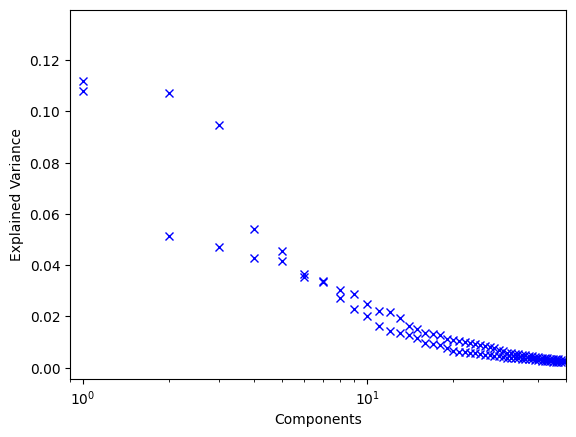

In [12]:
tcremb_pred = TCRemb.TCRemb_vdjdb(run_name, data_pred)
tcremb_pred.tcremb_clonotypes('TRA')
tcremb_pred.tcremb_clonotypes('TRB')
tcremb_pred.tcremb_dists_count('TRA')
tcremb_pred.tcremb_dists_count('TRB')
tcremb_pred.tcremb_dists('TRA')
tcremb_pred.tcremb_dists('TRB')
tcremb_pred.tcremb_pca('TRA')
tcremb_pred.tcremb_pca('TRB')
tcremb_pred.tcremb_tsne('TRA')
tcremb_pred.tcremb_tsne('TRB')

# TCRemb

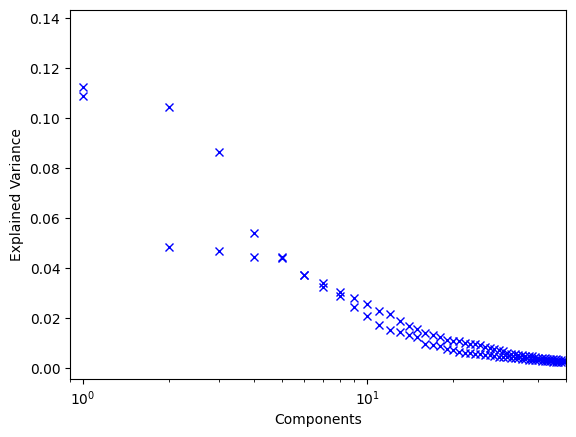

In [13]:
tcremb = TCRemb.TCRemb(run_name, data_tt)
tcremb.tcremb_clonotypes('TRA')
tcremb.tcremb_clonotypes('TRB')

##tcremb.tcremb_dists_count('TRA')
##tcremb.tcremb_dists_count('TRB')

tcremb.tcremb_dists('TRA')
tcremb.tcremb_dists('TRB')
tcremb.tcremb_pca('TRA')
tcremb.tcremb_pca('TRB')
tcremb.tcremb_tsne('TRA')
tcremb.tcremb_tsne('TRB')

# Analysis

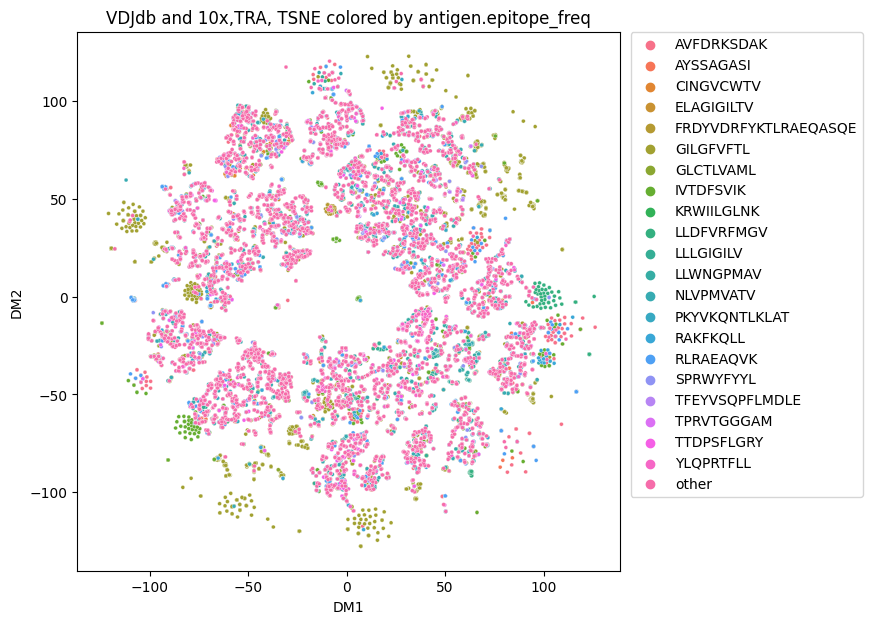

In [24]:
chain = 'TRA'
ml_utils.tsne_plot(pd.merge(tcremb.tsne[chain],tcremb.annot[chain]), label_high, f'VDJdb and 10x,{chain}, TSNE colored by {label_high}')

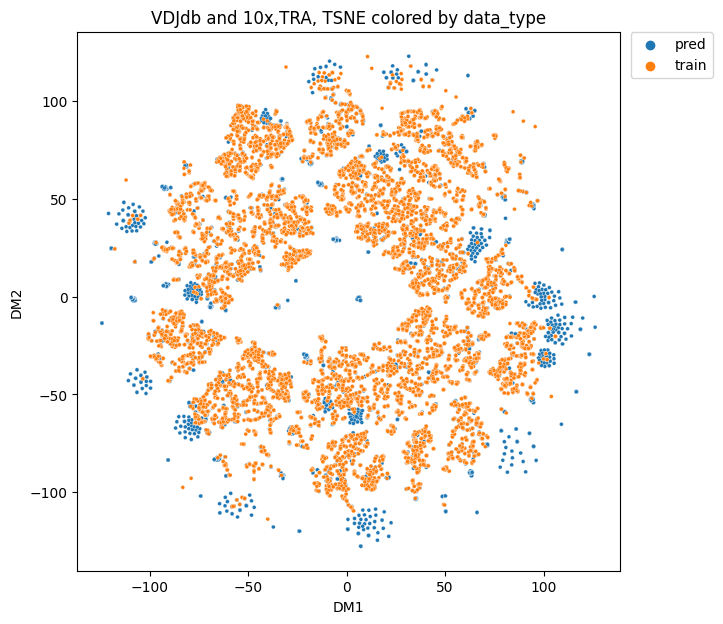

In [25]:
chain = 'TRA'
ml_utils.tsne_plot(pd.merge(tcremb.tsne[chain],tcremb.annot[chain]), 'data_type', f'VDJdb and 10x,{chain}, TSNE colored by data_type')

In [26]:
chain = 'TRB'
ml_utils.tsne_plot(pd.merge(tcremb.tsne[chain],tcremb.annot[chain]), label_high, f'VDJdb and 10x,{chain}, TSNE colored by {label_high}')

KeyError: 'TRB'

In [ ]:
chain = 'TRB'
ml_utils.tsne_plot(pd.merge(tcremb.tsne[chain],tcremb.annot[chain]), 'data_type', f'VDJdb and 10x,{chain}, TSNE colored by data_type')

In [ ]:
def tsne_plot(data_plot, to_color, title, to_size=None,suptitle=None,legend=True, custom_palette=None,ax=None,):
    if ax is None:
        fig, ax = plt.subplots(figsize=(7, 7))
    sns.scatterplot(x='DM1', y='DM2', data=data_plot.sort_values(to_color), hue=to_color,size=to_size, legend = legend,palette=custom_palette, ax=ax)
    ax.set_title(title)
    ax.legend(bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

## Clustering

### KMeans

In [10]:
kmeans = TCRemb.TCRemb_clustering_pred('KMeans')

In [34]:
chain='TRA'
#n_clusters = 5295
#random_state = 8
#model =  KMeans(n_clusters=n_clusters, random_state=random_state)
kmeans.clstr_pred(chain,tcremb_pred, label)

For n_clusters = 75 The average silhouette_score is : 0.12657995628983185
For n_clusters = 149 The average silhouette_score is : 0.12613934313673963
For n_clusters = 747 The average silhouette_score is : 0.15492106834670705
For n_clusters = 1494 The average silhouette_score is : 0.17802894953606888
For n_clusters = 2242 The average silhouette_score is : 0.19303615558904222
For n_clusters = 2989 The average silhouette_score is : 0.20895910832243209
For n_clusters = 3736 The average silhouette_score is : 0.2200169583286182
For n_clusters = 4483 The average silhouette_score is : 0.2267132472702496
For n_clusters = 5978 The average silhouette_score is : 0.2310787877158598
For n_clusters = 7472 The average silhouette_score is : 0.22769872288454363
For n_clusters = 8966 The average silhouette_score is : 0.21852037595426774
For n_clusters = 10461 The average silhouette_score is : 0.19770098101628555
For n_clusters = 11955 The average silhouette_score is : 0.16093848729341292
For n_clusters = 

In [35]:
chain ='TRA'
df = kmeans.clstr_labels[chain][(kmeans.clstr_labels[chain]['data_type']=='pred')].merge(tcremb_pred.annot[chain][['annotId','top_tetramer']])
print(f"correct prediction fraction:{len(df[df['top_tetramer']==df['label_cluster_train']])/len(kmeans.clstr_labels[chain][(kmeans.clstr_labels['TRA']['data_type']=='pred')])}")
print(f"count of pred dataset chain {chain} : {len(df)}")
print(f"count of 10x in clusters with VDJdb: {len(df[~df['fraction_matched_train'].isna()])}")
print(f"correct prediction:{len(df[df['top_tetramer']==df['label_cluster_train']])}")

correct prediction fraction:0.1715396315700524
count of pred dataset chain TRA : 11834
count of 10x in clusters with VDJdb: 10343
correct prediction:2030


In [39]:
kmeans.clstr_labels['TRA'][kmeans.clstr_labels['TRA']['cluster']==3290].merge(tcremb_pred.annot['TRA'])[tcr_columns + ['data_type','top_tetramer','label_cluster_train','fraction_matched_train']]

,cdr3aa,v,j,chain,data_type,top_tetramer,label_cluster_train,fraction_matched_train
0,CAGHNNNDMRF,TRAV35,TRAJ43,TRA,train,NaN,NLVPMVATV,1.0
1,CAGFLYNNNDMRF,TRAV35,TRAJ43,TRA,train,NaN,NLVPMVATV,1.0
2,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
3,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
4,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
5,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
6,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
7,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
8,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0
9,CAGLYNNNDMRF,TRAV35,TRAJ43,TRA,pred,IVTDFSVIK,NLVPMVATV,1.0


In [36]:
df[df['fraction_matched_train']>0.7]

,cluster,annotId,label_cluster,total_cluster,total_group,count_matched,fraction_matched,fraction_matched_exp,p_value,is_cluster,...,v,j,chain,label_cluster_train,fraction_matched_train,p_value_train,is_cluster_train,enriched_clstr_train,data_type,top_tetramer
5,2561,12041,no,23,11834,16,0.695652,0.495769,4.274472e-02,1,...,TRAV17,TRAJ11,TRA,LLLGIGILV,0.714286,4.460075e-07,1.0,1.0,pred,FLYALALLL
11,1491,12047,no,5,11834,4,0.800000,0.495769,1.822557e-01,1,...,TRAV26-2,TRAJ30,TRA,HPVTKYIM,1.000000,4.071120e-03,0.0,0.0,pred,IVTDFSVIK
12,4515,12048,no,2,11834,1,0.500000,0.495769,7.457508e-01,1,...,TRAV3,TRAJ24,TRA,SPLPSYAAF,1.000000,8.308408e-05,0.0,0.0,pred,IVTDFSVIK
17,513,12053,QYIKWPWYI,7,131,3,0.428571,0.005488,5.690659e-06,0,...,TRAV41,TRAJ34,TRA,QYIKWPWYI,0.750000,5.115259e-06,1.0,1.0,pred,AVFDRKSDAK
19,788,12055,no,68,11834,67,0.985294,0.495769,1.333755e-19,1,...,TRAV21,TRAJ39,TRA,SPRWYFYYL,1.000000,3.157195e-02,0.0,0.0,pred,AYSSAGASI
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11769,4865,23961,no,42,11834,41,0.976190,0.495769,6.956226e-12,0,...,TRAV8-1,TRAJ42,TRA,GILGFVFTL,1.000000,2.151047e-01,0.0,0.0,pred,GILGFVFTL
11789,3290,23981,no,19,11834,17,0.894737,0.495769,3.200640e-04,1,...,TRAV35,TRAJ43,TRA,NLVPMVATV,1.000000,3.893703e-02,1.0,1.0,pred,IVTDFSVIK
11791,1669,23983,NLVPMVATV,2,2375,1,0.500000,0.099497,1.890948e-01,1,...,TRAV35,TRAJ42,TRA,NLVPMVATV,1.000000,1.973247e-01,0.0,0.0,pred,RLRAEAQVK
11821,1802,24013,NLVPMVATV,2,2375,1,0.500000,0.099497,1.890948e-01,0,...,TRAV27,TRAJ53,TRA,NLVPMVATV,1.000000,1.973247e-01,0.0,0.0,pred,RPPIFIRRL


In [25]:
tcremb_pred.annot['TRA'][(tcremb_pred.annot['TRA']['data_type']=='pred')&(-tcremb_pred.annot['TRA']['vdjdb_cloneId'].isna())]

,cdr3aa,v,j,chain,antigen.epitope,antigen.species,mhc.a,mhc.b,mhc.class,vdjdb_cloneId,vdjdb_data_id,cloneId,data_type,top_tetramer,raw_clonotype_id,barcode,data_id,inputId,clone_size,annotId
12036,CAVTDSWGKLQF,TRAV21,TRAJ24,TRA,no,NaN,NaN,NaN,NaN,29385.0,NaN,29385.0,pred,AVFDRKSDAK,clonotype18308,GCAAACTAGAAGCCCA-26,31441.0,9.0,1.0,12036
12041,CATEGNSGYSTLTF,TRAV17,TRAJ11,TRA,no,NaN,NaN,NaN,NaN,25523.0,NaN,25523.0,pred,FLYALALLL,clonotype271,GGTGCGTAGACCGGAT-22,37517.0,138.0,12.0,12041
12046,CAVGDNFNKFYF,TRAV8-3,TRAJ21,TRA,no,NaN,NaN,NaN,NaN,27108.0,NaN,27108.0,pred,AVFDRKSDAK,clonotype2,TGAGGGATCCGAACGC-4,48137.0,175.0,1593.0,12046
12050,CAVGDNFNKFYF,TRAV8-3,TRAJ21,TRA,no,NaN,NaN,NaN,NaN,27108.0,NaN,27108.0,pred,AVFDRKSDAK,clonotype2,CGGCTAGGTTAAGAAC-9,22029.0,269.0,1593.0,12050
12060,CAVGDNFNKFYF,TRAV8-3,TRAJ21,TRA,no,NaN,NaN,NaN,NaN,27108.0,NaN,27108.0,pred,AVFDRKSDAK,clonotype2,CACCTTGCAGGACCCT-5,13895.0,350.0,1593.0,12060
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23671,CAVGDNFNKFYF,TRAV8-3,TRAJ21,TRA,no,NaN,NaN,NaN,NaN,27108.0,NaN,27108.0,pred,AVFDRKSDAK,clonotype239,TGCGGGTGTCTCAACA-28,48909.0,25464.0,1593.0,23826
23732,CAGKNYGGSQGNLIF,TRAV35,TRAJ42,TRA,no,NaN,NaN,NaN,NaN,2754.0,NaN,2754.0,pred,FLASKIGRLV,clonotype15903,CTGCTGTCAAAGTGCG-36,26799.0,25527.0,1.0,23887
23753,CAVTDGGSQGNLIF,TRAV8-6,TRAJ42,TRA,no,NaN,NaN,NaN,NaN,29373.0,NaN,29373.0,pred,GILGFVFTL,clonotype20,GCACATACAGGAACGT-35,31759.0,25551.0,115.0,23909
23760,CAVGDNFNKFYF,TRAV8-3,TRAJ21,TRA,no,NaN,NaN,NaN,NaN,27108.0,NaN,27108.0,pred,AVFDRKSDAK,clonotype12,AACTCTTTCTAGCACA-4,1498.0,25559.0,1593.0,23916


In [15]:
ml_utils.clsf_metrics(df[label], df['label_cluster'])

{'f1': 0.9194693256717932,
 'precision': 0.9194693256717932,
 'recall': 0.9194693256717932}

In [16]:
chain='TRB'
n_clusters = 11000
random_state = 8
model =  KMeans(n_clusters=n_clusters, random_state=random_state)
kmeans.clstr_pred(chain,tcremb_pred, label, model)

purity:0.6517359237272891
train purity:0.5494828635165281


In [17]:

df = kmeans.clstr_labels[chain][(kmeans.clstr_labels[chain]['data_type']=='pred')].merge(tcremb_pred.annot[chain][['annotId',label]])
print(f"correct prediction fraction:{len(df[df[label]==df['label_cluster']])/len(kmeans.clstr_labels[chain][(kmeans.clstr_labels['TRA']['data_type']=='pred')])}")
print(f"count of pred dataset chain {chain} : {len(df)}")
print(f"count of 10x in clusters with VDJdb: {len(df[~df['fraction_matched_train'].isna()])}")
print(f"correct prediction:{len(df[df[label]==df['label_cluster']])}")

IndexingError: Unalignable boolean Series provided as indexer (index of the boolean Series and of the indexed object do not match).

In [ ]:
ml_utils.clsf_metrics(df[label], df['label_cluster'])

In [9]:
kmeans = TCRemb.TCRemb_clustering_pred('KMeans')

In [10]:
chain='TRA'
n_clusters = 5295
random_state = 8
model =  KMeans(n_clusters=n_clusters, random_state=random_state)
kmeans.clstr_pred(chain,tcremb, label, model)

purity:0.644480085538626
train purity:0.5536941996707659


In [12]:
kmeans.clstr_labels['TRA'].columns

Index(['cluster', 'annotId', 'label_cluster', 'total_cluster', 'total_group',
       'count_matched', 'fraction_matched', 'fraction_matched_exp', 'p_value',
       'is_cluster', 'enriched_clstr', 'cdr3aa', 'v', 'j', 'chain',
       'label_cluster_train', 'fraction_matched_train', 'p_value_train',
       'is_cluster_train', 'enriched_clstr_train', 'data_type'],
      dtype='object')

In [18]:
kmeans.clstr_labels['TRA'][(kmeans.clstr_labels['TRA']['data_type']=='pred')&(kmeans.clstr_labels['TRA']['fraction_matched_train'].isna())]

,cluster,annotId,label_cluster,total_cluster,total_group,count_matched,fraction_matched,fraction_matched_exp,p_value,is_cluster,...,cdr3aa,v,j,chain,label_cluster_train,fraction_matched_train,p_value_train,is_cluster_train,enriched_clstr_train,data_type
12058,1326,12069,RAKFKQLL,1,357,1,1.000000,0.014956,1.495601e-02,0,...,CAVRGNNAGNMLTF,TRAV21,TRAJ39,TRA,NaN,NaN,NaN,NaN,NaN,pred
12062,4707,12073,RLRAEAQVK,5,633,1,0.200000,0.026519,1.257449e-01,1,...,CAMREGIGNAGNMLTF,TRAV14DV4,TRAJ39,TRA,NaN,NaN,NaN,NaN,NaN,pred
12069,676,12080,GILGFVFTL,18,5033,18,1.000000,0.210850,6.784865e-13,1,...,CAARPSF,TRAV21,TRAJ7,TRA,NaN,NaN,NaN,NaN,NaN,pred
12076,1039,12087,AVFDRKSDAK,4,3496,3,0.750000,0.146460,1.118620e-02,1,...,CAMRGSGYSTLTF,TRAV14DV4,TRAJ11,TRA,NaN,NaN,NaN,NaN,NaN,pred
12077,1039,12088,AVFDRKSDAK,4,3496,3,0.750000,0.146460,1.118620e-02,1,...,CAMRGSGYSTLTF,TRAV14DV4,TRAJ11,TRA,NaN,NaN,NaN,NaN,NaN,pred
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23780,3772,23947,AVFDRKSDAK,1,3496,1,1.000000,0.146460,1.464600e-01,0,...,CAVTPGLGDYGQNFVF,TRAV8-4,TRAJ26,TRA,NaN,NaN,NaN,NaN,NaN,pred
23804,65,23971,GILGFVFTL,81,5033,79,0.975309,0.210850,7.975370e-51,1,...,CAADNYGGSQGNLIF,TRAV23DV6,TRAJ42,TRA,NaN,NaN,NaN,NaN,NaN,pred
23805,244,23972,GILGFVFTL,17,5033,17,1.000000,0.210850,3.217857e-12,1,...,CAVNEGGGSQGNLIF,TRAV8-1,TRAJ42,TRA,NaN,NaN,NaN,NaN,NaN,pred
23823,3951,23990,AVFDRKSDAK,1,3496,1,1.000000,0.146460,1.464600e-01,0,...,CVRGGTYKYIF,TRAV1-2,TRAJ40,TRA,NaN,NaN,NaN,NaN,NaN,pred


11834

In [31]:
chain ='TRA'
df = kmeans.clstr_labels[chain][(kmeans.clstr_labels[chain]['data_type']=='pred')].merge(tcremb.annot[chain][['annotId',label]])
print(f"correct prediction fraction:{len(df[df[label]==df['label_cluster']])/len(kmeans.clstr_labels[chain][(kmeans.clstr_labels['TRA']['data_type']=='pred')])}")
print(f"count of pred dataset chain {chain} : {len(df)}")
print(f"count of 10x in clusters with VDJdb: {len(df[~df['fraction_matched_train'].isna()])}")
print(f"correct prediction:{len(df[df[label]==df['label_cluster']])}")

correct prediction:9289
correct prediction fraction:0.7849416934257225
count of pred dataset chain TRA : 11834
count of 10x in clusters with VDJdb: 10242


In [27]:
ml_utils.clsf_metrics(df[label], df['label_cluster'])

{'f1': 0.7849416934257225,
 'precision': 0.7849416934257225,
 'recall': 0.7849416934257225}

## Classification

### Fraction of barcodes with clonotypes present in VDJdb

In [ ]:
vdjdb_clones_fraction = {}
chain = 'TRA'
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())
t_test = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test']
t = t_test[t_test[clonotype_id_column].isin(train_clonotypes_ids)]
vdjdb_clones_fraction[chain] = len(t)/len(t_test)

chain = 'TRB'
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())
t_test = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test']
t = t_test[t_test[clonotype_id_column].isin(train_clonotypes_ids)]
vdjdb_clones_fraction[chain] = len(t)/len(t_test)


fig, ax = plt.subplots()
ax.bar(list(vdjdb_clones_fraction.keys()),list(vdjdb_clones_fraction.values()))
ax.set_xlim([0, 1])
ax.set_ylabel('fraction')
ax.set_title(f'Fraction of barcodes with clonotypes present in VDJdb, 10x {donor}')

In [141]:
from sklearn.preprocessing import label_binarize

In [142]:
chain = 'TRA'
max_depth = 20
label_cl = label_high

y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')
model = RandomForestClassifier(max_depth=max_depth, random_state=0)
y_train, y_test,X_train, X_test,  = train_test_split(y_data, X_data.drop(annotation_id, axis=1, errors = 'ignore') ,test_size=0.3)
model.fit(X_train, y_train)
pred = model.predict(X_test)
pred_proba = model.predict_proba(X_test)

classes_list = list(model.classes_)
    
y_test_curv = label_binarize(y_test, classes=classes_list)
y_pred_curv = label_binarize(pred, classes=classes_list)

In [143]:
roc_auc_proba = TCRemb_code2.roc_auc_count(y_test_curv,pred_proba)
roc_auc = TCRemb_code2.roc_auc_count(y_test_curv,y_pred_curv)

In [160]:
roc_auc_proba

{0: 0.7515024967961466,
 1: 0.803781729927588,
 2: 0.8930837269611929,
 3: 0.9885339442799405,
 4: 0.7405583611601633,
 5: 0.8336198428290766,
 6: 0.8341966756907999,
 7: 0.9347352148406533,
 8: 0.5790835181079083,
 9: 0.6755159308851474,
 10: 0.719459270790862,
 11: 0.8480685594968926,
 12: 0.7154721955896453,
 13: 0.6850462055446653,
 14: 0.6444705730472181,
 15: 0.6342673333739863,
 16: 0.7116650687120486,
 17: 0.6963646532438479,
 18: 0.721210822881774,
 19: 0.8880002145692523,
 20: 0.9230502359145156,
 21: 0.7312787661830807,
 22: 0.7532183097963299,
 23: 0.6478271310762574}

In [161]:
roc_auc

{0: 0.6049832810405527,
 1: 0.6229470040582478,
 2: 0.49944429008057795,
 3: 0.8644011930749779,
 4: 0.6606728958423874,
 5: 0.6126186967910937,
 6: 0.5537742555090065,
 7: 0.5,
 8: 0.5,
 9: 0.5,
 10: 0.6205953395851094,
 11: 0.6869494174481388,
 12: 0.5422978587408117,
 13: 0.5490198823858863,
 14: 0.5668196218634683,
 15: 0.49859747545582045,
 16: 0.5418783956535634,
 17: 0.5142857142857142,
 18: 0.530390018436291,
 19: 0.748884239888424,
 20: 0.6248612267554815,
 21: 0.5215877587274245,
 22: 0.6922577681032714,
 23: 0.5943684624884104}

In [153]:
y_test

2653     GLIYNRMGAVTTEV
10949        TPRVTGGGAM
2869              other
8169          NLVPMVATV
5099          NLVPMVATV
              ...      
331           GILGFVFTL
8219              other
3299          YLQPRTFLL
746               other
10770         GILGFVFTL
Name: antigen.epitope_high_count, Length: 3611, dtype: object

In [169]:
y_test_curv[5]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1])

In [170]:
y_pred_curv[5]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 1])

In [171]:
pred_proba[5]

array([2.03827913e-02, 0.00000000e+00, 3.00000000e-02, 0.00000000e+00,
       2.59028498e-01, 3.01219512e-02, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 1.02777778e-02, 5.06436314e-02, 1.21951220e-04,
       1.00000000e-02, 0.00000000e+00, 8.33082016e-02, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 2.08362369e-02, 0.00000000e+00,
       0.00000000e+00, 1.00000000e-02, 1.12249583e-01, 3.63029377e-01])

### RF

In [13]:
clf = TCRemb.TCRemb_clf_pred('RF')
chain='TRA'
#max_depth = 20
#model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clf.clf(chain,tcremb_pred, label_high_100,test_size=0.15)
clf.clf_pred(chain, tcremb_pred, 'top_tetramer_freq_100')

Train accuracy: 0.9735092864125122
Test accuracy: 0.3864894795127353
macro: {'f1': 0.21328286817428577, 'precision': 0.18360091280316562, 'recall': 0.323049880159861}
weighted: {'f1': 0.4094625403302508, 'precision': 0.4577491686615267, 'recall': 0.3864894795127353}
Prediction accuracy: 0.537181003887105
macro: {'f1': 0.21328286817428577, 'precision': 0.18360091280316562, 'recall': 0.323049880159861}
weighted: {'f1': 0.4094625403302508, 'precision': 0.4577491686615267, 'recall': 0.3864894795127353}


In [14]:
chain='TRB'
#max_depth = 20
#model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clf.clf(chain,tcremb_pred, label_high_100,test_size=0.15)
clf.clf_pred(chain, tcremb_pred, 'top_tetramer_freq_100')

Train accuracy: 0.980982103671917
Test accuracy: 0.3806629834254144
macro: {'f1': 0.19201712323763628, 'precision': 0.14775952438302584, 'recall': 0.4704170257852048}
weighted: {'f1': 0.4167622121117566, 'precision': 0.5525789256957641, 'recall': 0.3806629834254144}
Prediction accuracy: 0.774835405998537
macro: {'f1': 0.19201712323763628, 'precision': 0.14775952438302584, 'recall': 0.4704170257852048}
weighted: {'f1': 0.4167622121117566, 'precision': 0.5525789256957641, 'recall': 0.3806629834254144}


In [15]:
custom_palette = ml_utils.make_custom_palette(freq_list)

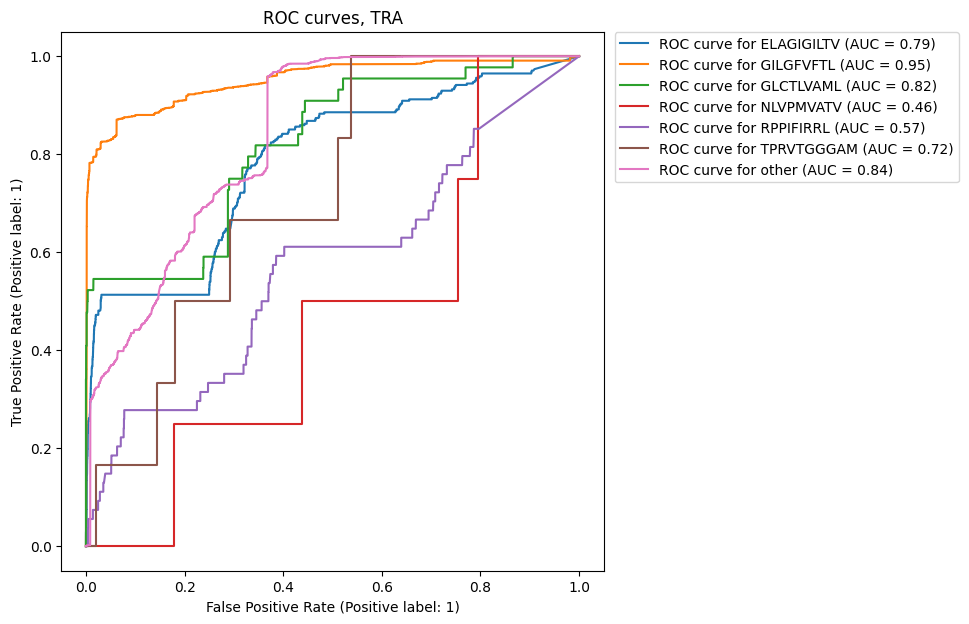

In [16]:
clf.roc_auc_pred('TRA')

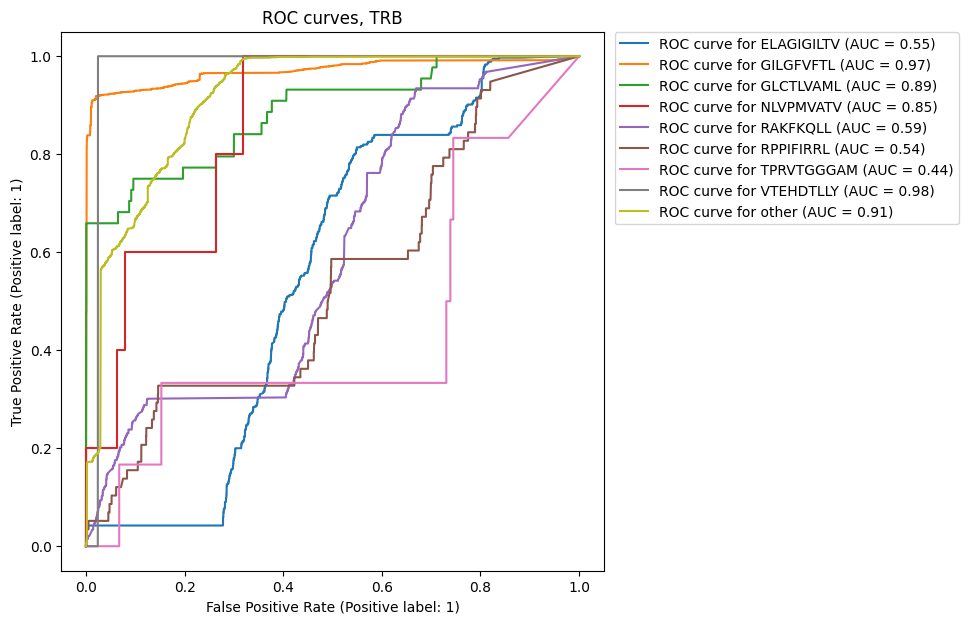

In [17]:
clf.roc_auc_pred('TRB')

In [42]:
clf = TCRemb.TCRemb_clf_pred('RF')
chain='TRA'
#max_depth = 20
#model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clf.clf(chain,tcremb, label,test_size=0.15)
clf.clf_pred(chain, tcremb, label)

Train accuracy: 0.9571847507331378
Test accuracy: 0.33942414174972313
macro: {'f1': 0.04715034677594741, 'precision': 0.04157149371312039, 'recall': 0.06791156939354843}
weighted: {'f1': 0.3933620365010918, 'precision': 0.5443994218591621, 'recall': 0.33942414174972313}
Prediction accuracy: 0.1863076923076923
macro: {'f1': 0.04715034677594741, 'precision': 0.04157149371312039, 'recall': 0.06791156939354843}
weighted: {'f1': 0.3933620365010918, 'precision': 0.5443994218591621, 'recall': 0.33942414174972313}


In [43]:
chain='TRB'
#max_depth = 20
#model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clf.clf(chain,tcremb, label,test_size=0.15)
clf.clf_pred(chain, tcremb, label)

Train accuracy: 0.9486516799141756
Test accuracy: 0.32900552486187845
macro: {'f1': 0.06711336345038017, 'precision': 0.0573396419517707, 'recall': 0.11450344301975644}
weighted: {'f1': 0.39265571212110195, 'precision': 0.7661128574508332, 'recall': 0.32900552486187845}
Prediction accuracy: 0.17522344626896694
macro: {'f1': 0.06711336345038017, 'precision': 0.0573396419517707, 'recall': 0.11450344301975644}
weighted: {'f1': 0.39265571212110195, 'precision': 0.7661128574508332, 'recall': 0.32900552486187845}


In [44]:
label_lc = str(label_train + '_high_count_1000')
model_name = 'RF_' + label_lc
clf_1000 = TCRemb.TCRemb_clf_pred(model_name)
chain='TRA'
#max_depth = 20
#model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clf_1000.clf(chain,tcremb, label_lc,test_size=0.15)
clf_1000.clf_pred(chain, tcremb, label_lc)

Train accuracy: 0.9782991202346041
Test accuracy: 0.5941306755260244
macro: {'f1': 0.38415992021029893, 'precision': 0.3418239548083049, 'recall': 0.5636800547213047}
weighted: {'f1': 0.6580339681239219, 'precision': 0.8137378361336853, 'recall': 0.5941306755260244}
Prediction accuracy: 0.8806153846153846
macro: {'f1': 0.38415992021029893, 'precision': 0.3418239548083049, 'recall': 0.5636800547213047}
weighted: {'f1': 0.6580339681239219, 'precision': 0.8137378361336853, 'recall': 0.5941306755260244}


In [45]:
chain='TRB'
#max_depth = 20
#model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clf_1000.clf(chain,tcremb, label_lc,test_size=0.15)
clf_1000.clf_pred(chain, tcremb, label_lc)

Train accuracy: 0.9230019017896328
Test accuracy: 0.6453038674033149
macro: {'f1': 0.40999144284580913, 'precision': 0.3689136455604882, 'recall': 0.6393982701508351}
weighted: {'f1': 0.7265340161894485, 'precision': 0.8953288400677616, 'recall': 0.6453038674033149}
Prediction accuracy: 0.9341093327790481
macro: {'f1': 0.40999144284580913, 'precision': 0.3689136455604882, 'recall': 0.6393982701508351}
weighted: {'f1': 0.7265340161894485, 'precision': 0.8953288400677616, 'recall': 0.6453038674033149}


In [47]:
data_test_preped[str(label_train+'_high_count_1000')]

0            other
1            other
2            other
4            other
5            other
           ...    
33982        other
33983    GILGFVFTL
33985    GILGFVFTL
33986        other
33987        other
Name: antigen.epitope_high_count_1000, Length: 29531, dtype: object

In [16]:
data_pred

,cdr3aa,v,j,chain,top_tetramer,top_tetramer_freq,raw_clonotype_id,barcode,data_id
0,CASSPLAGVSDTQYF,TRBV7-6,TRBJ2-3,TRB,AVFDRKSDAK,AVFDRKSDAK,clonotype15376,CTCTAATAGACTGTAA-23,25812
1,CASSPRDRERGEQYF,TRBV7-2,TRBJ2-7,TRB,AVFDRKSDAK,AVFDRKSDAK,clonotype4,CTAGTGACACGTAAGG-1,24499
2,CASSQGAGIGRTDTQYF,TRBV4-1,TRBJ2-3,TRB,AVFDRKSDAK,AVFDRKSDAK,clonotype108,TCAGGATCAATGAAAC-2,44988
3,CASSLFGGTYEQYF,TRBV27,TRBJ2-7,TRB,IVTDFSVIK,IVTDFSVIK,clonotype18,GTATTCTTCCTTTCTC-8,38742
4,CASSQGAGIGRTDTQYF,TRBV4-1,TRBJ2-3,TRB,AVFDRKSDAK,AVFDRKSDAK,clonotype108,TCTATTGCACAGACTT-11,46508
...,...,...,...,...,...,...,...,...,...
25668,CAGHTGNQFYF,TRAV35,TRAJ49,TRA,IVTDFSVIK,IVTDFSVIK,clonotype1,ACTGAACCAACGATGG-26,5307
25669,CAGHTGNQFYF,TRAV35,TRAJ49,TRA,AVFDRKSDAK,AVFDRKSDAK,clonotype12904,CGCTTCATCCTTGACC-24,21378
25670,CAMREGVSGGGADGLTF,TRAV14DV4,TRAJ45,TRA,FLRGRAYGL,other,clonotype24064,TACCTATCACGACGAA-40,42114
25671,CAGHTGNQFYF,TRAV35,TRAJ49,TRA,IVTDFSVIK,IVTDFSVIK,clonotype46,TCGAGGCGTCTCTTTA-30,45709


Text(0.5, 1.0, 'TCR counts for each epitope in pred (10x donor1)')

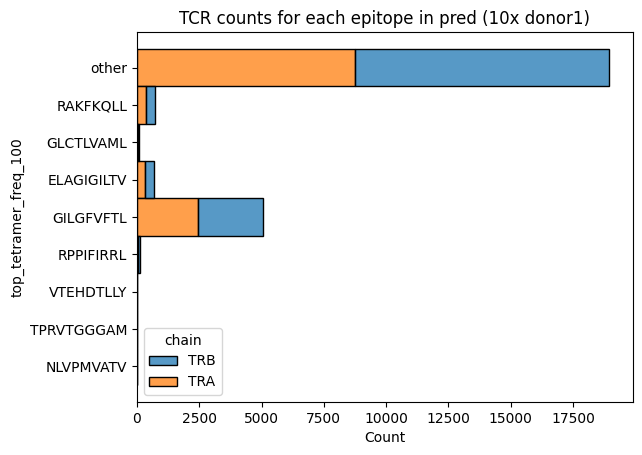

In [18]:
sns.histplot(data = data_pred, y = 'top_tetramer_freq_100',hue='chain',multiple='stack').set_title('TCR counts for each epitope in pred (10x donor1)')



## fig

In [1]:

#custom_palette = ml_utils.make_custom_palette(str(label_train+'_high_count_1000'))

fig = plt.figure(figsize=(20,13))

delta_x=-0.01
delta_y=1.1
font_size=20


gs00 = fig.add_gridspec(2, 6)

ax1 = fig.add_subplot(gs00[0, :2])
ax2 = fig.add_subplot(gs00[1, :2])
ax3 = fig.add_subplot(gs00[0, 3:5])
ax4 = fig.add_subplot(gs00[1, 3:5])


sns.histplot(data = data_preped, y = label_high,hue='chain',multiple='stack', ax=ax1)

ax1.text(delta_x, delta_y , 'A',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax1.transAxes,
        size=font_size)
ax1.set_title('tcr counts for each epitope in train (VDJdb)')


sns.histplot(data = data_test_preped, y = label_high,hue='chain',multiple='stack', ax=ax2)

ax2.text(delta_x, delta_y , 'B',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax2.transAxes,
        size=font_size)
ax2.set_title('tcr counts for each epitope in pred (10x donor1)')


clf_1000.roc_auc_pred('TRA',ax=ax3)

ax3.text(delta_x, delta_y, 'C',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax3.transAxes,
        size=font_size)


clf_1000.roc_auc_pred('TRB',ax=ax4)

ax4.text(delta_x, delta_y, 'D',
     horizontalalignment='left',
     verticalalignment='top',
    transform=ax4.transAxes,
        size=font_size)


#plt.figtext(0.1, 0.001, 'Your-plot-metadata', ha='center', va='center')
#plt.savefig(str(outputs_path + "fig4.svg"))
#plt.savefig(str(outputs_path + "fig4.pdf"))
#plt.savefig(str(outputs_path + "fig4.png"))
plt.show()





NameError: name 'ml_utils' is not defined

## other class

In [220]:
clsf_dict = {}

In [134]:
model_name = 'RF_label_high'
label_cl = label_high
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9808902077151336
Test accuracy: 0.39795070617557465
good prediction: 24 classes with roc auc >= 0.6
failed: 0 classes with roc auc < 0.6
macro: {'f1': 0.07945092088010737, 'precision': 0.08560641363878495, 'recall': 0.12610762122966415}
weighted: {'f1': 0.5213347596585437, 'precision': 0.5091950824782387, 'recall': 0.5982992216777169}
good prediction: 5 classes with roc auc >= 0.6
failed: 19 classes with roc auc < 0.6


,class,roc_auc
2,ELAGIGILTV,0.505938
4,GILGFVFTL,0.837707
5,GLCTLVAML,0.734909
14,NLVPMVATV,0.548490
20,TPRVTGGGAM,0.499964
23,other,0.696910


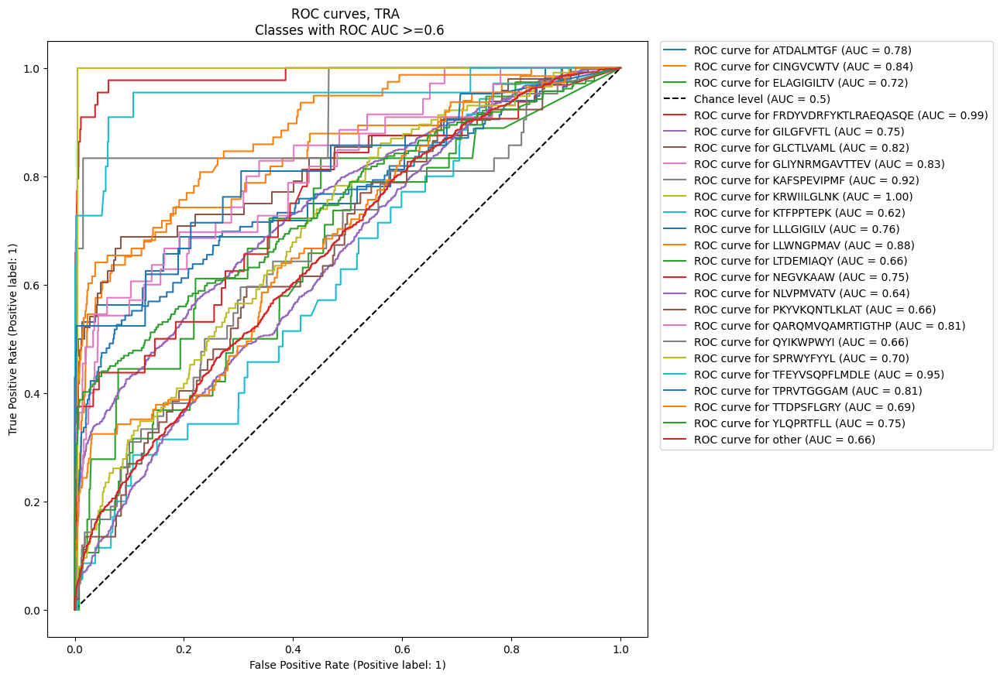

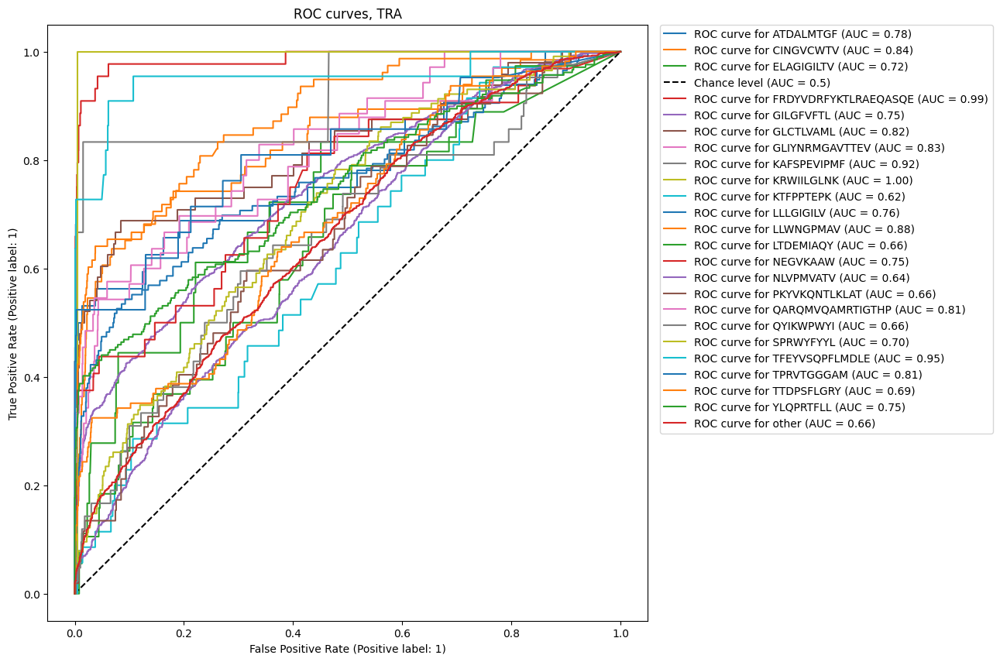

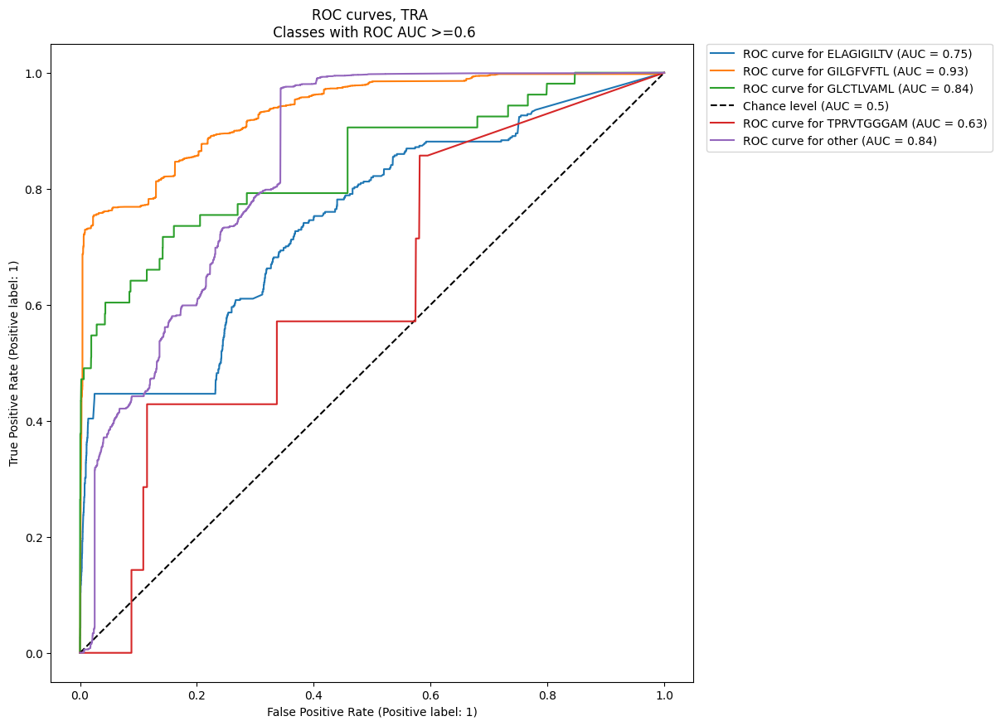

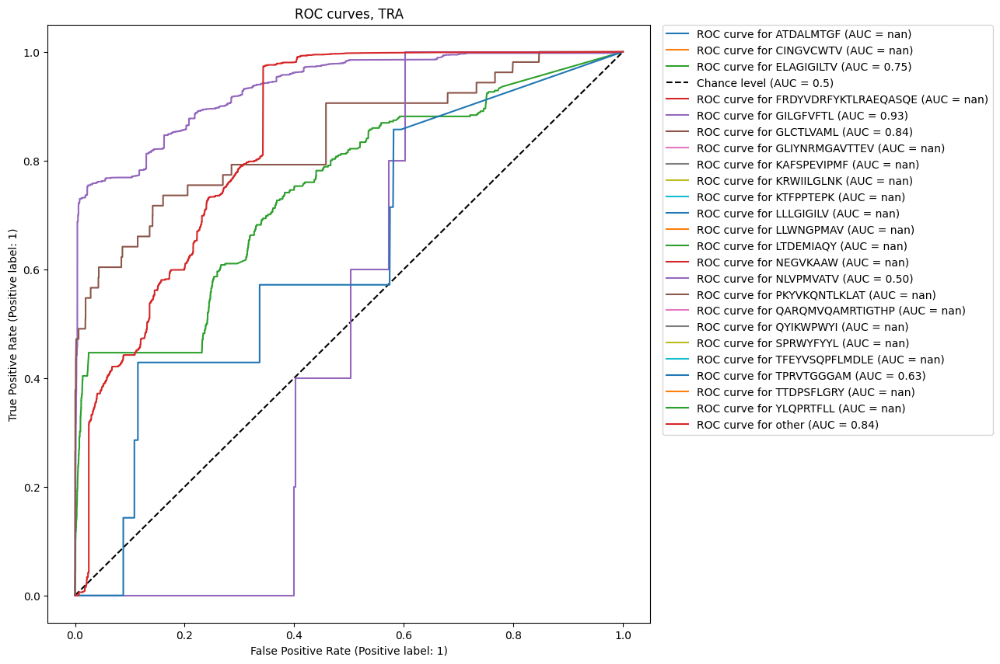

In [138]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
t = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)
t[-t['roc_auc'].isna()]


In [136]:
clsf_dict[model_name]['roc_auc'][chain].head(20)

,class,roc_auc
3,FRDYVDRFYKTLRAEQASQE,0.831227
22,YLQPRTFLL,0.740510
19,TFEYVSQPFLMDLE,0.721383
11,LLWNGPMAV,0.698795
4,GILGFVFTL,0.684303
10,LLLGIGILV,0.644789
7,KAFSPEVIPMF,0.624861
23,other,0.605852
5,GLCTLVAML,0.604926
1,CINGVCWTV,0.590956


Train accuracy: 0.97797252486973
Test accuracy: 0.43030805359856333
good prediction: 26 classes with roc auc >= 0.6
failed: 0 classes with roc auc < 0.6
macro: {'f1': 0.16212128983611043, 'precision': 0.19863240377739294, 'recall': 0.2055527227953048}
weighted: {'f1': 0.8893937269232635, 'precision': 0.9011865001494793, 'recall': 0.8968767674228618}
good prediction: 7 classes with roc auc >= 0.6
failed: 19 classes with roc auc < 0.6


,class,roc_auc
2,ELAGIGILTV,0.511097
4,GILGFVFTL,0.928606
5,GLCTLVAML,0.822363
15,NLVPMVATV,0.731078
21,TPRVTGGGAM,0.499969
23,VTEHDTLLY,0.500000
25,other,0.870358


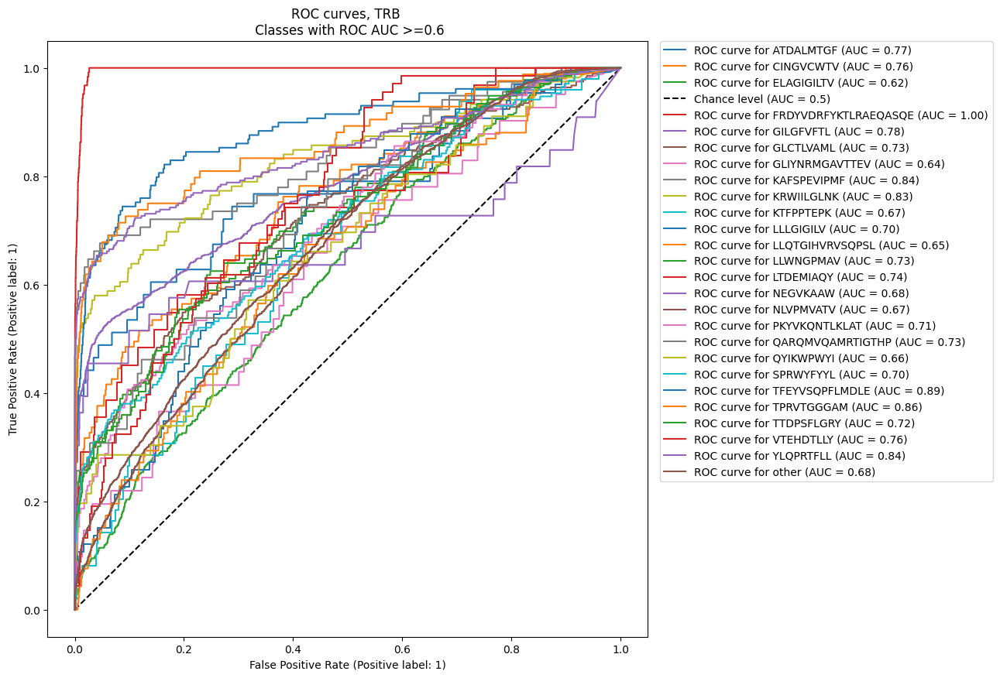

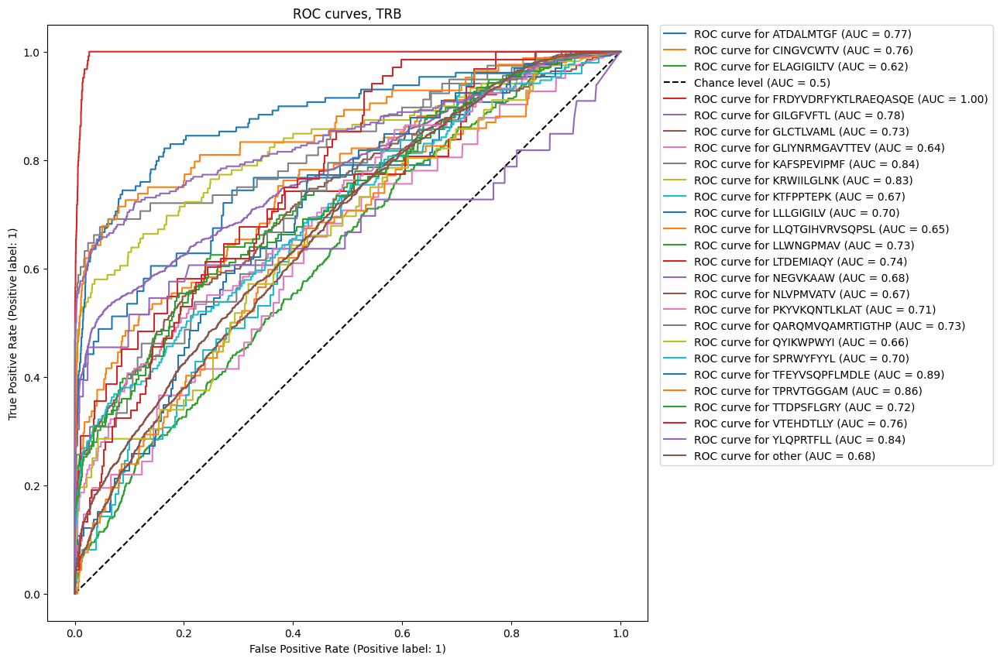

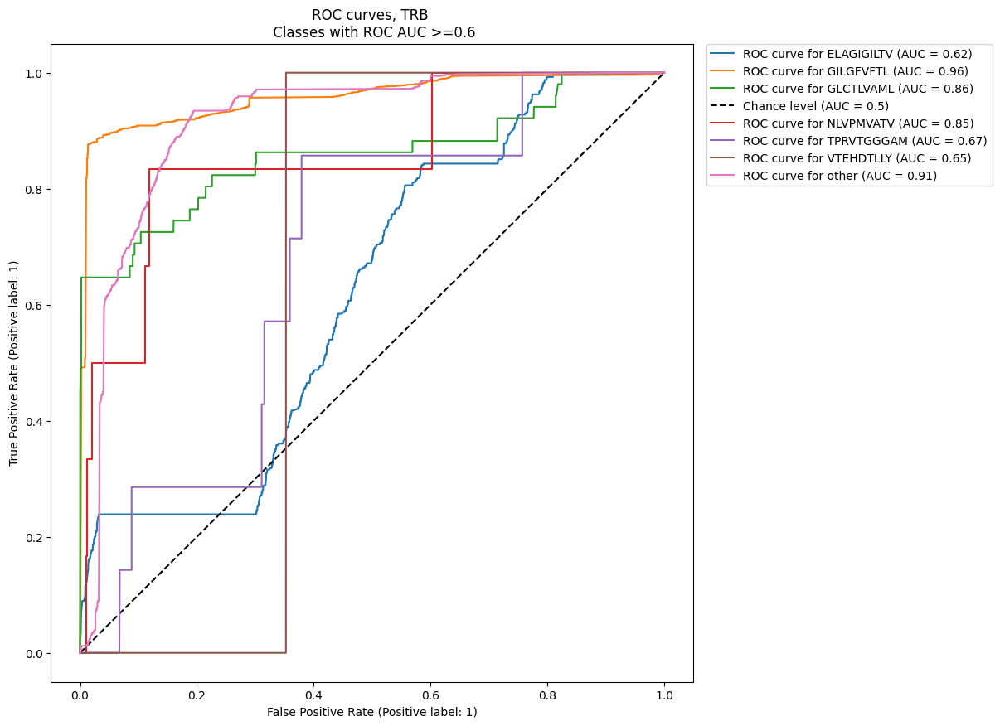

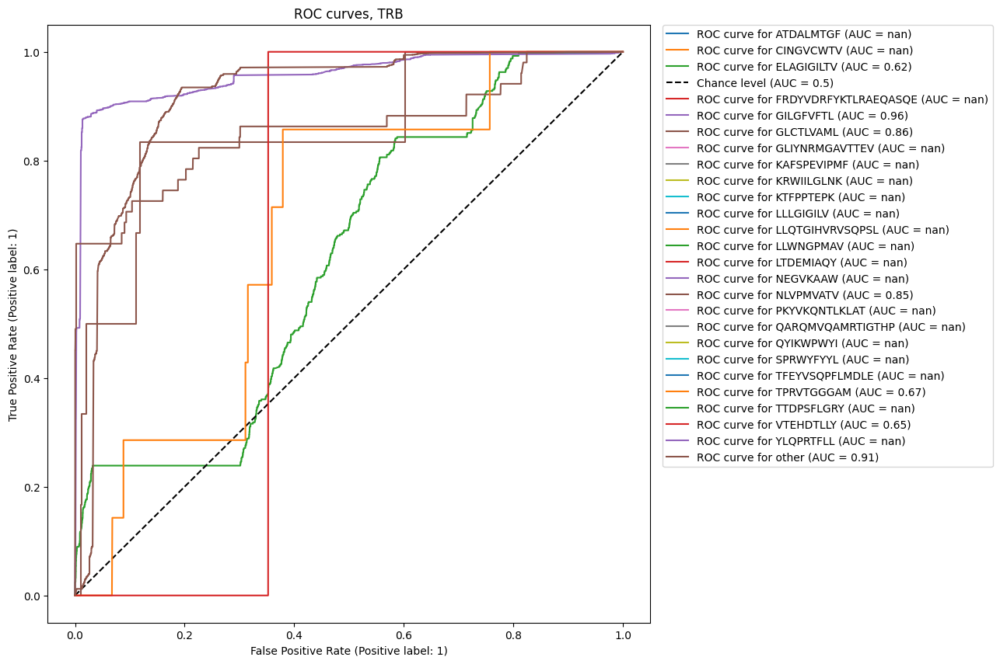

In [137]:
chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
t = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)
t[-t['roc_auc'].isna()]


In [89]:
model_name = 'RF'
label_cl = label
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

In [ ]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain,show_legend=False)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain,show_legend=False)


In [ ]:
chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain,show_legend=False)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain,show_legend=False)


### SVM

In [115]:
model_name = 'SVM_label_high'
label_cl = label_high
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

In [116]:
from sklearn.svm import SVC

Train accuracy: 0.48059347181008905
Test accuracy: 0.38327333148712267
good prediction: 20 classes with roc auc >= 0.6
failed: 4 classes with roc auc < 0.6
macro: {'f1': 0.10498266547967655, 'precision': 0.1100312748090013, 'recall': 0.10342163070762643}
weighted: {'f1': 0.7327234265297, 'precision': 0.705213035450387, 'recall': 0.7701787258575958}
good prediction: 4 classes with roc auc >= 0.6
failed: 20 classes with roc auc < 0.6


,class,roc_auc
2,ELAGIGILTV,0.500000
4,GILGFVFTL,0.858108
5,GLCTLVAML,0.686075
14,NLVPMVATV,0.457970
20,TPRVTGGGAM,0.500000
23,other,0.820466


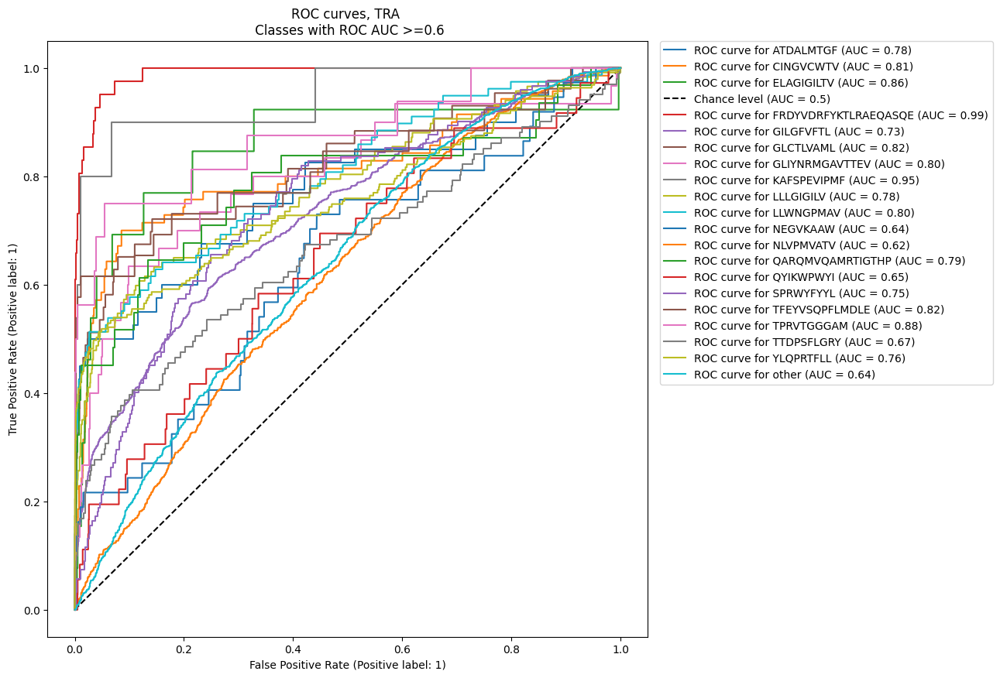

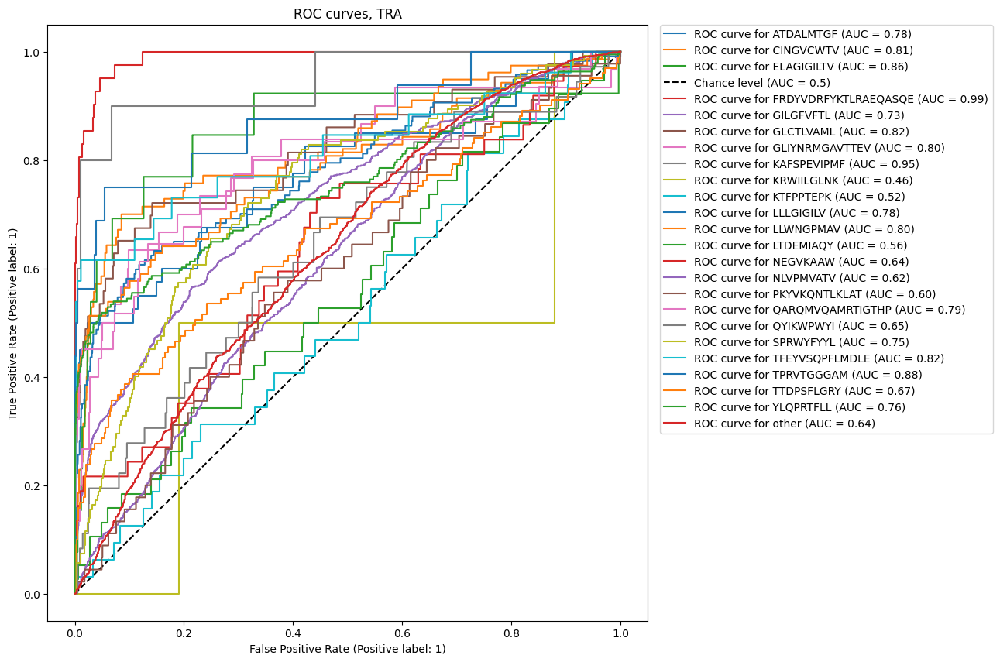

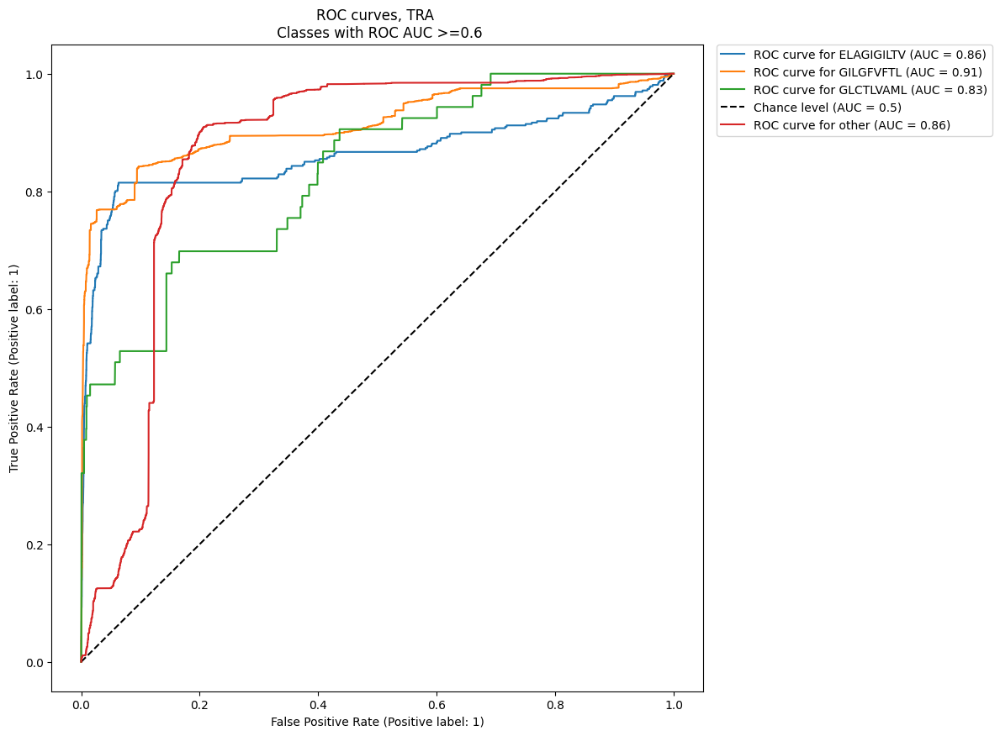

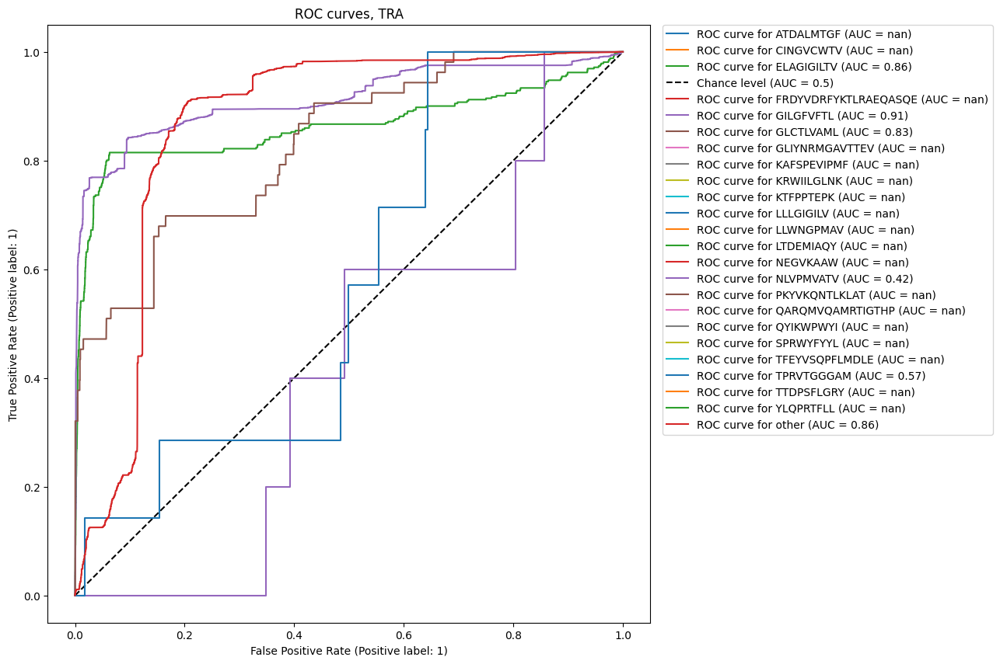

In [125]:
chain = 'TRA'
c = 6


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = SVC(C=c, random_state=0,probability=True, kernel='poly')
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
t = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)
t[-t['roc_auc'].isna()]


Train accuracy: 0.44404310753197535
Test accuracy: 0.428650366072662
good prediction: 24 classes with roc auc >= 0.6
failed: 2 classes with roc auc < 0.6
macro: {'f1': 0.2047249319551181, 'precision': 0.22567449550889035, 'recall': 0.21751588707912942}
weighted: {'f1': 0.879128771149172, 'precision': 0.8834292079408776, 'recall': 0.8865707283353234}
good prediction: 6 classes with roc auc >= 0.6
failed: 20 classes with roc auc < 0.6


,class,roc_auc
2,ELAGIGILTV,0.500000
4,GILGFVFTL,0.923578
5,GLCTLVAML,0.676029
15,NLVPMVATV,0.648876
21,TPRVTGGGAM,0.499843
23,VTEHDTLLY,0.500000
25,other,0.856779


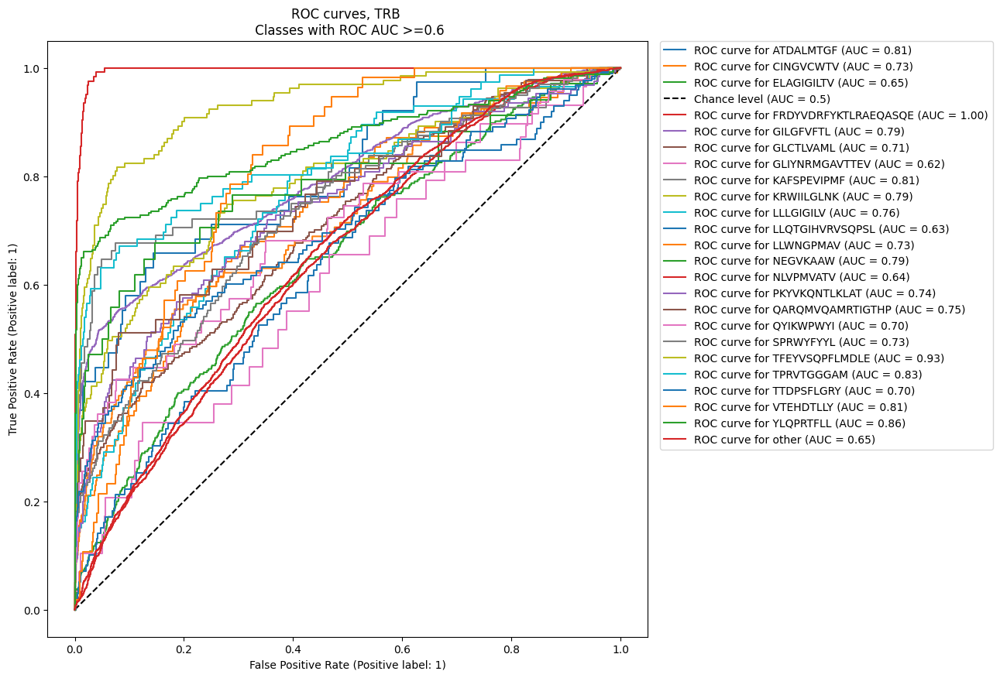

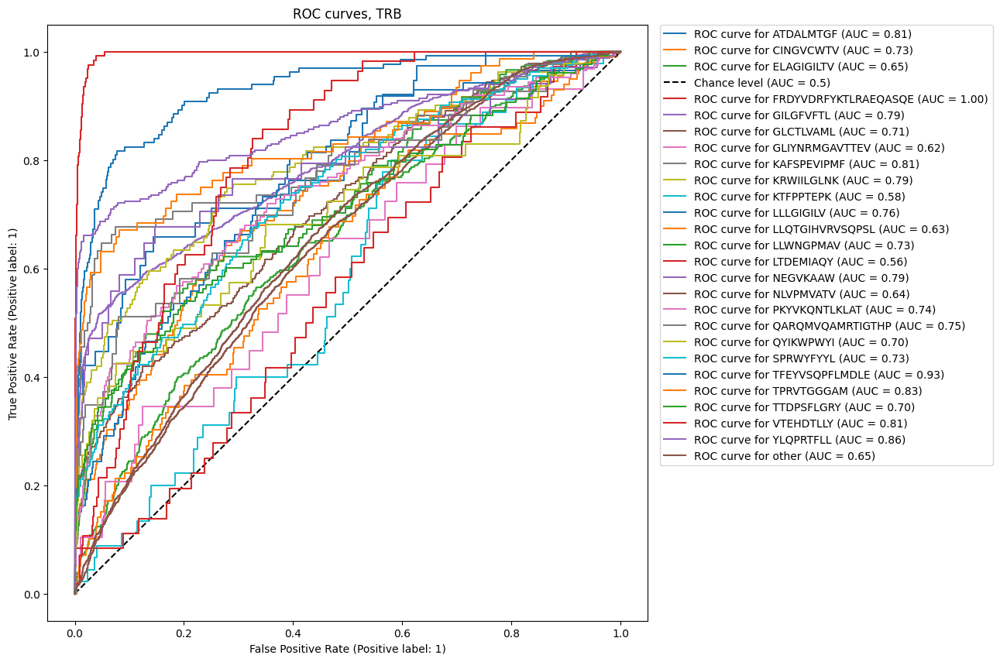

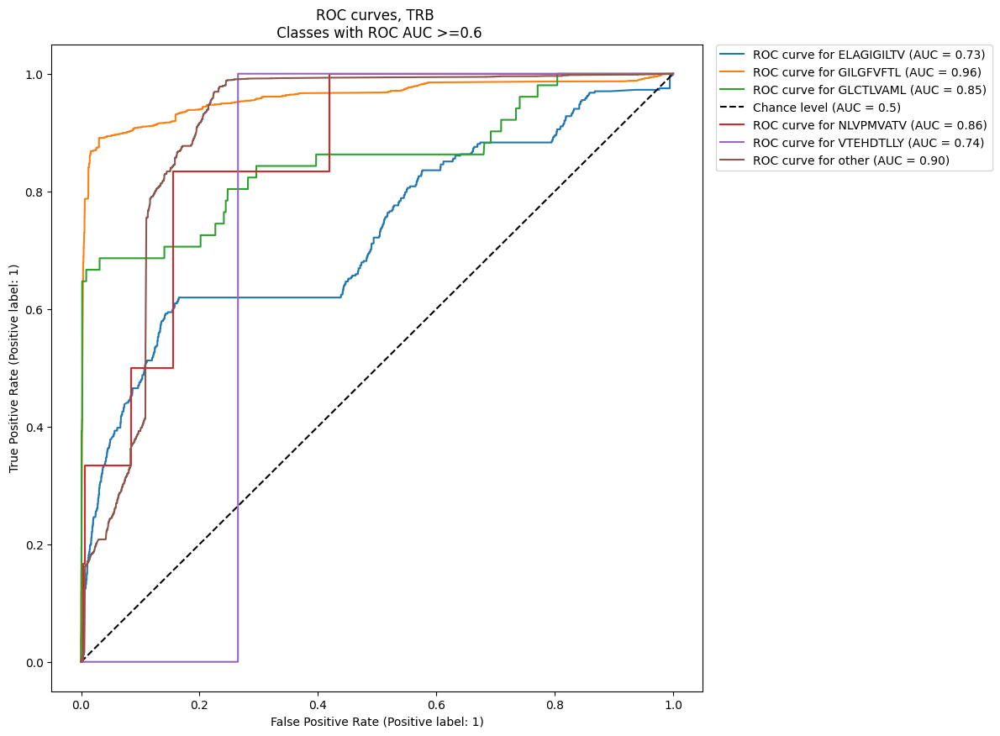

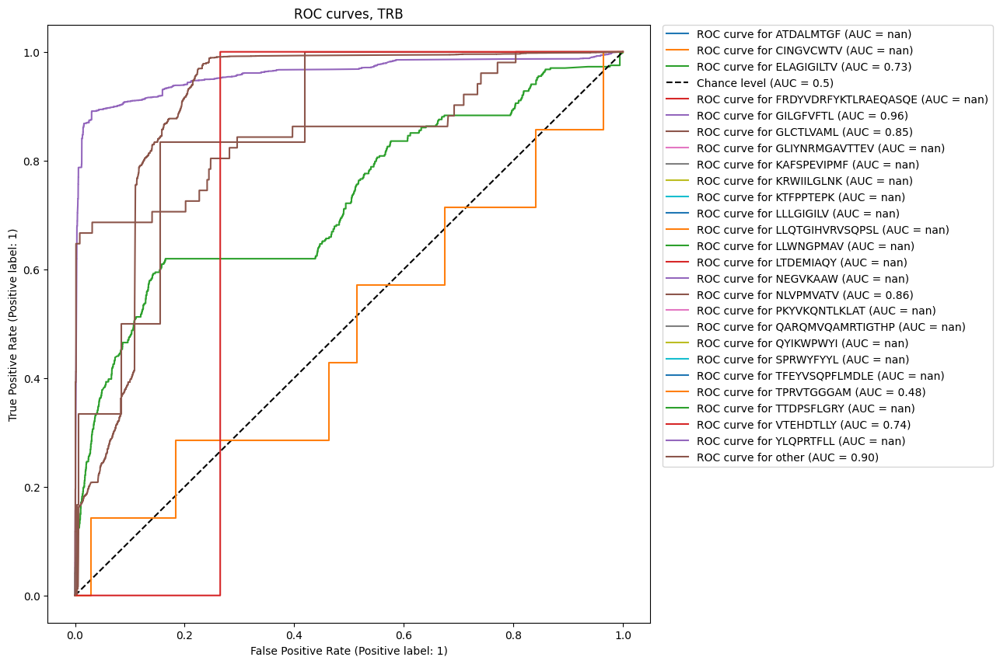

In [126]:
chain = 'TRB'
c = 6


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = SVC(C=c, random_state=0,probability=True,kernel='poly')
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
t = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)
t[-t['roc_auc'].isna()]


In [47]:
from sklearn.multiclass import OneVsRestClassifier

In [48]:
## with label_high
chain = 'TRA'
model_name = 'SVC_ovr'
clsf_dict[model_name]= {'model':{}, 'roc_auc':{}}

clf_rf_model = OneVsRestClassifier(SVC())
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code.clf_model(clf_rf_model,pca_res_annot_dict[chain][label_high], pca_res_dict[chain] , annotation_id_column_dict[chain], 0.3)


0.5396266290947517
0.4171459874007121


In [49]:
pd.DataFrame(clsf_dict[model_name]['roc_auc'][chain]).head(30)

,roc_auc
FRDYVDRFYKTLRAEQASQE,0.877417
TFEYVSQPFLMDLE,0.815174
YLQPRTFLL,0.703649
LLWNGPMAV,0.678057
GILGFVFTL,0.651810
LLLGIGILV,0.613900
GLCTLVAML,0.612467
other,0.607533
CINGVCWTV,0.603233
TTDPSFLGRY,0.569848


In [50]:
## with label_high
chain = 'TRB'
model_name = 'SVC_ovr'
clsf_dict[model_name]= {'model':{}, 'roc_auc':{}}

clf_rf_model = OneVsRestClassifier(SVC())
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code.clf_model(clf_rf_model,pca_res_annot_dict[chain][label_high], pca_res_dict[chain] , annotation_id_column_dict[chain], 0.3)


0.522864921931433
0.47244911188901856


In [51]:
pd.DataFrame(clsf_dict[model_name]['roc_auc'][chain]).head(30)

,roc_auc
FRDYVDRFYKTLRAEQASQE,0.905036
YLQPRTFLL,0.761176
GILGFVFTL,0.705433
TFEYVSQPFLMDLE,0.680417
TTPESANL,0.642454
SSYRRPVGI,0.596188
other,0.592731
CTPYDINQM,0.586101
GLCTLVAML,0.585823
SPRWYFYYL,0.544002


### Try predict_proba

In [54]:
def clf_pred_proba(model, X_pred, annotation_id, t=0.6):
    classes_list = model.classes_
    y_pred_proba = model.predict_proba(X_pred.drop(annotation_id, axis=1, errors = 'ignore'))
    pred_res = []
    for i in range(len(y_pred_proba)):
        if max(y_pred_proba[i])> t:
            pred_res.append(classes_list[np.argmax(y_pred_proba[i])])
        else:
            pred_res.append('other')
    pred = pd.DataFrame(pred_res,columns=['pred'])
    pred[annotation_id] = X_pred[annotation_id]
    return pred

In [54]:
clsf_dict={}
test_results = {'clstr':{},'clsf':{}}

In [108]:
model_name = 'RF_proba'
label_cl = label_high
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9779228486646885
Test accuracy: 0.3680420936028801
good prediction: 53 classes with roc auc >= 0.6
failed: 6 classes with roc auc < 0.6
macro: {'f1': 0.04114212527456954, 'precision': 0.045669292932921185, 'recall': 0.06537324310555691}
weighted: {'f1': 0.38481887113904495, 'precision': 0.4261883871384712, 'recall': 0.4646872297492073}
accuracy: 0.4646872297492073
macro: {'f1': 0.11118575370656175, 'precision': 0.10160406690585375, 'recall': 0.14144253570566354}
weighted: {'f1': 0.8754193204936614, 'precision': 0.924489550938101, 'recall': 0.845056212164889}
accuracy: 0.845056212164889
good prediction: 7 classes with roc auc >= 0.6
failed: 52 classes with roc auc < 0.6


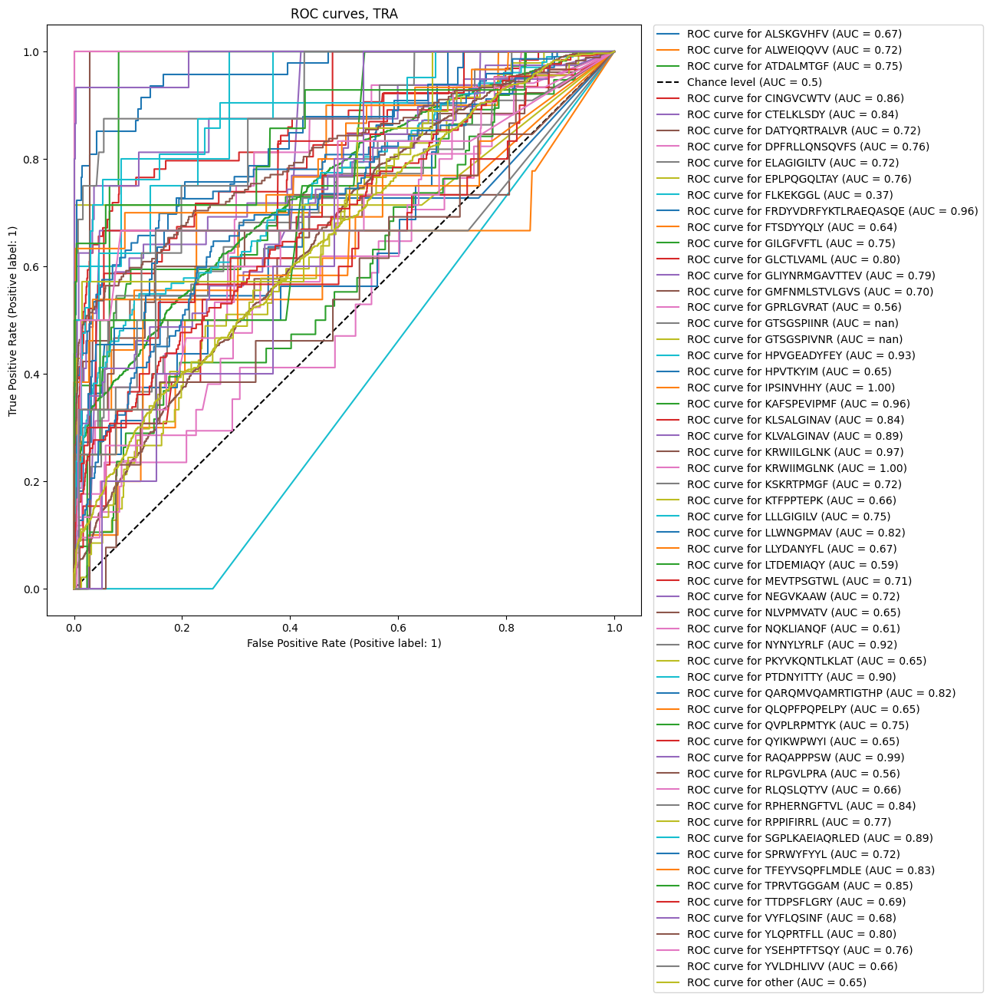

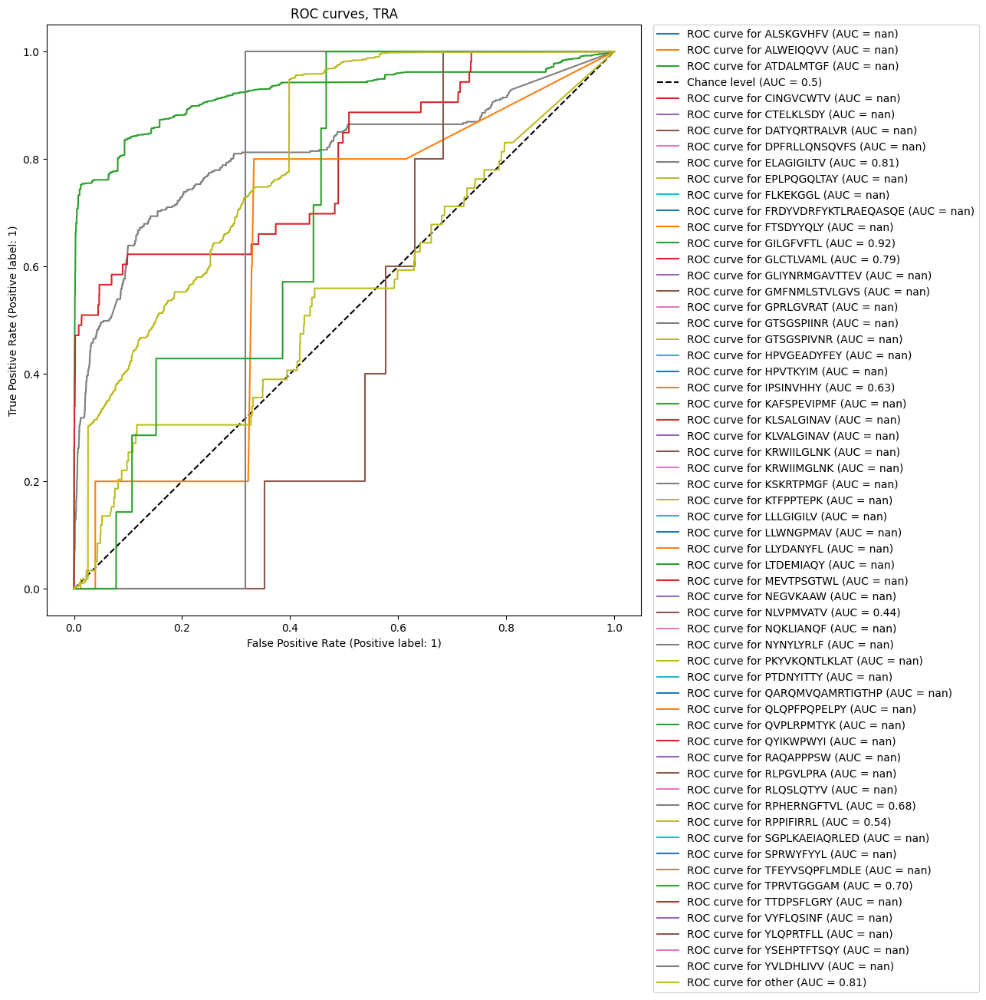

In [109]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)


Train accuracy: 0.9776172430127902
Test accuracy: 0.3463185522862274
good prediction: 72 classes with roc auc >= 0.6
failed: 9 classes with roc auc < 0.6
macro: {'f1': 0.06347723944213754, 'precision': 0.08254532520057781, 'recall': 0.07317047387866753}
weighted: {'f1': 0.5706510058277017, 'precision': 0.7207571892066037, 'recall': 0.6571356752340853}
accuracy: 0.6571356752340853
macro: {'f1': 0.20116400030883416, 'precision': 0.18765715447401157, 'recall': 0.3112526624754155}
weighted: {'f1': 0.920997441389276, 'precision': 0.962927996467724, 'recall': 0.8890843964054547}
accuracy: 0.8890843964054547
good prediction: 7 classes with roc auc >= 0.6
failed: 74 classes with roc auc < 0.6


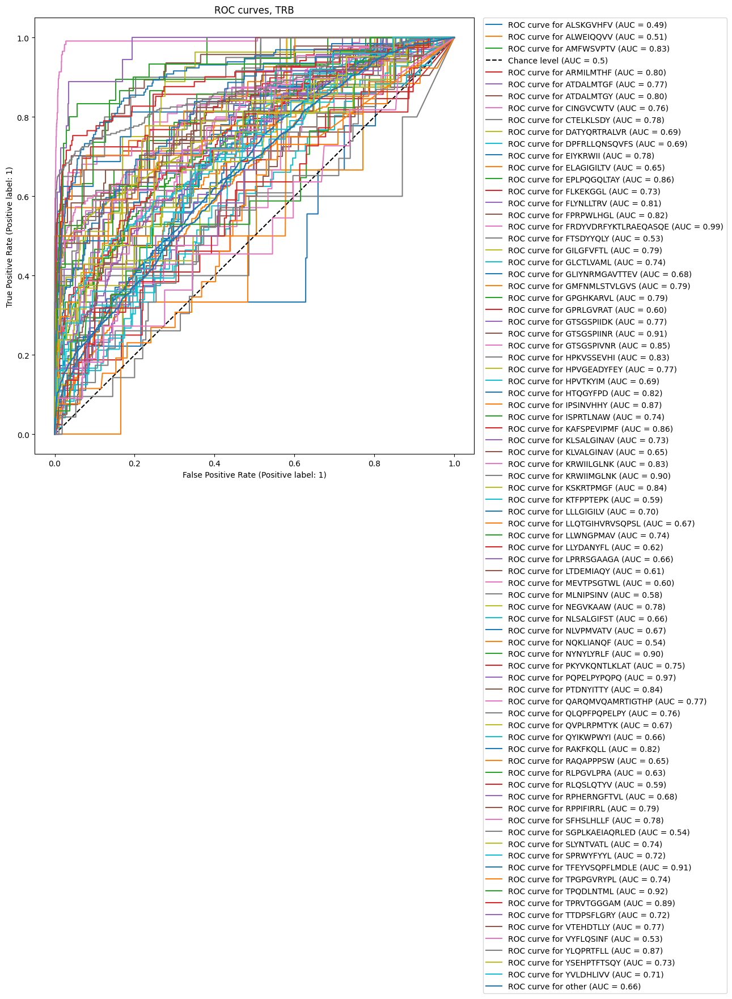

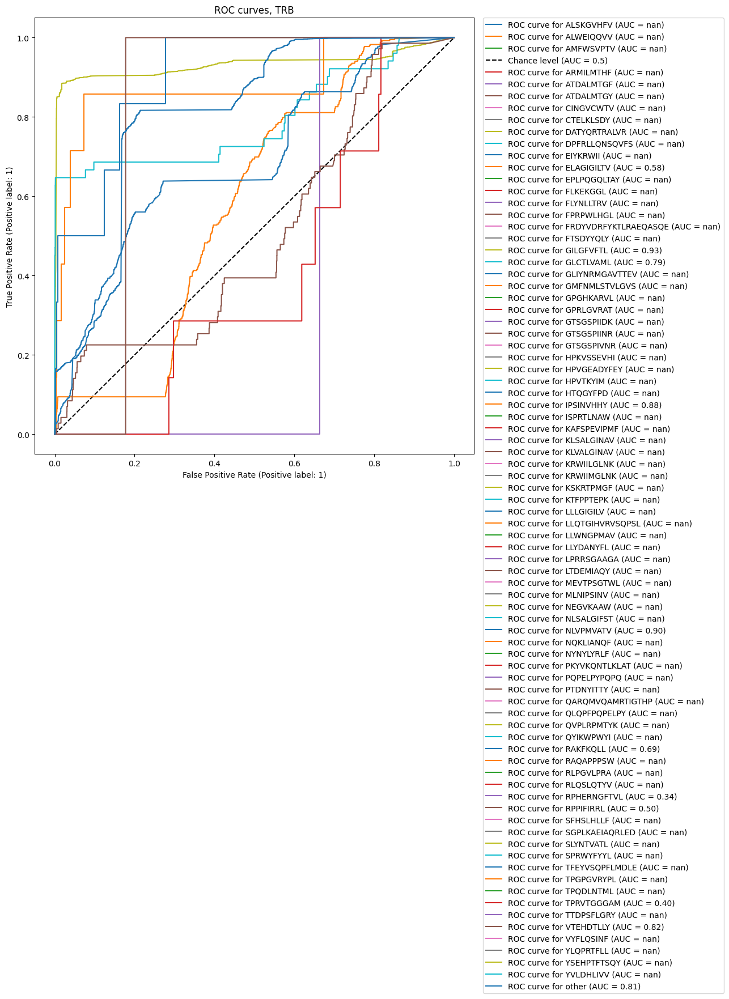

In [110]:
chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)


In [55]:
label_cl = 'antigen.epitope_high_count_20'
model_name = 'RF_proba_' + label_cl
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9767359050445104
Test accuracy: 0.3564109664912767
good prediction: 69 classes with roc auc >= 0.6
failed: 29 classes with roc auc < 0.6
macro: {'f1': 0.04337932748149594, 'precision': 0.049079804726191695, 'recall': 0.07652754985032811}
weighted: {'f1': 0.4019057385478419, 'precision': 0.5353480417908129, 'recall': 0.42483424618045545}
accuracy: 0.42483424618045545
macro: {'f1': 0.07545450191003407, 'precision': 0.0796959079371918, 'recall': 0.08522590167163932}
weighted: {'f1': 0.6723068926353046, 'precision': 0.9322909252285229, 'recall': 0.5601758431824734}
accuracy: 0.5601758431824734
good prediction: 9 classes with roc auc >= 0.6
failed: 89 classes with roc auc < 0.6


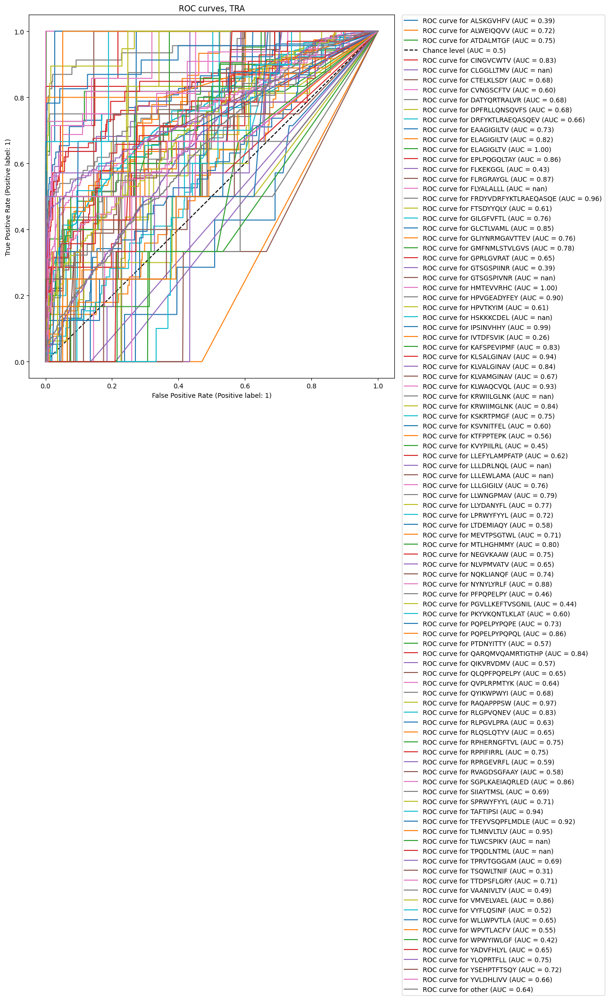

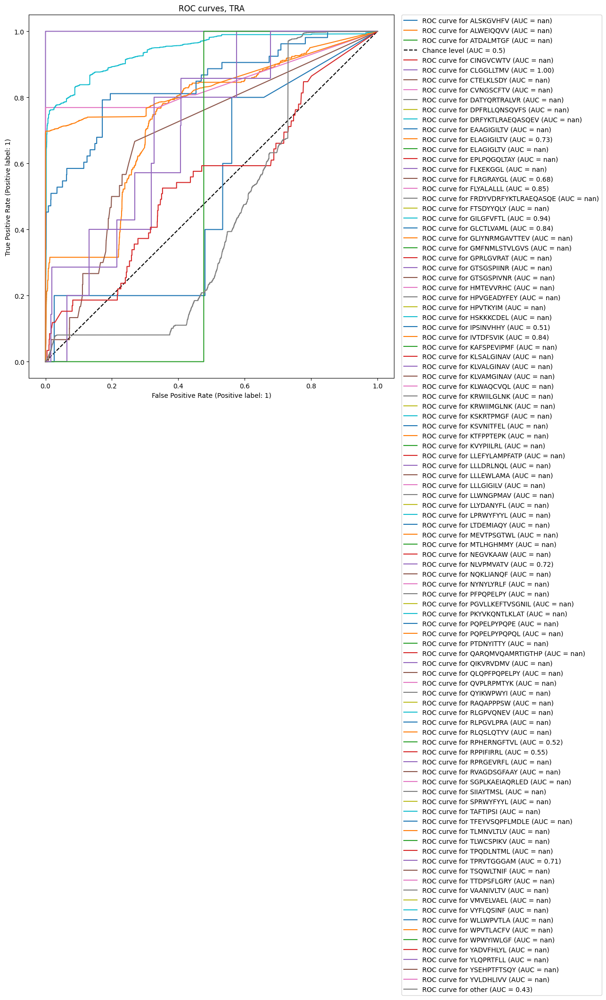

In [56]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)


In [57]:
label_cl = 'antigen.epitope_high_count_30'
model_name = 'RF_proba_' + label_cl
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9772106824925816
Test accuracy: 0.3683190252007754
good prediction: 53 classes with roc auc >= 0.6
failed: 26 classes with roc auc < 0.6
macro: {'f1': 0.0234860417667439, 'precision': 0.024837560997715825, 'recall': 0.03990037626815723}
weighted: {'f1': 0.23881027869918636, 'precision': 0.27816834290455766, 'recall': 0.23508215624099163}
accuracy: 0.23508215624099163
macro: {'f1': 0.06582396531794885, 'precision': 0.07384997983842932, 'recall': 0.07327623610284965}
weighted: {'f1': 0.6673541600529849, 'precision': 0.9302303999766205, 'recall': 0.5555635629864514}
accuracy: 0.5555635629864514
good prediction: 4 classes with roc auc >= 0.6
failed: 75 classes with roc auc < 0.6


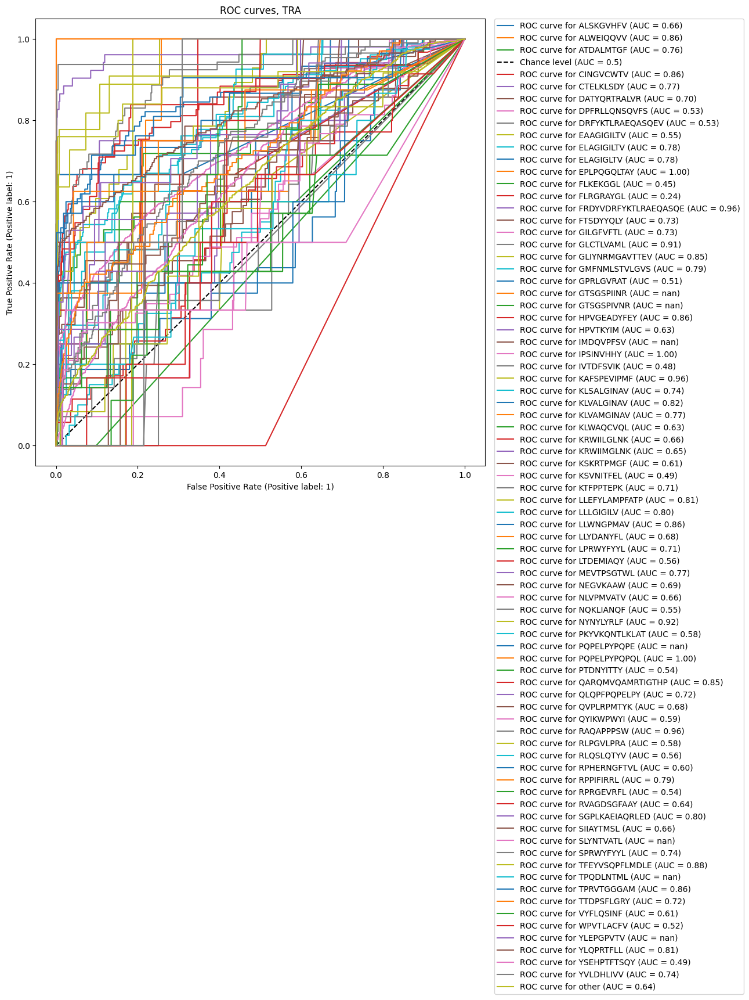

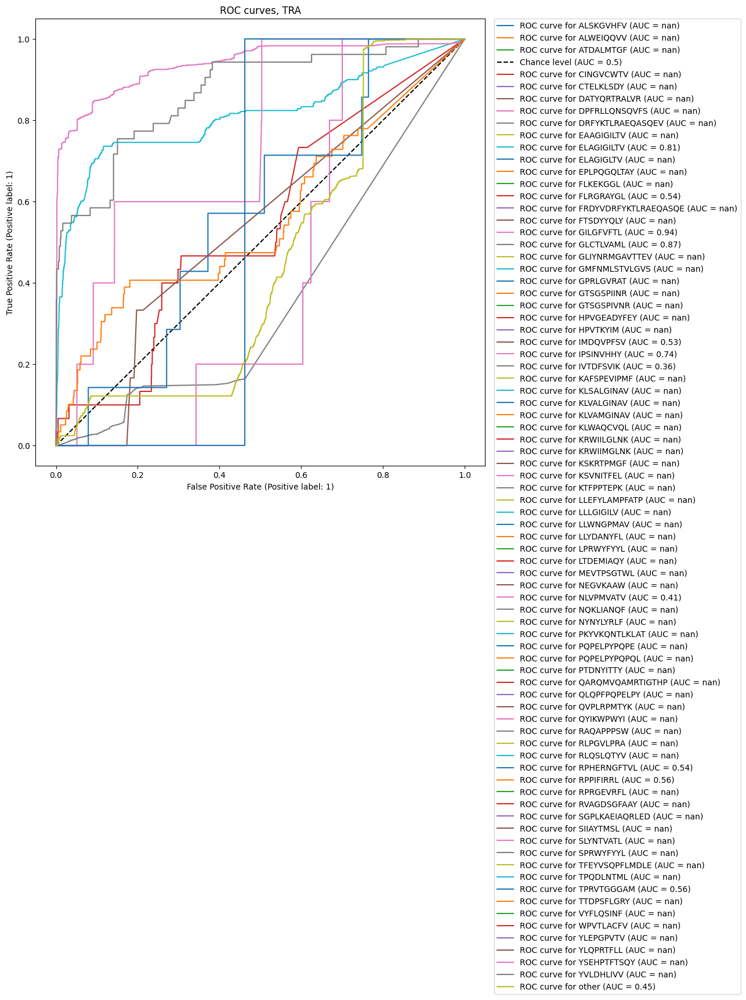

In [58]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)


In [154]:
t['flag']=t[clonotype_id_column].apply(lambda x: 1 if x in list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates()) else 0)

In [156]:
len(t[t['flag']==1])/len(t)

0.2789708849812626

### different thresholds for other using proba

Text(0.5, 1.0, 'Fraction of class other in 10x donor1, chain: TRB')

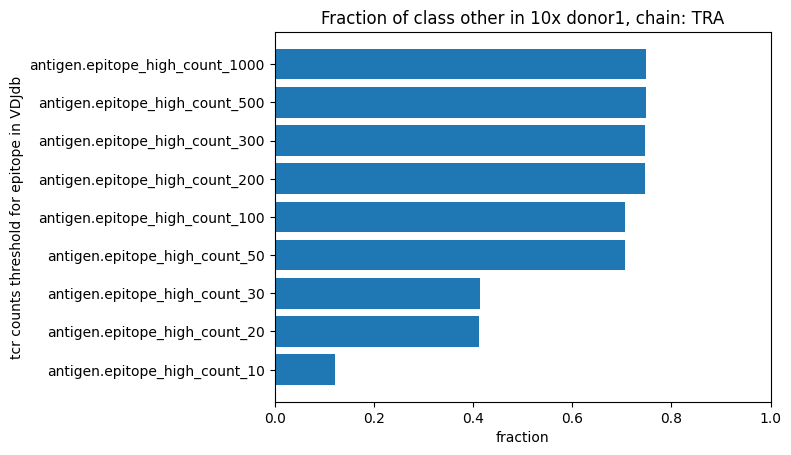

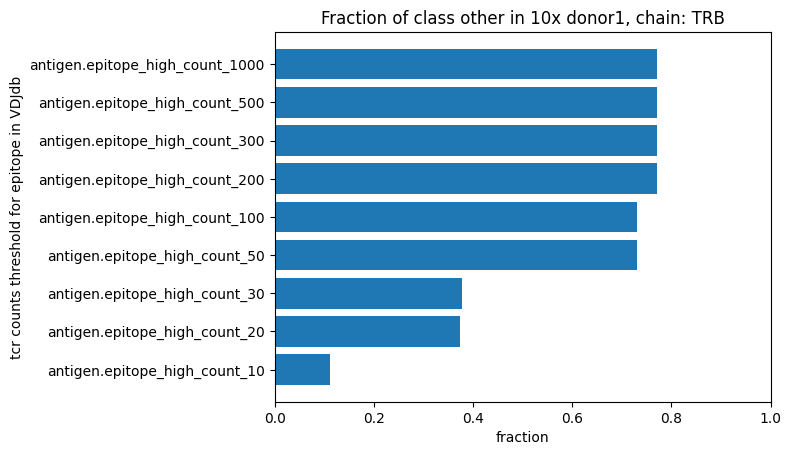

In [198]:
other_fraction={'TRA':[],'TRB':[]}
chain = 'TRA'
for k in label_high_count_dict.keys():
    label_cl = k
    other_fraction[chain].append(len(tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_cl]=='other')])
          /(len(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'])))
                           
fig, ax = plt.subplots()
ax.barh(list(label_high_count_dict.keys()),other_fraction[chain])
ax.set_xlim([0, 1])
ax.set_ylabel('tcr counts threshold for epitope in VDJdb')
ax.set_xlabel('fraction')
ax.set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')

chain = 'TRB'
for k in label_high_count_dict.keys():
    label_cl = k
    other_fraction[chain].append(len(tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_cl]=='other')])
          /(len(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'])))
                           
fig, ax = plt.subplots()
ax.barh(list(label_high_count_dict.keys()),other_fraction[chain])
ax.set_xlim([0, 1])
ax.set_ylabel('tcr counts threshold for epitope in VDJdb')
ax.set_xlabel('fraction')
ax.set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')


TRA
antigen.epitope_high_count_10
Train accuracy: 0.9753115727002968
Test accuracy: 0.3572417612849626
good prediction: 86 classes with roc auc >= 0.6
failed: 88 classes with roc auc < 0.6
prediction metrics
macro: {'f1': 0.028138499156046087, 'precision': 0.0310829256234814, 'recall': 0.041385207698674445}
weighted: {'f1': 0.39570442708872133, 'precision': 0.48315886513657064, 'recall': 0.39701643124819835}
accuracy: 0.39701643124819835
prediction using proba metrics
macro: {'f1': 0.05405451966847842, 'precision': 0.0706549709977674, 'recall': 0.07373792021712466}
weighted: {'f1': 0.3348165450450478, 'precision': 0.9408288588192741, 'recall': 0.27118766215047563}
accuracy: 0.27118766215047563
good prediction: 8 classes with roc auc >= 0.6
failed: 166 classes with roc auc < 0.6
---------------------------------------------------
antigen.epitope_high_count_20
Train accuracy: 0.976379821958457
Test accuracy: 0.3425643865965107
good prediction: 69 classes with roc auc >= 0.6
failed: 30 cl

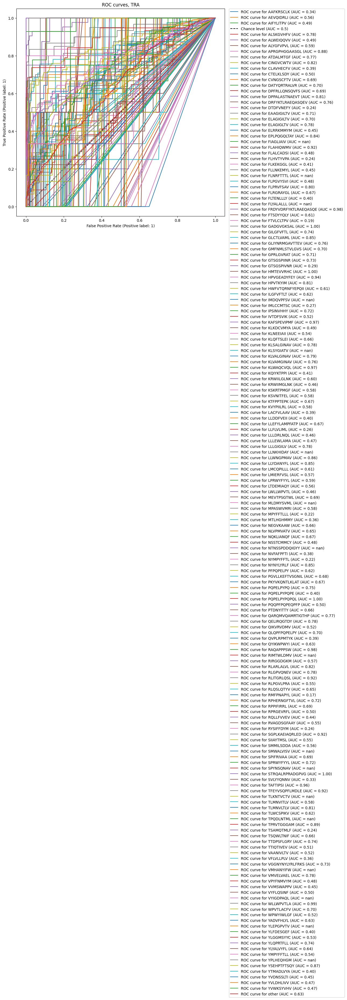

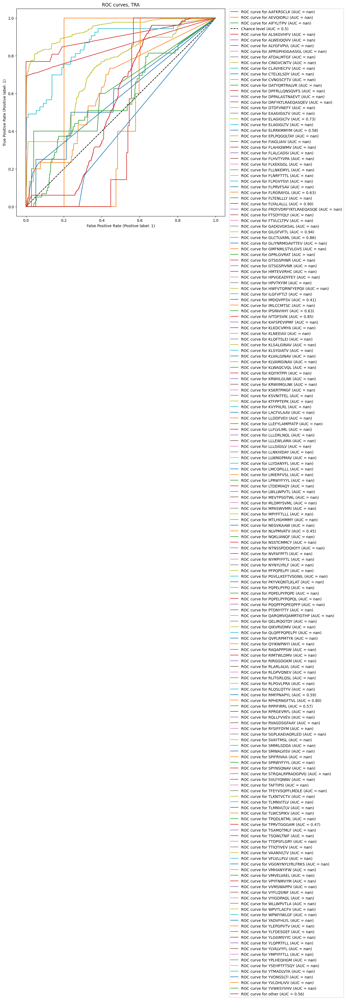

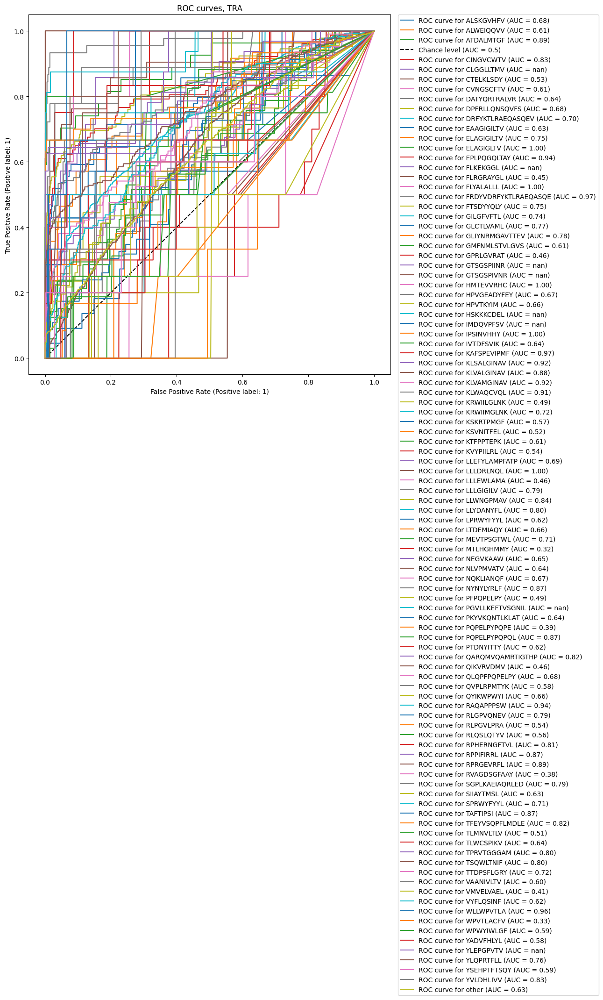

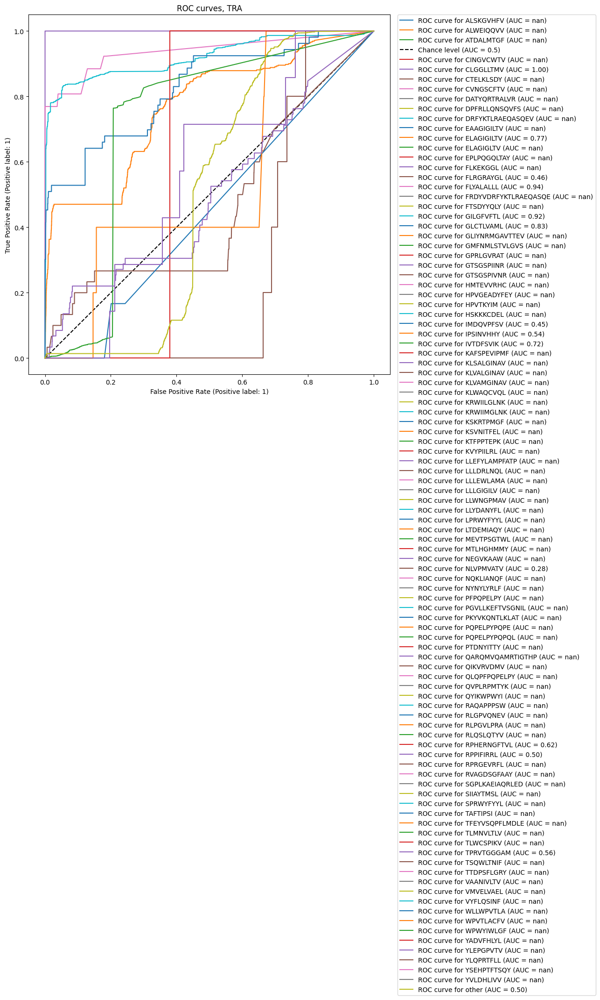

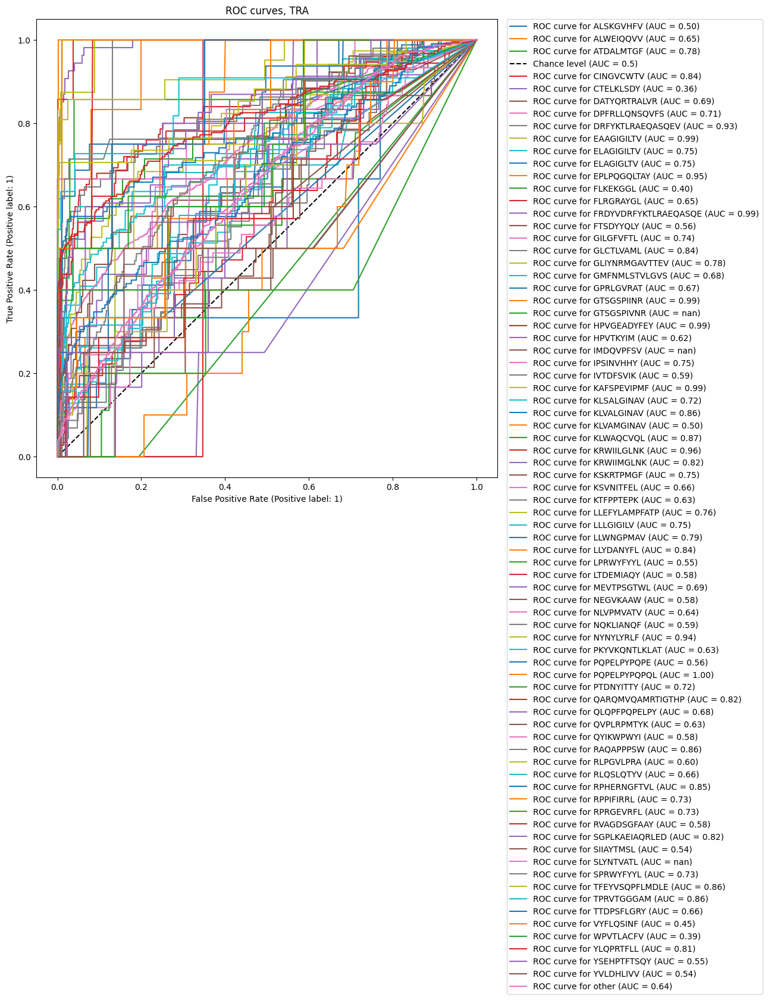

...

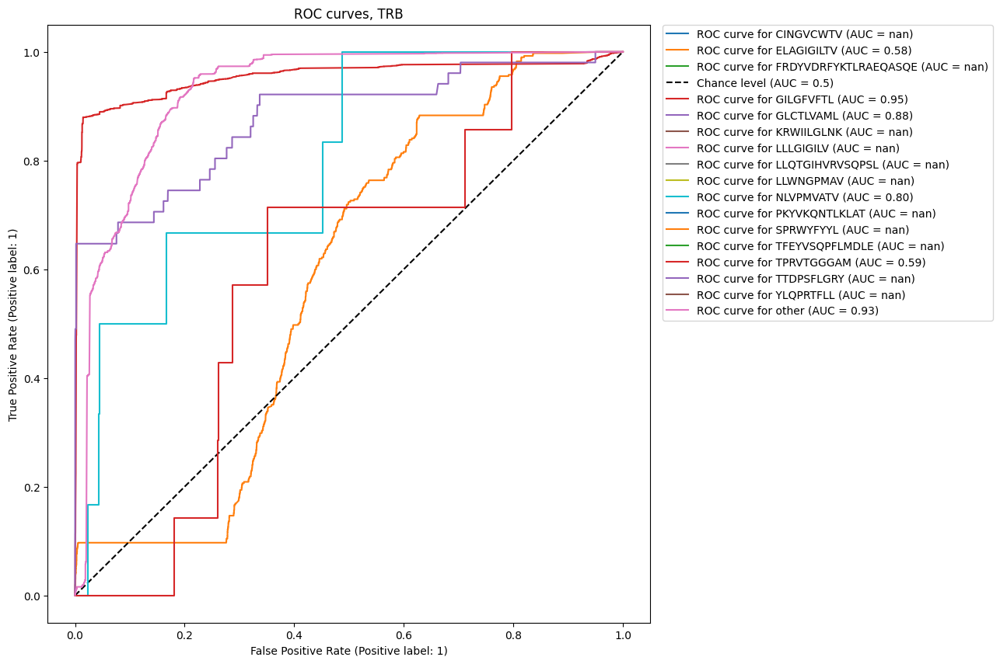

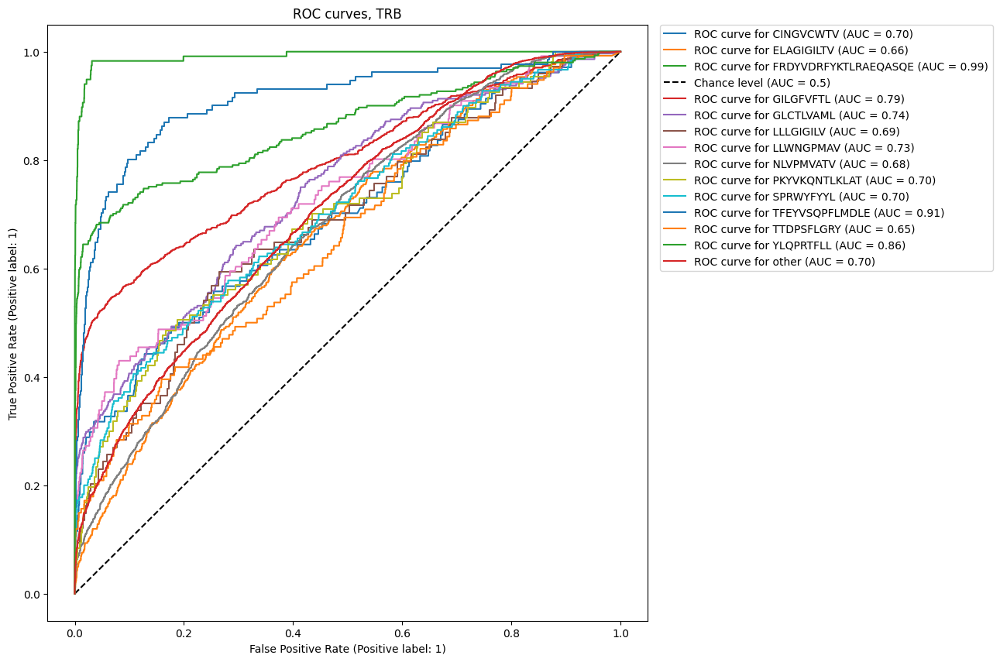

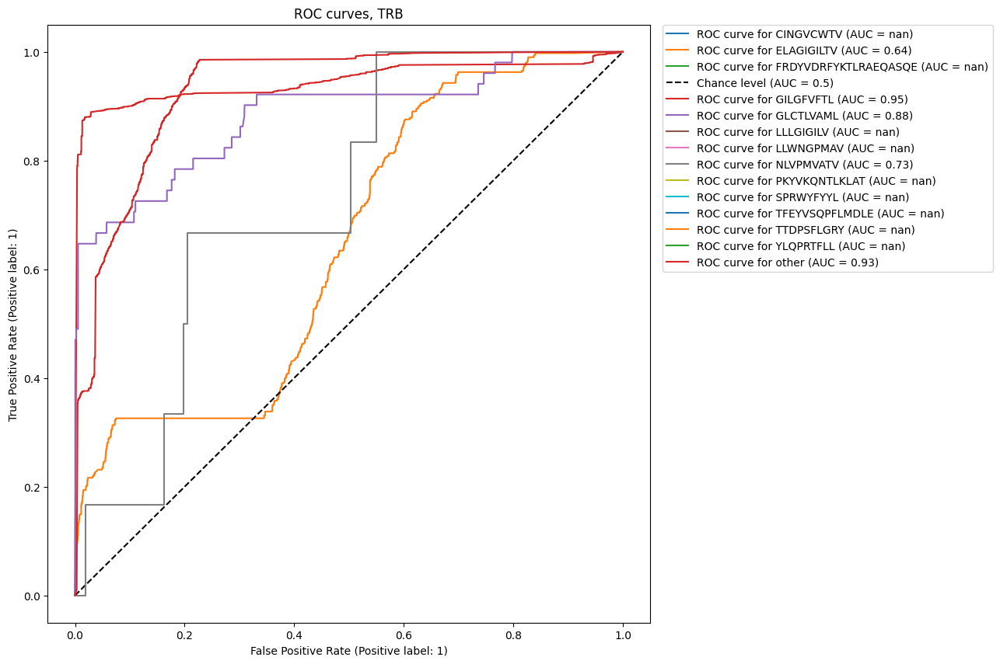

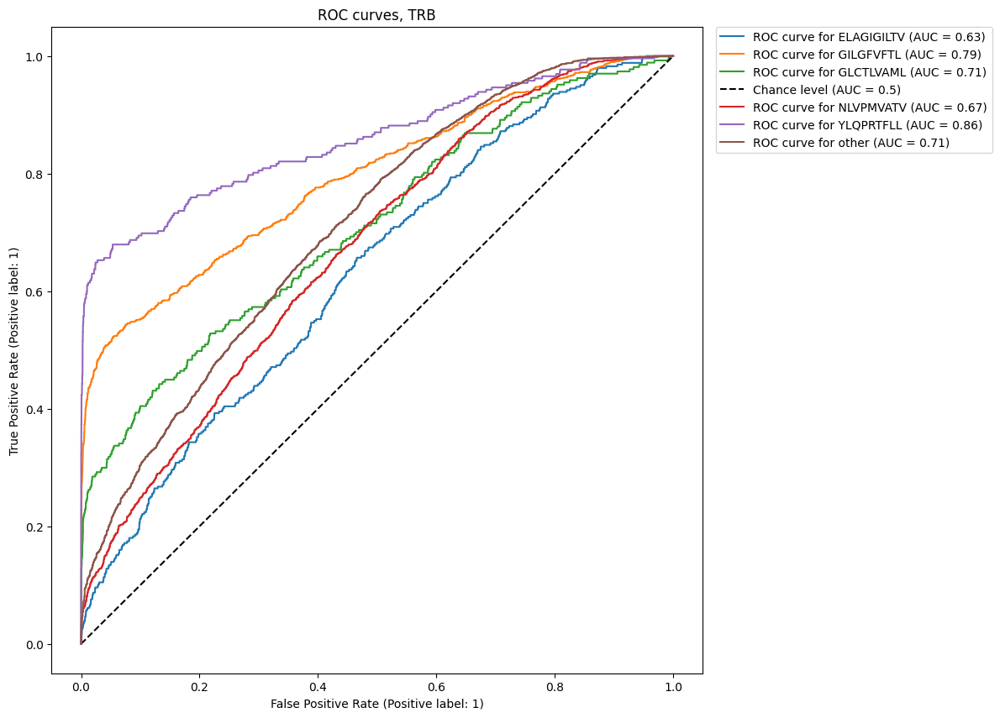

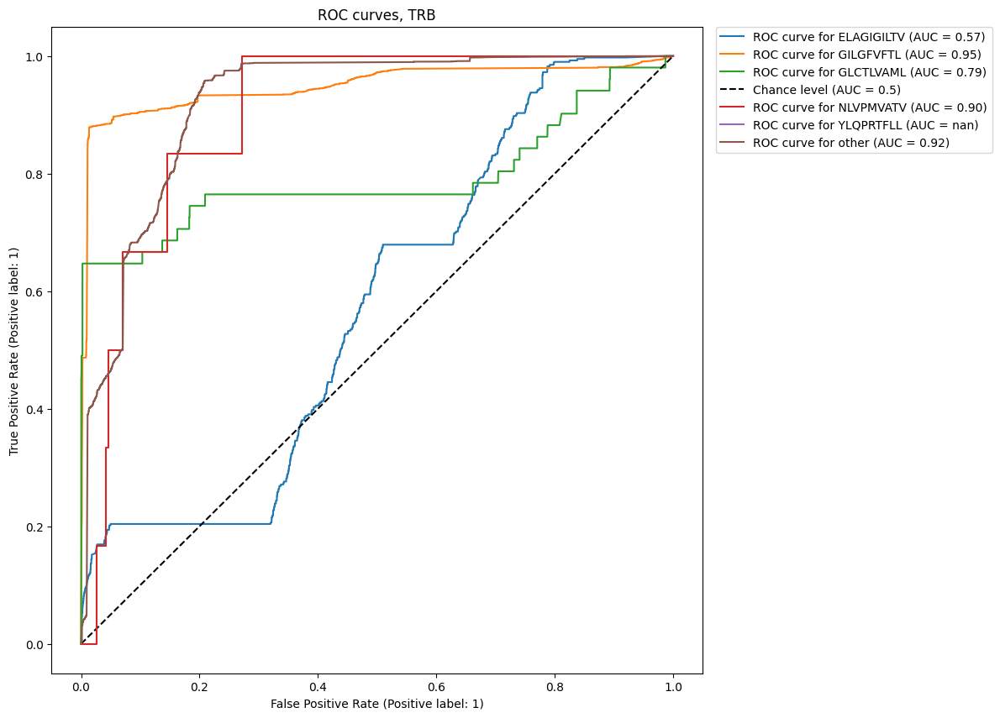

In [91]:
max_depth = 20

print('TRA')
for k in label_high_count_dict.keys():
    print(k)
    model_name = 'RF_proba_' + k
    label_cl = k
    clsf_dict[model_name]= {'model':{},'roc_auc':{}}
    test_results['clsf'][model_name] = {}
    
    chain = 'TRA'
    y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
    X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
    X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


    model = RandomForestClassifier(max_depth=max_depth, random_state=0)
    clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


    y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
    X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
    X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)
    
    print('prediction metrics')
    test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    
    print('prediction using proba metrics')
    pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

    test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
    test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)

    roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    
    print('---------------------------------------------------')

print('TRB')
for k in label_high_count_dict.keys():
    print(k)
    model_name = 'RF_proba_' + k
    label_cl = k
    #clsf_dict[model_name]= {'model':{},'roc_auc':{}}
    #test_results['clsf'][model_name] = {}
    
    chain = 'TRB'
    y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
    X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
    X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')


    model = RandomForestClassifier(max_depth=max_depth, random_state=0)
    clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


    y_pred = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'][label_cl]
    X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
    X_pred = X_pred[X_pred['data_type']=='test'].drop('data_type', axis=1, errors = 'ignore').reset_index(drop=True)


    print('prediction using metrics')
    test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    print('prediction using proba metrics')
    pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

    test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
    test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)
    
    roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    
    print('---------------------------------------------------')

In [78]:
k

'antigen.epitope_high_count_10'

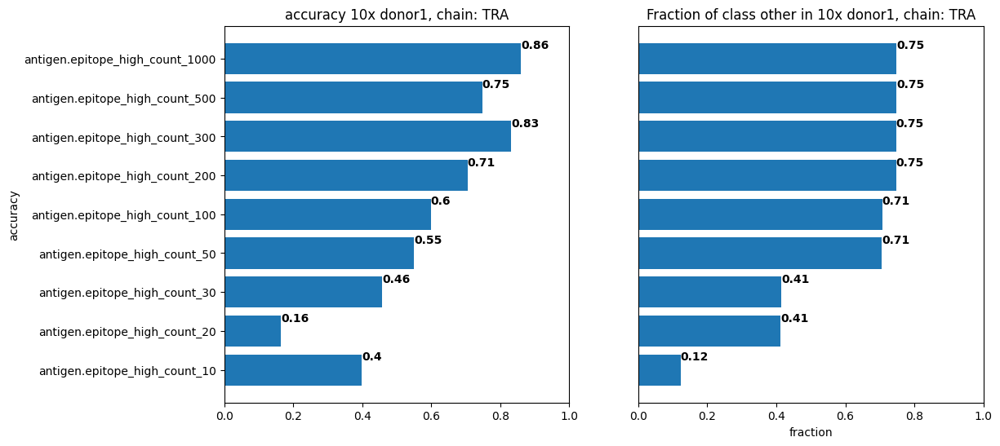

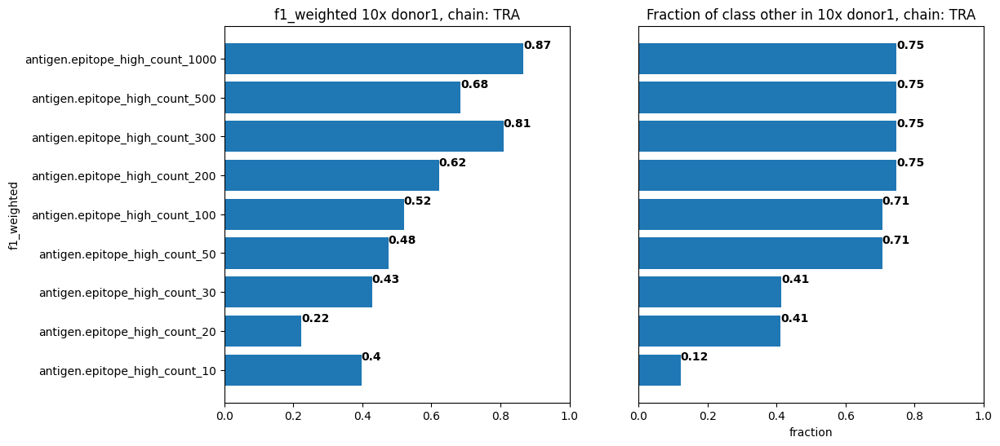

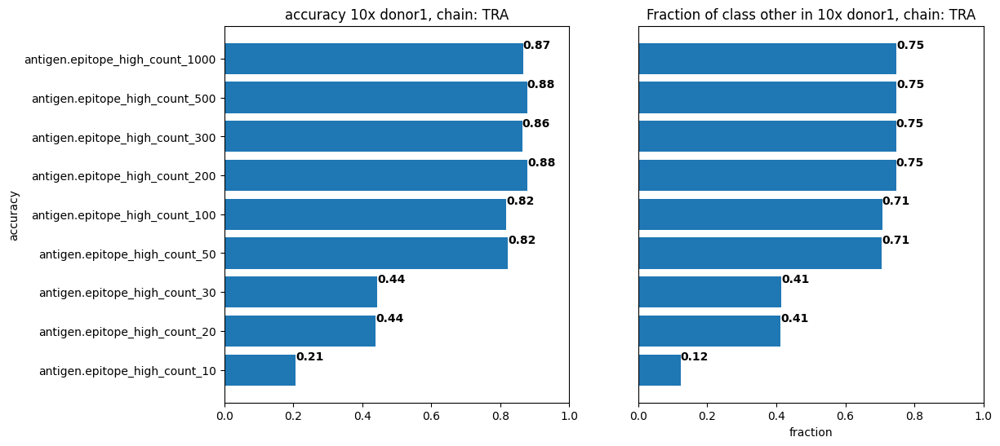

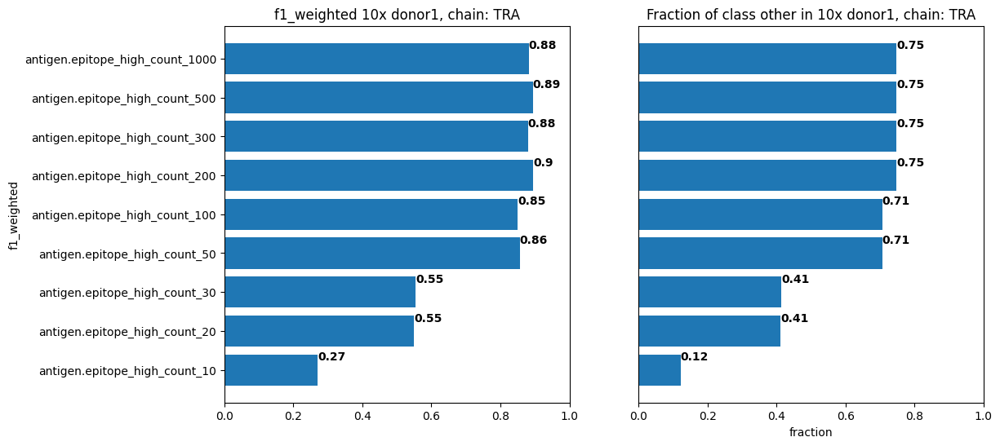

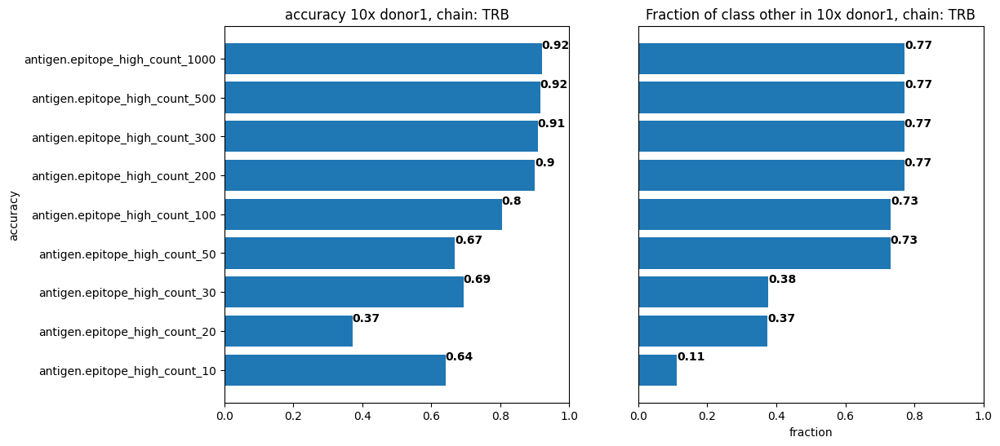

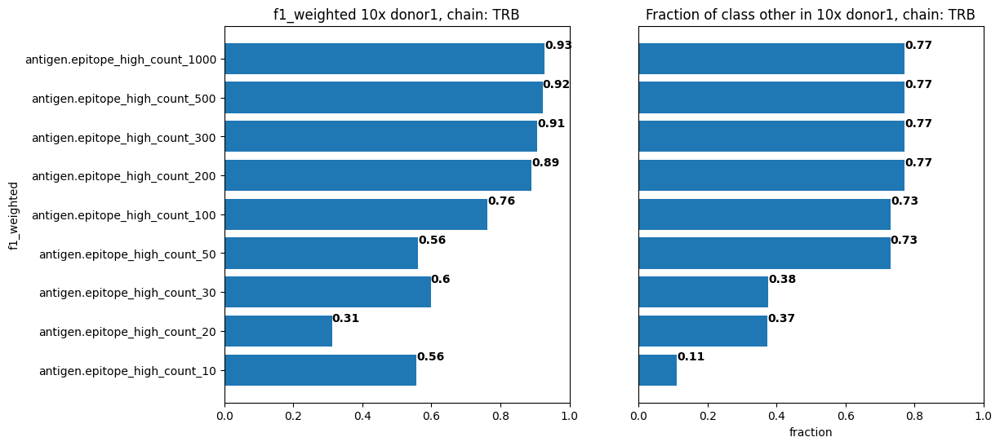

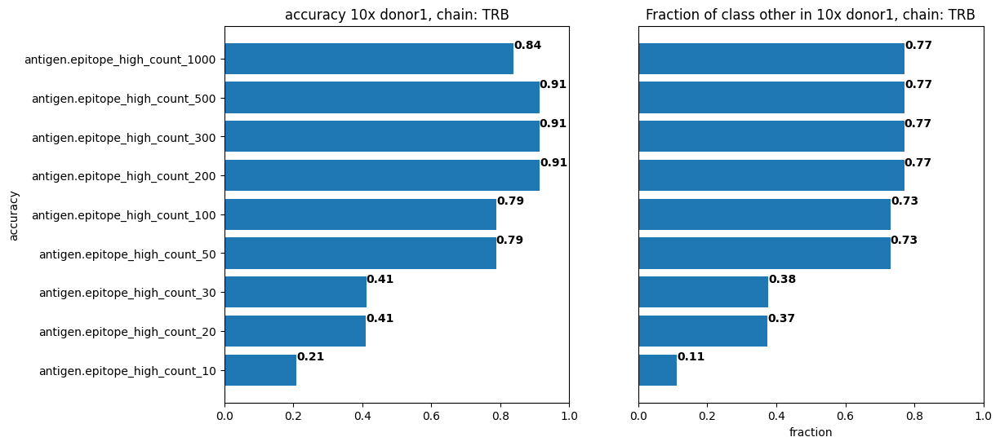

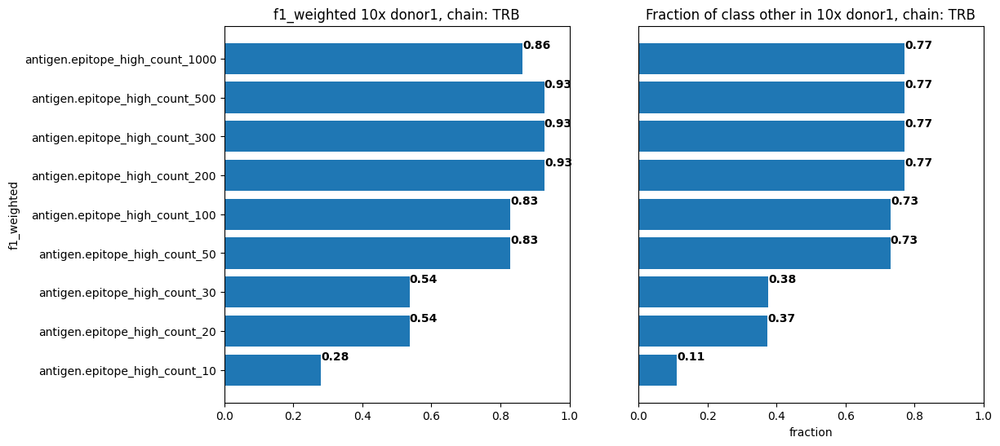

In [116]:
from sklearn.metrics import f1_score, precision_score, recall_score, accuracy_score

other_fraction={'TRA':[],'TRB':[]}

chain = 'TRA'
pred_metrics_accuracy = []
pred_metrics_f1 = []

for k in label_high_count_dict.keys():
    model_name = 'RF_proba_' + k
    pred_metrics_accuracy.append(f1_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred'], average = 'weighted'))
    pred_metrics_f1.append(accuracy_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred']))
    
    label_cl = k
    other_fraction[chain].append(len(tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_cl]=='other')])
          /(len(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'])))
    
fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_accuracy)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('accuracy')
axes[0].set_title(f'accuracy 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_accuracy):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')


axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')


fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_f1)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('f1_weighted')
axes[0].set_title(f'f1_weighted 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_f1):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')


axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')

pred_metrics_accuracy = []
pred_metrics_f1 = []

for k in label_high_count_dict.keys():
    model_name = 'RF_proba_' + k
    pred_metrics_accuracy.append(f1_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred_w_proba'], average = 'weighted'))
    pred_metrics_f1.append(accuracy_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred_w_proba']))
    
    
fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_accuracy)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('accuracy')
axes[0].set_title(f'accuracy 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_accuracy):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')

axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')

fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_f1)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('f1_weighted')
axes[0].set_title(f'f1_weighted 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_f1):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')

axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')

chain = 'TRB'
pred_metrics_accuracy = []
pred_metrics_f1 = []

for k in label_high_count_dict.keys():
    model_name = 'RF_proba_' + k
    pred_metrics_accuracy.append(f1_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred'], average = 'weighted'))
    pred_metrics_f1.append(accuracy_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred']))
    
    label_cl = k
    other_fraction[chain].append(len(tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_cl]=='other')])
          /(len(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test'])))
    
fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_accuracy)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('accuracy')
axes[0].set_title(f'accuracy 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_accuracy):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')

axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')

fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_f1)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('f1_weighted')
axes[0].set_title(f'f1_weighted 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_f1):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')

axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')

pred_metrics_accuracy = []
pred_metrics_f1 = []

for k in label_high_count_dict.keys():
    model_name = 'RF_proba_' + k
    pred_metrics_accuracy.append(f1_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred_w_proba'], average = 'weighted'))
    pred_metrics_f1.append(accuracy_score(test_results['clsf'][model_name][chain][k], test_results['clsf'][model_name][chain]['pred_w_proba']))
    

    
fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_accuracy)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('accuracy')
axes[0].set_title(f'accuracy 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_accuracy):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')

axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')

fig, axes = plt.subplots(1,2,figsize=(12,6))
axes[0].barh(list(label_high_count_dict.keys()),pred_metrics_f1)
axes[0].set_xlim([0, 1])
axes[0].set_ylabel('f1_weighted')
axes[0].set_title(f'f1_weighted 10x {donor}, chain: {chain}')

for i, v in enumerate(pred_metrics_f1):
    axes[0].text(v, i + .25, str(round(v,2)), fontweight='bold')

axes[1].barh(list(label_high_count_dict.keys()),other_fraction[chain])
axes[1].set_xlim([0, 1])
axes[1].set_ylabel('tcr counts threshold for epitope in VDJdb')
axes[1].set_xlabel('fraction')
axes[1].set_title(f'Fraction of class other in 10x {donor}, chain: {chain}')
axes[1].axes.get_yaxis().set_visible(False)

for i, v in enumerate(other_fraction[chain]):
    axes[1].text(v, i + .25, str(round(v,2)), fontweight='bold')
    

### Train without other

In [145]:
label_cl = label
label_filter = 'antigen.epitope_high_count_50'
model_name = 'RF_' + 'without_other'
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

train_len:10002
Train accuracy: 0.9828595914869305
Test accuracy: 0.42285904698433857
good prediction: 52 classes with roc auc >= 0.6
failed: 7 classes with roc auc < 0.6
prediction metrics
macro: {'f1': 0.02610618420352353, 'precision': 0.0304120581843957, 'recall': 0.038343543146899854}
weighted: {'f1': 0.24413987268356724, 'precision': 0.32323984334765443, 'recall': 0.19659844335543383}
accuracy: 0.19659844335543383
prediction using proba metrics
macro: {'f1': 0.1143554953117357, 'precision': 0.1045569342941676, 'recall': 0.14230292353744595}
weighted: {'f1': 0.8771088382885788, 'precision': 0.9224181369798722, 'recall': 0.8482992216777169}
accuracy: 0.8482992216777169
good prediction: 7 classes with roc auc >= 0.6
failed: 52 classes with roc auc < 0.6


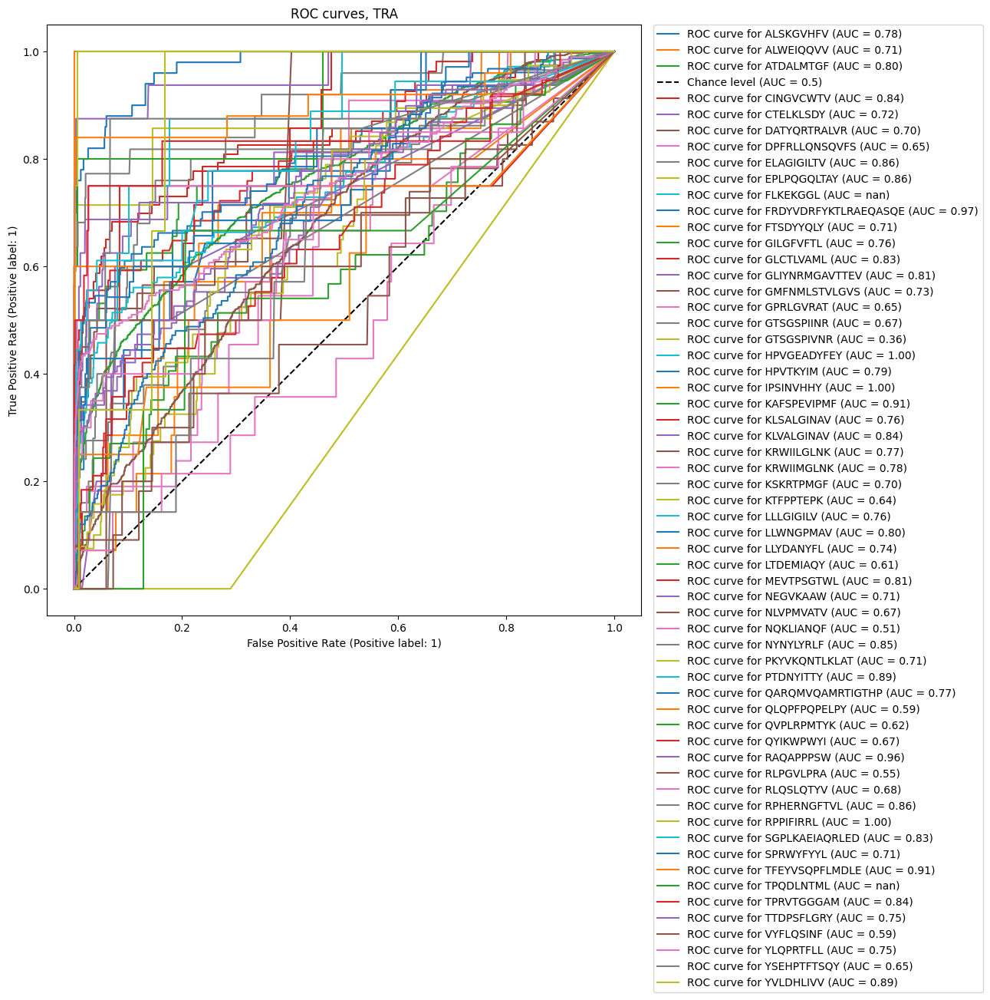

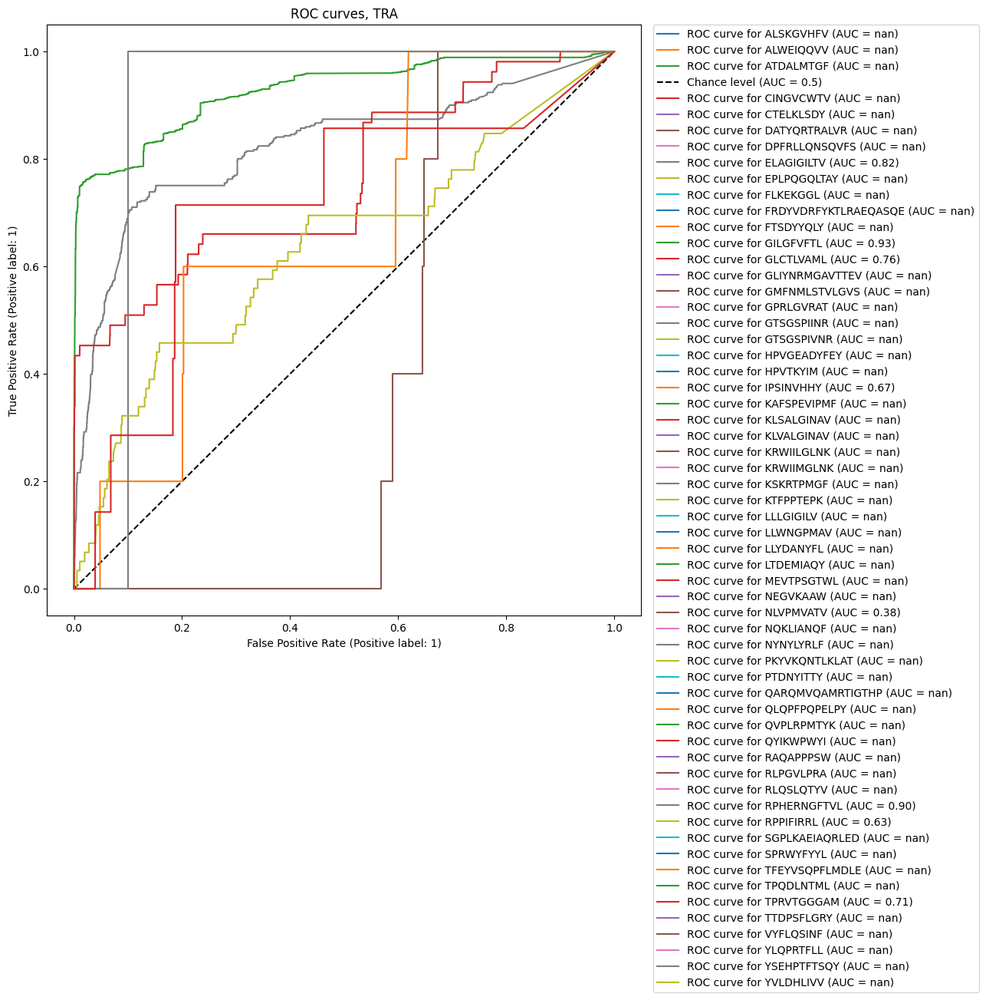

In [147]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='train')&(tcremb['annot'][chain][label_filter]!='other')][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_data = X_data[(X_data['data_type']=='train')&(X_data[label_filter]!='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore')

print(f'train_len:{len(y_data)}')
model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


#y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
#X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
#X_pred = X_pred[(X_pred['data_type']=='test')&(X_pred[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore').reset_index(drop=True)

y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')][label_filter]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_pred = X_pred[(X_pred['data_type']=='test')].drop(['data_type',label_filter], axis=1, errors = 'ignore').reset_index(drop=True)


print('prediction metrics')
test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    
print('prediction using proba metrics')
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    


### Try other

In [138]:
label_cl = 'antigen.epitope_high_count_10'
label_filter = 'antigen.epitope_high_count_50'
model_name = 'RF_' + 'only_other_of_50_' + label_cl
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9725931131412509
Test accuracy: 0.574468085106383
good prediction: 50 classes with roc auc >= 0.6
failed: 67 classes with roc auc < 0.6
prediction metrics
macro: {'f1': 0.04072304205551986, 'precision': 0.07672665185923877, 'recall': 0.04962203228869894}
weighted: {'f1': 0.2935979960556624, 'precision': 0.9898491705280997, 'recall': 0.17255102040816325}
accuracy: 0.17255102040816325
good prediction: 3 classes with roc auc >= 0.6
failed: 114 classes with roc auc < 0.6


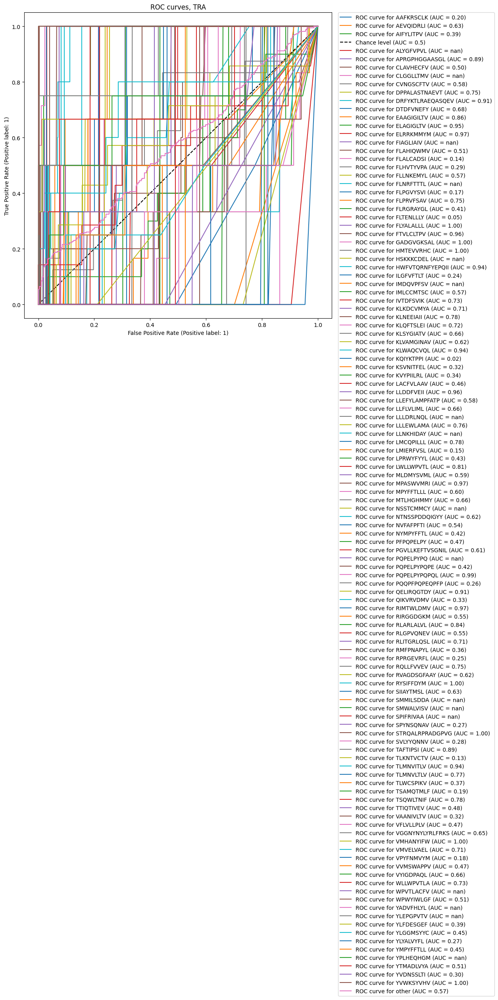

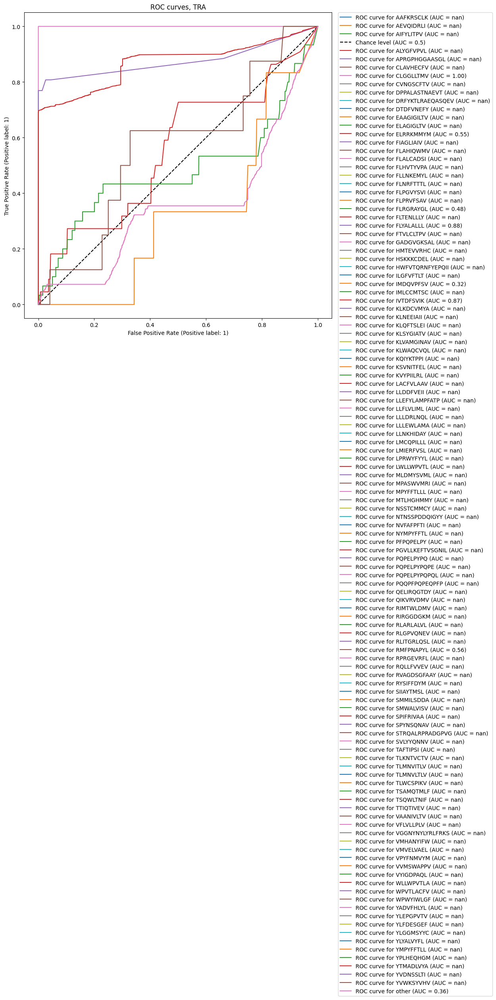

In [139]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='train')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_data = X_data[(X_data['data_type']=='train')&(X_data[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_pred = X_pred[(X_pred['data_type']=='test')&(X_pred[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore').reset_index(drop=True)


print('prediction metrics')
test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    
#print('prediction using proba metrics')
#pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

#test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    


Train accuracy: 0.9850689127105666
Test accuracy: 0.4901785714285714
good prediction: 82 classes with roc auc >= 0.6
failed: 67 classes with roc auc < 0.6
prediction metrics
macro: {'f1': 0.15134192727368945, 'precision': 0.192103195090204, 'recall': 0.14950774156139846}
weighted: {'f1': 0.5551758182747735, 'precision': 0.9058758476612603, 'recall': 0.5135088625021511}
accuracy: 0.5135088625021511
good prediction: 7 classes with roc auc >= 0.6
failed: 142 classes with roc auc < 0.6


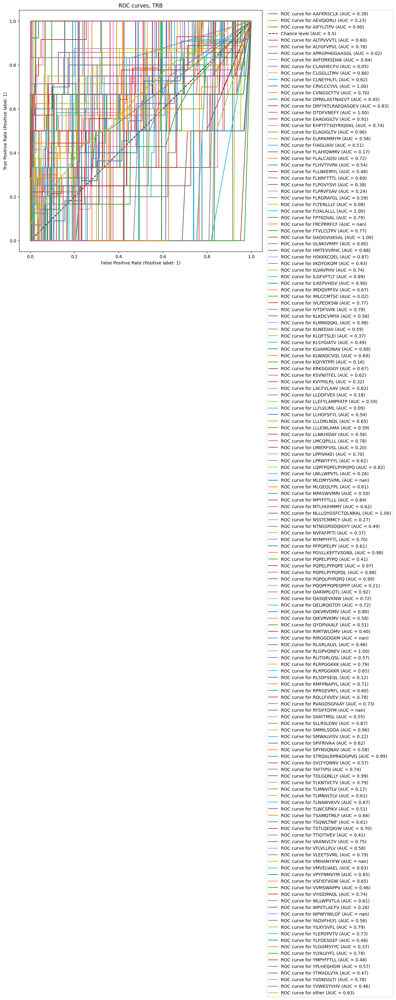

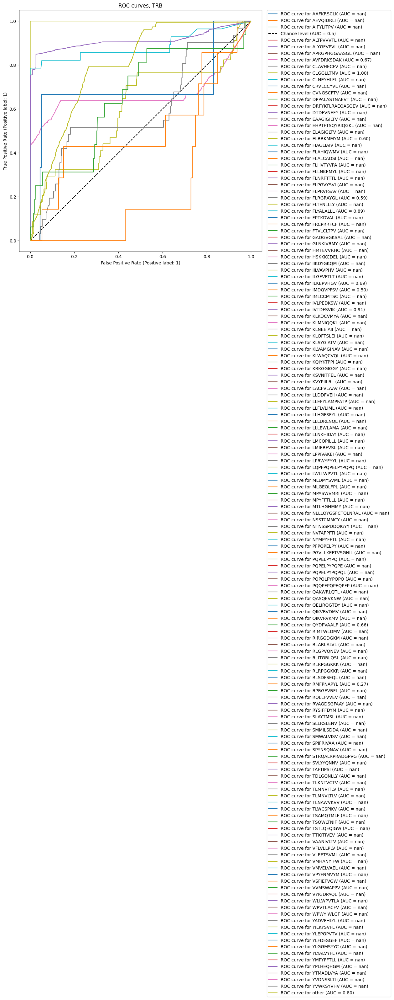

In [140]:
chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='train')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_data = X_data[(X_data['data_type']=='train')&(X_data[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_pred = X_pred[(X_pred['data_type']=='test')&(X_pred[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore').reset_index(drop=True)


print('prediction metrics')
test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    
#print('prediction using proba metrics')
#pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

#test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    


In [141]:
X_pred

,0,1,2,3,4,5,6,7,8,9,...,41,42,43,44,45,46,47,48,49,annotId
0,623.317854,-1382.003215,-921.606821,-3228.261411,1670.084579,8801.177432,-4795.578374,-1912.854174,-941.409693,2302.894159,...,-869.872591,549.525825,-278.349841,-492.601674,712.252335,-223.493154,-486.292158,-55.236461,-76.171762,24146
1,-3618.007657,1716.596225,-1410.053038,-6691.342148,331.250510,3323.057703,-3604.247925,-1173.711821,-326.612617,-374.440481,...,-120.013520,707.729122,-106.379590,-96.576851,8.025533,-568.211300,-817.082647,80.716497,-116.954935,24148
2,4025.060200,-1346.399626,-921.184760,-5514.549533,1921.470040,2750.093543,-5064.918283,-945.772311,199.633182,-279.042635,...,97.682681,492.862075,169.115596,-223.393303,108.667137,-284.486250,0.387779,-37.467938,-178.964111,24149
3,-3618.007657,1716.596225,-1410.053038,-6691.342148,331.250510,3323.057703,-3604.247925,-1173.711821,-326.612617,-374.440481,...,-120.013520,707.729122,-106.379590,-96.576851,8.025533,-568.211300,-817.082647,80.716497,-116.954935,24150
4,-3618.007657,1716.596225,-1410.053038,-6691.342148,331.250510,3323.057703,-3604.247925,-1173.711821,-326.612617,-374.440481,...,-120.013520,707.729122,-106.379590,-96.576851,8.025533,-568.211300,-817.082647,80.716497,-116.954935,24151
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11617,4025.060200,-1346.399626,-921.184760,-5514.549533,1921.470040,2750.093543,-5064.918283,-945.772311,199.633182,-279.042635,...,97.682681,492.862075,169.115596,-223.393303,108.667137,-284.486250,0.387779,-37.467938,-178.964111,40177
11618,1908.697149,-1545.746216,569.328998,-5348.274149,604.675960,4805.536535,-5267.307356,-87.125087,132.968434,1895.155603,...,741.230623,273.013094,212.494371,96.417140,447.681910,791.948452,-870.974366,218.288744,-348.656367,40178
11619,2851.357045,-1675.740282,1008.353227,-5479.369337,1297.339006,5003.050730,-5062.993093,-36.145829,-692.887194,1328.834952,...,336.400447,997.566080,260.547506,-130.638555,-136.441457,-682.246702,-945.388871,151.579080,-539.856372,40179
11620,-3618.007657,1716.596225,-1410.053038,-6691.342148,331.250510,3323.057703,-3604.247925,-1173.711821,-326.612617,-374.440481,...,-120.013520,707.729122,-106.379590,-96.576851,8.025533,-568.211300,-817.082647,80.716497,-116.954935,40180


In [135]:
label_cl = 'antigen.epitope_high_count_20'
label_filter = 'antigen.epitope_high_count_50'
model_name = 'RF_' + 'only_other_of_50_' + label_cl
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.893183415319747
Test accuracy: 0.7872340425531915
good prediction: 20 classes with roc auc >= 0.6
failed: 21 classes with roc auc < 0.6
prediction metrics
macro: {'f1': 0.21567540539452662, 'precision': 0.2738633608555689, 'recall': 0.26036875191659004}
weighted: {'f1': 0.7351795625248438, 'precision': 0.9971691284301661, 'recall': 0.5825510204081633}
accuracy: 0.5825510204081633


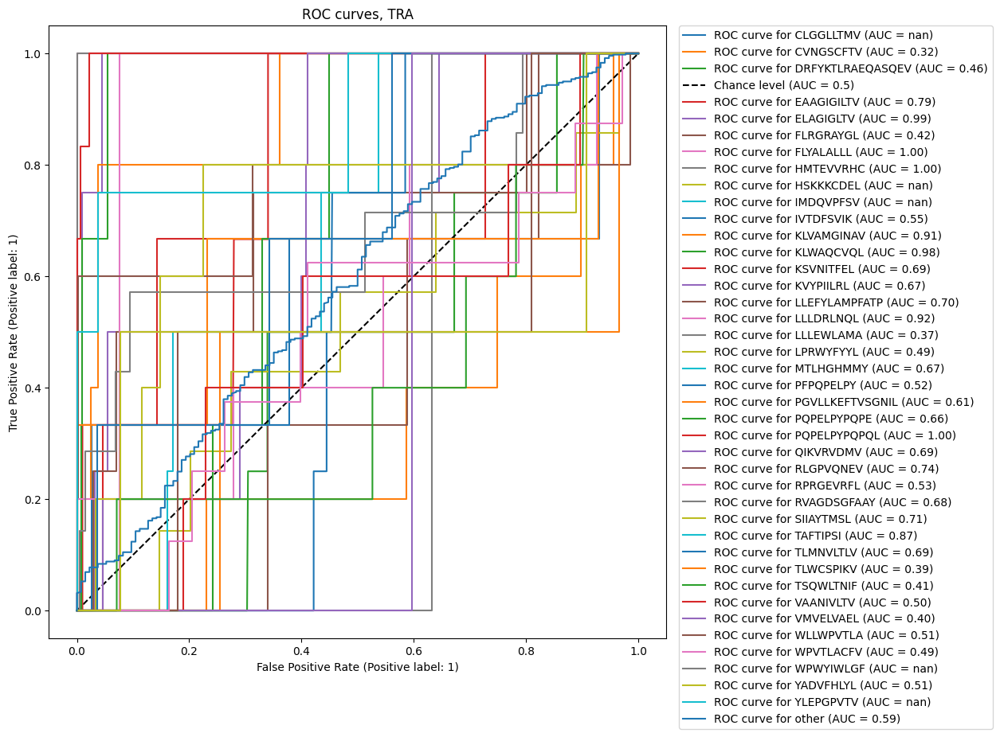

In [136]:
chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='train')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_data = X_data[(X_data['data_type']=='train')&(X_data[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_pred = X_pred[(X_pred['data_type']=='test')&(X_pred[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore').reset_index(drop=True)


print('prediction metrics')
test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    
#print('prediction using proba metrics')
#pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

#test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)

#roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    


Train accuracy: 0.8878254211332313
Test accuracy: 0.6758928571428572
good prediction: 45 classes with roc auc >= 0.6
failed: 13 classes with roc auc < 0.6
prediction metrics
macro: {'f1': 0.15757036272842545, 'precision': 0.17857392129431504, 'recall': 0.27308003405704556}
weighted: {'f1': 0.6781475338007973, 'precision': 0.9987122746678824, 'recall': 0.513939081053175}
accuracy: 0.513939081053175


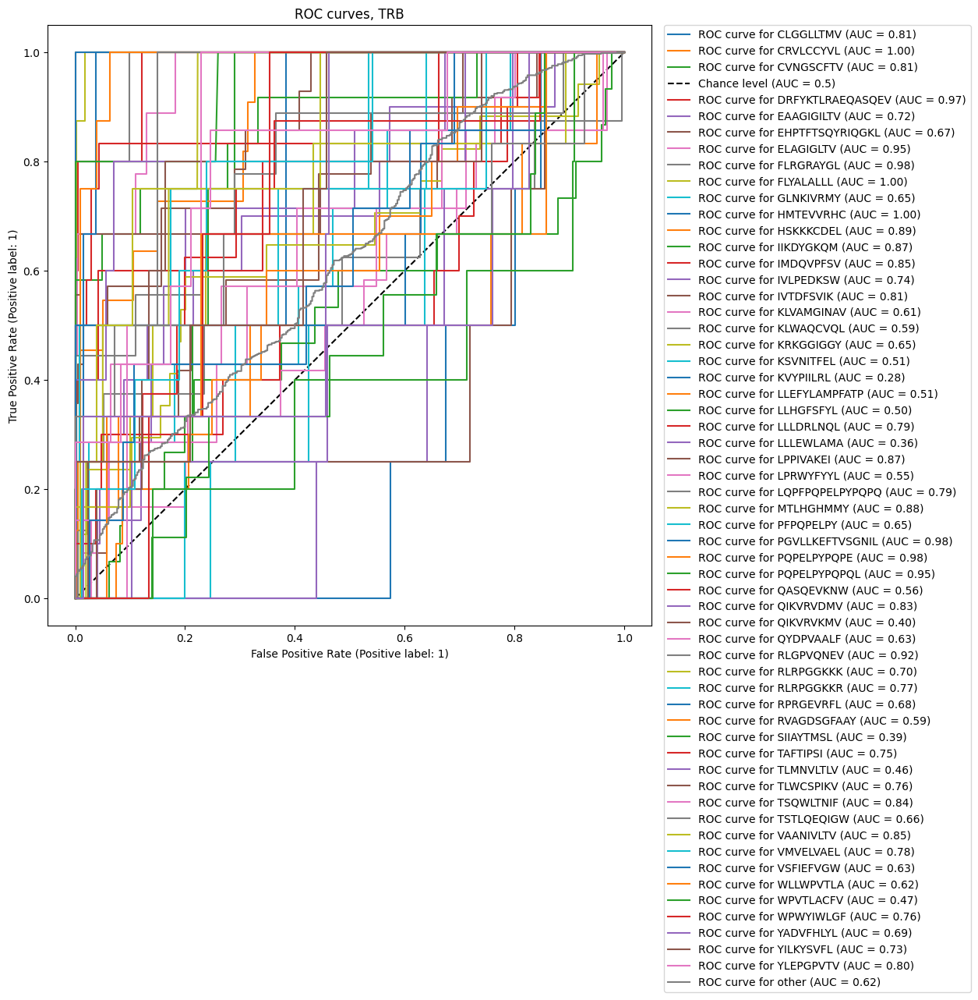

In [137]:
chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='train')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_data = X_data[(X_data['data_type']=='train')&(X_data[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore')


model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(tcremb['annot'][chain][label_filter]=='other')][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,label_filter]])
X_pred = X_pred[(X_pred['data_type']=='test')&(X_pred[label_filter]=='other')].drop(['data_type',label_filter], axis=1, errors = 'ignore').reset_index(drop=True)


print('prediction metrics')
test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
    
#print('prediction using proba metrics')
#pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

#test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']
test_results['clsf'][model_name][chain][label_cl]=y_pred.reset_index(drop=True)

#roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)

    


### Remove clones that are present in train

Text(0.5, 1.0, 'Fraction of barcodes with clonotypes present in VDJdb, 10x donor1')

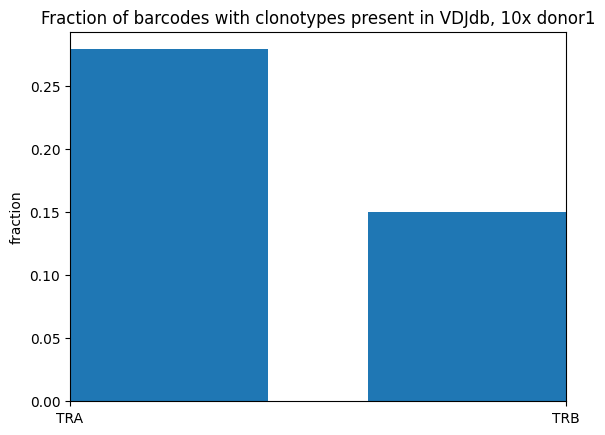

In [197]:
vdjdb_clones_fraction = {}
chain = 'TRA'
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())
t_test = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test']
t = t_test[t_test[clonotype_id_column].isin(train_clonotypes_ids)]
vdjdb_clones_fraction[chain] = len(t)/len(t_test)

chain = 'TRB'
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())
t_test = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='test']
t = t_test[t_test[clonotype_id_column].isin(train_clonotypes_ids)]
vdjdb_clones_fraction[chain] = len(t)/len(t_test)


fig, ax = plt.subplots()
ax.bar(list(vdjdb_clones_fraction.keys()),list(vdjdb_clones_fraction.values()))
ax.set_xlim([0, 1])
ax.set_ylabel('fraction')
ax.set_title(f'Fraction of barcodes with clonotypes present in VDJdb, 10x {donor}')

In [117]:
label_cl = 'antigen.epitope_high_count_50'
model_name = 'RF_proba_' + label_cl + '_filtered_clones'
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9768545994065282
Test accuracy: 0.3727499307671005
good prediction: 49 classes with roc auc >= 0.6
failed: 11 classes with roc auc < 0.6
macro: {'f1': 0.03212284171236257, 'precision': 0.04063876785591976, 'recall': 0.03645693571848745}
weighted: {'f1': 0.37220960625638916, 'precision': 0.4385207677497889, 'recall': 0.4606696651674163}
accuracy: 0.4606696651674163
macro: {'f1': 0.07799567446878918, 'precision': 0.07487715760934217, 'recall': 0.10274820395391832}
weighted: {'f1': 0.8797575280633417, 'precision': 0.9674737376668632, 'recall': 0.8203898050974513}
accuracy: 0.8203898050974513
good prediction: 6 classes with roc auc >= 0.6
failed: 54 classes with roc auc < 0.6


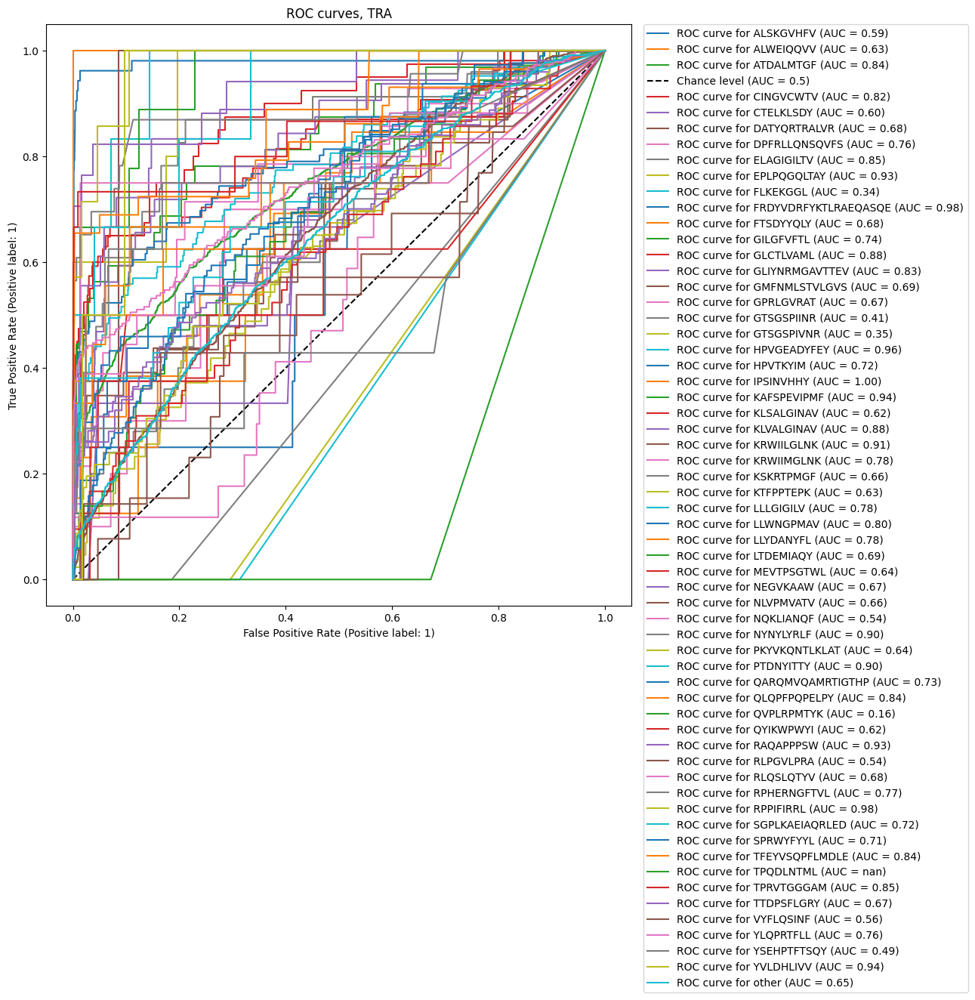

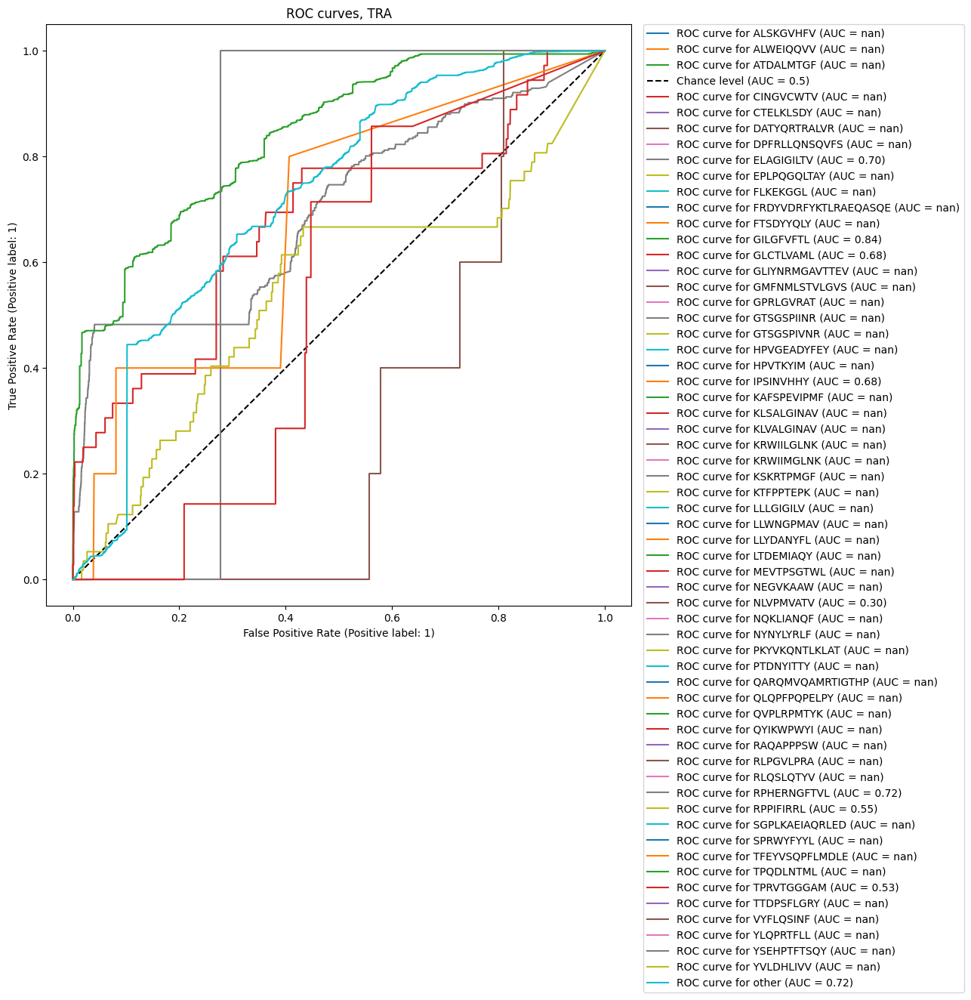

In [118]:


chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())

model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(-tcremb['annot'][chain][clonotype_id_column].isin(train_clonotypes_ids))][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,clonotype_id_column]])
X_pred = X_pred[(X_pred['data_type']=='test')&(-X_pred[clonotype_id_column].isin(train_clonotypes_ids))].drop(['data_type',clonotype_id_column], axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)



Train accuracy: 0.9818806252960682
Test accuracy: 0.34245061472579086
good prediction: 72 classes with roc auc >= 0.6
failed: 9 classes with roc auc < 0.6
macro: {'f1': 0.06693070105686891, 'precision': 0.09136885700054212, 'recall': 0.07650138563082609}
weighted: {'f1': 0.5435666088189083, 'precision': 0.7132048531855503, 'recall': 0.6315517113920307}
accuracy: 0.6315517113920307
macro: {'f1': 0.13233408539160987, 'precision': 0.12089371257113567, 'recall': 0.22316889174313437}
weighted: {'f1': 0.9164381584955158, 'precision': 0.9730816302401232, 'recall': 0.8720337103570637}
accuracy: 0.8720337103570637
good prediction: 5 classes with roc auc >= 0.6
failed: 76 classes with roc auc < 0.6


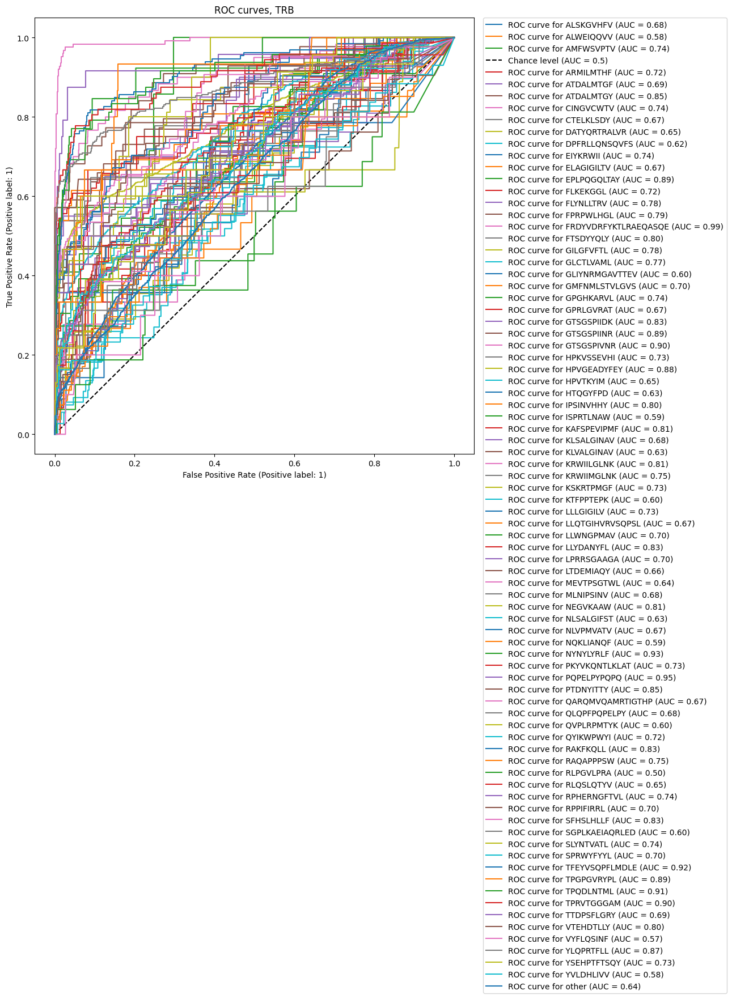

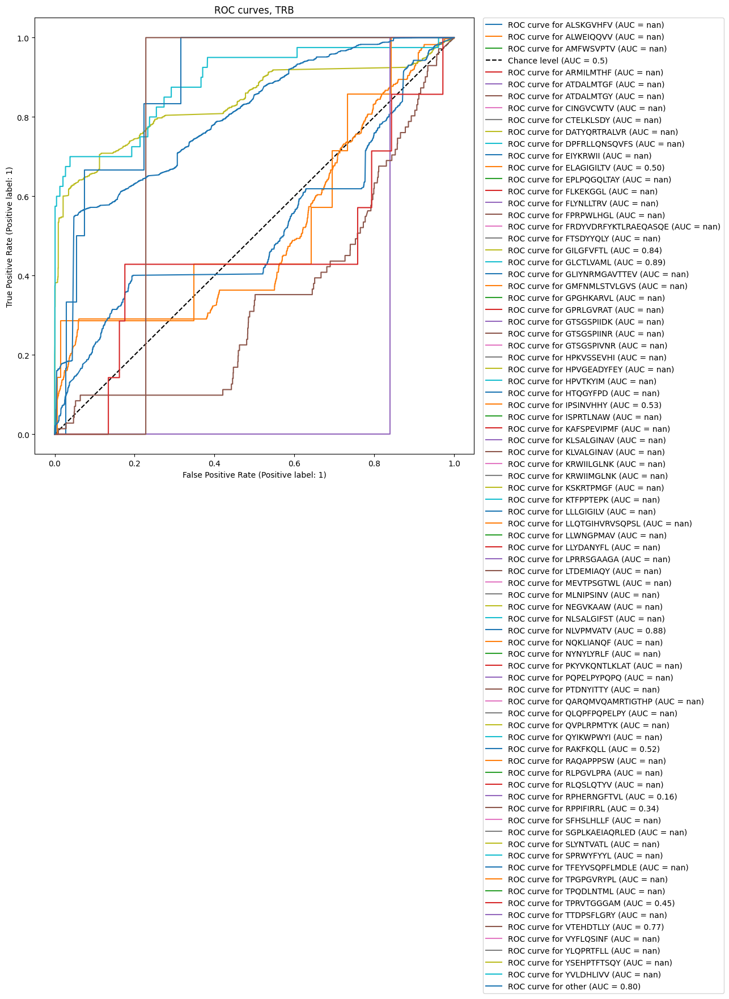

In [119]:


chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())

model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(-tcremb['annot'][chain][clonotype_id_column].isin(train_clonotypes_ids))][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,clonotype_id_column]])
X_pred = X_pred[(X_pred['data_type']=='test')&(-X_pred[clonotype_id_column].isin(train_clonotypes_ids))].drop(['data_type',clonotype_id_column], axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)



In [176]:
label_cl = 'antigen.epitope_high_count_50'
model_name = 'RF_proba_' + label_cl + '_filtered_clones'
clsf_dict[model_name]= {'model':{},'roc_auc':{}}
test_results['clsf'][model_name] = {}

Train accuracy: 0.9787537091988131
Test accuracy: 0.35502630850180006
good prediction: 46 classes with roc auc >= 0.6
failed: 15 classes with roc auc < 0.6
macro: {'f1': 0.03175352637017396, 'precision': 0.038667260533201187, 'recall': 0.06281479014841995}
weighted: {'f1': 0.35841924048140883, 'precision': 0.4092516220511195, 'recall': 0.4574712643678161}
accuracy: 0.4574712643678161
macro: {'f1': 0.0856172706149246, 'precision': 0.08083910411520212, 'recall': 0.17083946396452485}
weighted: {'f1': 0.8792097177126916, 'precision': 0.9672849219462256, 'recall': 0.8194902548725638}
accuracy: 0.8194902548725638
good prediction: 5 classes with roc auc >= 0.6
failed: 56 classes with roc auc < 0.6


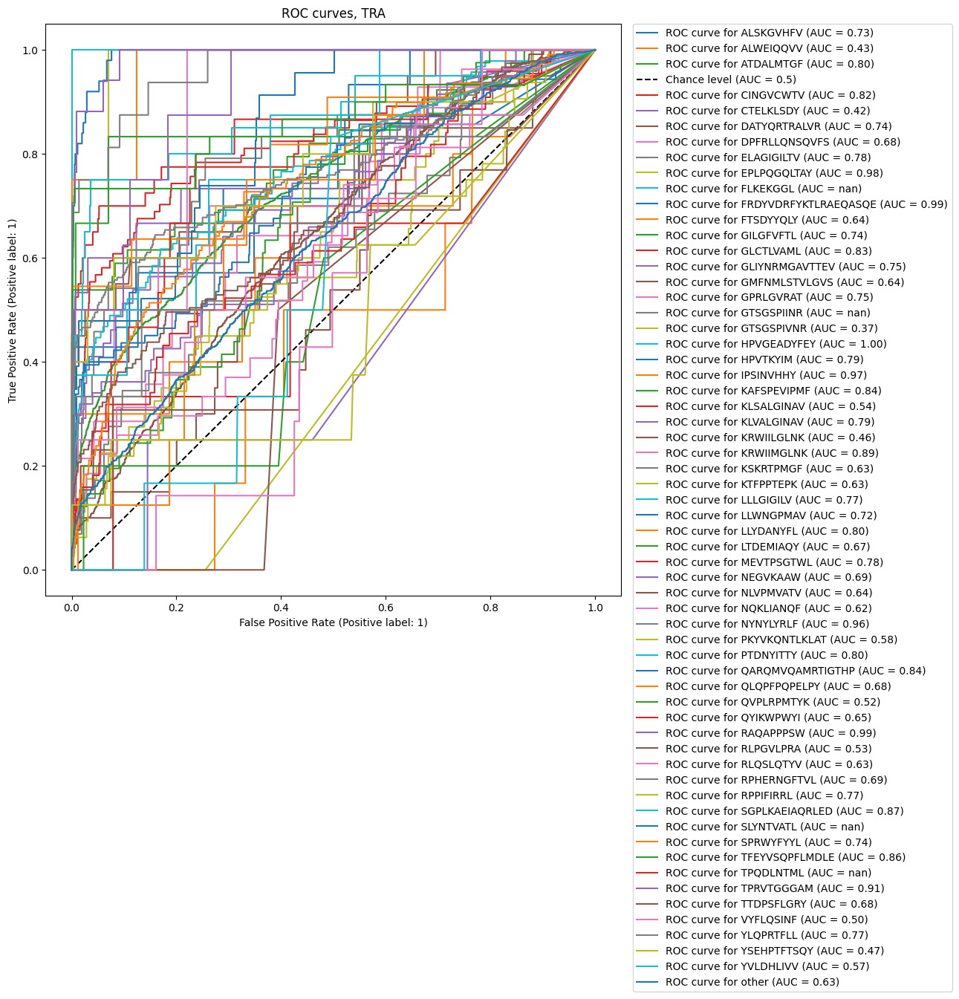

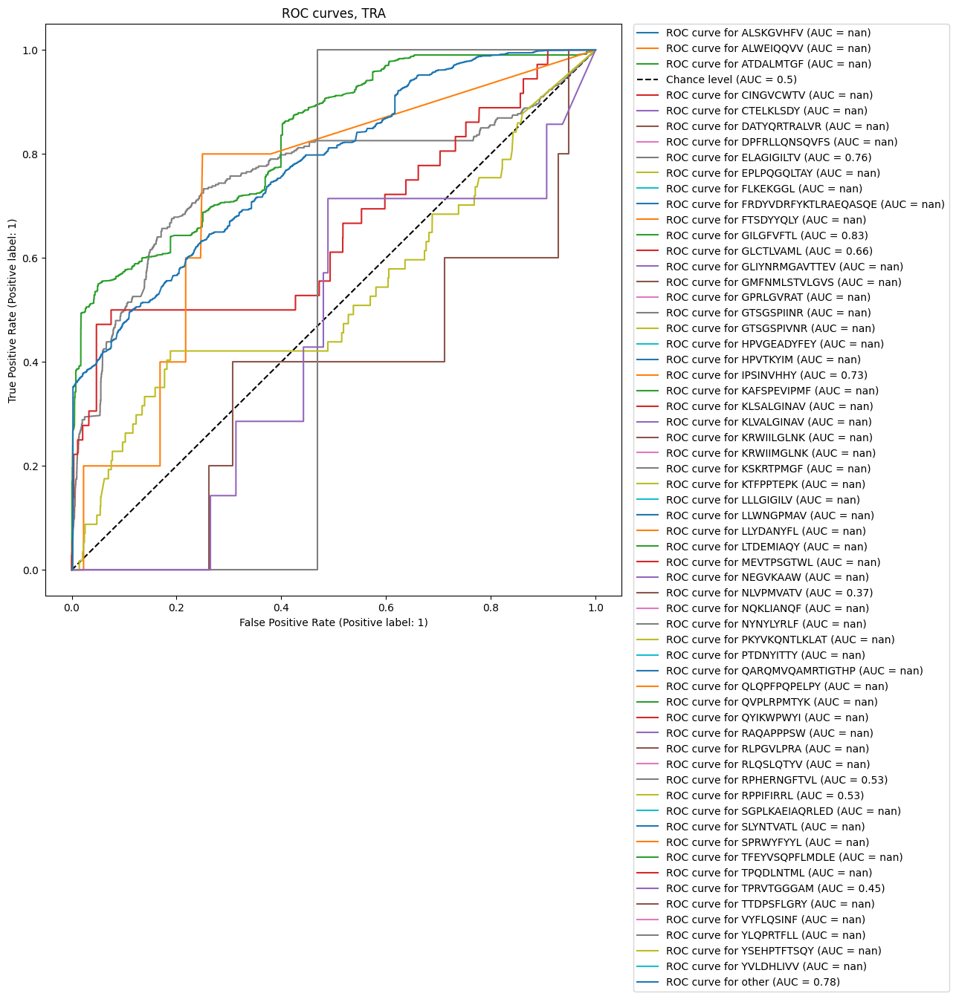

In [177]:


chain = 'TRA'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())

model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(-tcremb['annot'][chain][clonotype_id_column].isin(train_clonotypes_ids))][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,clonotype_id_column]])
X_pred = X_pred[(X_pred['data_type']=='test')&(-X_pred[clonotype_id_column].isin(train_clonotypes_ids))].drop(['data_type',clonotype_id_column], axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)



Train accuracy: 0.9814069161534817
Test accuracy: 0.3472855366763365
good prediction: 73 classes with roc auc >= 0.6
failed: 8 classes with roc auc < 0.6
macro: {'f1': 0.06195345132655214, 'precision': 0.08223895197362135, 'recall': 0.09911925625070463}
weighted: {'f1': 0.5356442586589439, 'precision': 0.7177232172873749, 'recall': 0.6307385229540918}
accuracy: 0.6307385229540918
macro: {'f1': 0.1366835250598001, 'precision': 0.11912464951709015, 'recall': 0.21734490474252643}
weighted: {'f1': 0.9209506554202471, 'precision': 0.9820680728290732, 'recall': 0.8752125378871886}
accuracy: 0.8752125378871886
good prediction: 7 classes with roc auc >= 0.6
failed: 74 classes with roc auc < 0.6


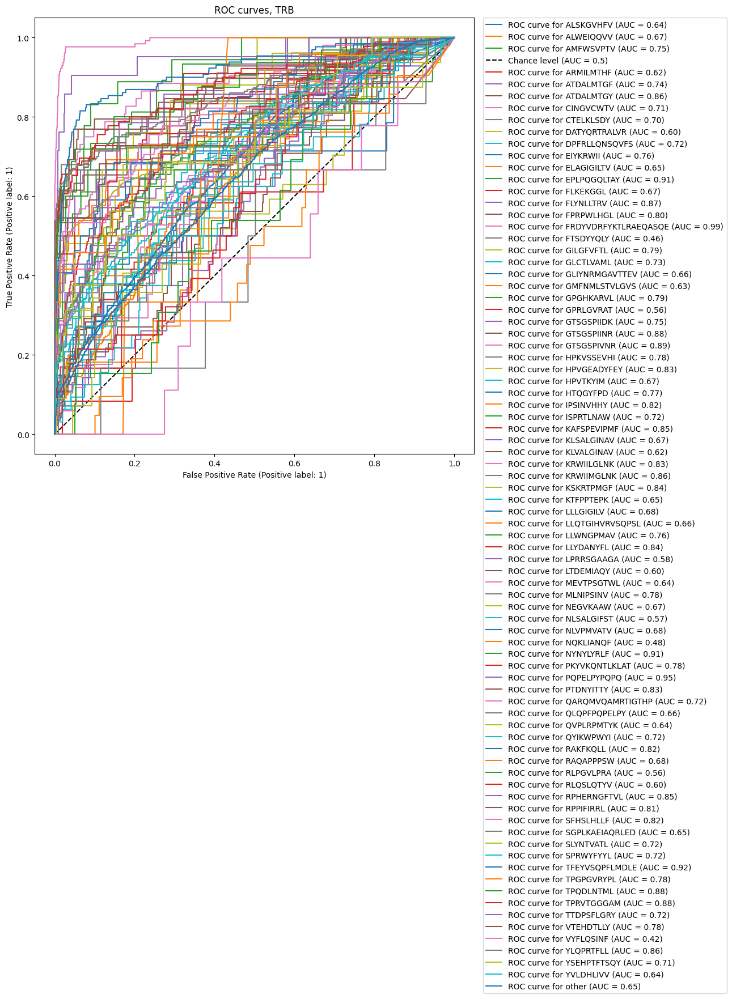

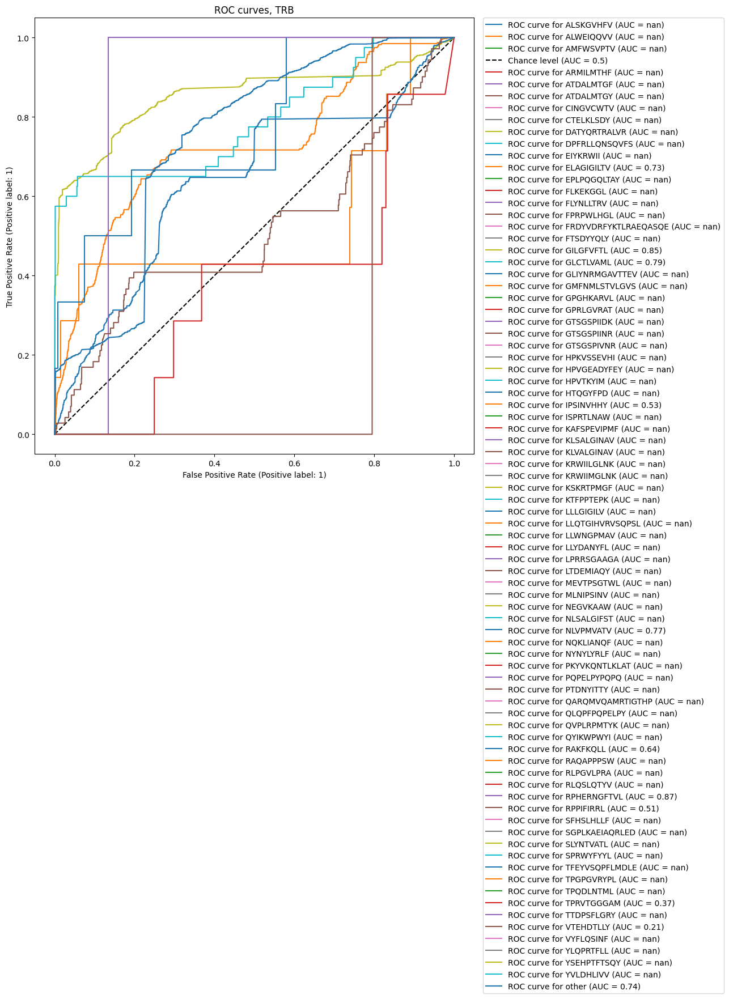

In [178]:


chain = 'TRB'
max_depth = 20


y_data = tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][label_cl]
X_data = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id]])
X_data = X_data[X_data['data_type']=='train'].drop('data_type', axis=1, errors = 'ignore')
train_clonotypes_ids = list(tcremb['annot'][chain][tcremb['annot'][chain]['data_type']=='train'][clonotype_id_column].drop_duplicates())

model = RandomForestClassifier(max_depth=max_depth, random_state=0)
clsf_dict[model_name]['model'][chain], clsf_dict[model_name]['roc_auc'][chain] = TCRemb_code2.clf_model(model,y_data, X_data , annotation_id, chain)


y_pred = tcremb['annot'][chain][(tcremb['annot'][chain]['data_type']=='test')&(-tcremb['annot'][chain][clonotype_id_column].isin(train_clonotypes_ids))][label_cl]
X_pred = pd.merge(tcremb['pca'][chain],tcremb['annot'][chain][['data_type',annotation_id,clonotype_id_column]])
X_pred = X_pred[(X_pred['data_type']=='test')&(-X_pred[clonotype_id_column].isin(train_clonotypes_ids))].drop(['data_type',clonotype_id_column], axis=1, errors = 'ignore').reset_index(drop=True)


test_results['clsf'][model_name][chain] = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred)
pred_w_proba = TCRemb_code2.clf_pred_proba(clsf_dict[model_name]['model'][chain], X_pred, annotation_id, y_pred = y_pred)

test_results['clsf'][model_name][chain]['pred_w_proba'] = pred_w_proba['pred']

roc_auc = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], test_results['clsf'][model_name][chain]['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)



In [ ]:
def clf_pred_proba(model, X_pred, annotation_id, t=0.6):
    classes_list = model.classes_
    y_pred_proba = model.predict_proba(X_pred.drop(annotation_id, axis=1, errors = 'ignore'))
    pred_res = []
    for i in range(len(y_pred_proba)):
        if max(y_pred_proba[i])> t:
            pred_res.append(classes_list[np.argmax(y_pred_proba[i])])
        else:
            pred_res.append('other')
    pred = pd.DataFrame(pred_res,columns=['pred'])
    pred[annotation_id] = X_pred[annotation_id]
    return pred

In [82]:
from sklearn.preprocessing import label_binarize
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import RocCurveDisplay

In [ ]:



pred = TCRemb_code2.clf_pred(clsf_dict[model_name]['model'][chain], X_pred, annotation_id)

test_results['clsf'][model_name][chain] = pd.merge(pred,tcremb['annot'][chain],on=annotation_id)
print(f"macro: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'macro')}")
print(f"weighted: {TCRemb_code2.clsf_metrics(test_results['clsf'][model_name][chain]['pred'],test_results['clsf'][model_name][chain][label_cl],'weighted')}")
t = TCRemb_code2.roc_auc(clsf_dict[model_name]['model'][chain], pred['pred'], y_pred, X_pred.drop(annotation_id, axis=1, errors = 'ignore'),chain)
t[-t['roc_auc'].isna()]
